<a href="https://colab.research.google.com/github/rachanrv/STOCK-ANALYSIS-ZOMBIE-STOCK-TEST-AND-PORTFOLIO-MANAGEMENT/blob/master/Final_Code_CloudMobileAppBackend.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# PROJECT NAME: **CLOUD ANALYTICS** 
<image src = 'https://i.pinimg.com/originals/00/4b/17/004b173f6e3d6843df10114e087f30a8.gif' width=""/> 
<image src ='https://thumbs.gfycat.com/UnderstatedReflectingIberianemeraldlizard-max-1mb.gif'>

<image src='https://compliance4all14.files.wordpress.com/2018/06/iot-cover-image.gif'>

# **OBJECTIVE OF THE PROJECT**

Create a backend for a mobile application using Python to do a prediction for public sentiment and Adjusted stock price for different companies for investors.



<image src ='https://www.greenwebmedia.com/mobile-application-uk/images/mobile-app-tab2.gif' width="400"/> <image src ='https://static.wixstatic.com/media/acaaea_106c617a684e404f8472f43ec1f7bbad~mv2.gif' width="400"> 




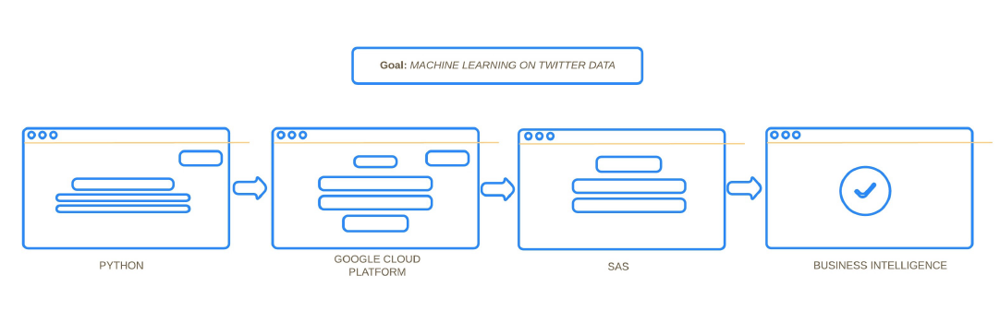

# **1.VOICE RECORDING**

<image src= 'https://static.toiimg.com/photo/msid-70734059/70734059.jpg?resizemode=4&width=400' width="800"/>

<image src = 'https://mk0analyticsindf35n9.kinstacdn.com/wp-content/uploads/2020/04/aim_asr.gif' width="400" /> <image src = 'https://i.pinimg.com/originals/b7/38/92/b738924ad5213c840889bad61fb8e468.gif' width="500"/> 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# all imports
from io import BytesIO
import numpy
from base64 import b64decode
from google.colab import output
from IPython.display import Javascript
import scipy.io.wavfile

In [ ]:
RECORD = """
const sleep  = time => new Promise(resolve => setTimeout(resolve, time))
const b2text = blob => new Promise(resolve => {
  const reader = new FileReader()
  reader.onloadend = e => resolve(e.srcElement.result)
  reader.readAsDataURL(blob)
})
var record = time => new Promise(async resolve => {
  stream = await navigator.mediaDevices.getUserMedia({ audio: true })
  recorder = new MediaRecorder(stream)
  chunks = []
  recorder.ondataavailable = e => chunks.push(e.data)
  recorder.start()
  await sleep(time)
  recorder.onstop = async ()=>{
    blob = new Blob(chunks)
    text = await b2text(blob)
    resolve(text)
  }
  recorder.stop()
})
"""

def record(sec=3):
  print("Speak Now...")
  display(Javascript(RECORD))
  sec += 1
  s = output.eval_js('record(%d)' % (sec*1000))
  print("Done Recording !")
  b = b64decode(s.split(',')[1])
  return b #byte stream

In [ ]:
audio = record(5) 

Speak Now...


<IPython.core.display.Javascript object>

Done Recording !


In [ ]:
import IPython.display as ipd
ipd.display(ipd.Audio(audio))

In [ ]:
#b=bytearray(audio)
#b = numpy.array(b, dtype=numpy.int16)

In [ ]:
#scipy.io.wavfile.write('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/tbd_convert/myfile.wav',16000, b)

In [ ]:
#with open('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/tbd_convert/myfile.mp3', mode='bw',) as f:
    #f.write(audio)

# **2.CONVERSION FROM AUDIO TO TEXT**

## Google Speech to Text API


<image src = 'https://blog.pythian.com/wp-content/uploads/serverless-pipeline-arch.png' width ="600"/>

In [ ]:
!ls /content/drive/'Shared drives'/'OPIM 5671: Data Mining and Business Intelligence'/temp

 tbd_convert  'Twitter Mining-4f82e1a0e137.json'


In [ ]:
import os
os.environ['GOOGLE_APPLICATION_CREDENTIALS']='/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/Twitter Mining-4f82e1a0e137.json'
!echo $GOOGLE_APPLICATION_CREDENTIALS

/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/Twitter Mining-4f82e1a0e137.json


In [ ]:
%pip install pydub
%pip install sox
!apt -qq install -y sox

sox is already the newest version (14.4.2-3ubuntu0.18.04.1).
0 upgraded, 0 newly installed, 0 to remove and 21 not upgraded.


In [ ]:
# STEP 1: Convert .mp3 to .wav file
# STEP 2: Use subprocess + sox to convert .wav file into MONO .wav file, make sure sample_rate_hertz = 44100

import subprocess
import os
from pydub import AudioSegment
# dir
dirname = '/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/tbd_convert/'

In [ ]:
  def convert_audio(filename):
    filenamesplit = os.path.splitext(filename)[0]
    filenamewav = filenamesplit + '.wav'
    print(filenamewav)
    newfilename = "mono_" + filenamewav
    # convert mp3 to wav                                                            
    sound = AudioSegment.from_mp3(dirname + filename)
    sound.export(dirname + filenamewav, format="wav")
    # convert wav to wav mono
    command2 = ['sox',dirname + filenamewav,'-c','1',dirname + newfilename]
    subprocess.Popen(command2)


In [ ]:
  for filename in os.listdir(dirname):
    print(filename)
    print("Starting...")
    convert_audio(filename)
    print("Completed!!")
  

02. Whatever It Takes ~~ [SARIYA_BHAI]™.mp3
Starting...
02. Whatever It Takes ~~ [SARIYA_BHAI]™.wav
Completed!!


## Google Cloud Storage

In [ ]:
# STEP 3: Copies all files from temp/tbd_convert folder into Google Cloud Storage bucket

from google.colab import auth

from google.cloud import storage

auth.authenticate_user()

project_id = 'lustrous-router-290002'
!gcloud config set project {project_id}

!gsutil ls
bucket_name = 'dmp007'
!gsutil -m cp -r '/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/tbd_convert'* gs://{bucket_name}/

Updated property [core/project].
gs://dmp007/
Copying file:///content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/tbd_convert/02. Whatever It Takes ~~ [SARIYA_BHAI]™.mp3 [Content-Type=audio/mpeg]...
Copying file:///content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/tbd_convert/mono_02. Whatever It Takes ~~ [SARIYA_BHAI]™.wav [Content-Type=audio/x-wav]...
Copying file:///content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/tbd_convert/02. Whatever It Takes ~~ [SARIYA_BHAI]™.wav [Content-Type=audio/x-wav]...
\ [3/3 files][ 58.5 MiB/ 58.5 MiB] 100% Done                                    
Operation completed over 3 objects/58.5 MiB.                                     


In [ ]:
%pip install --upgrade google-cloud-storage

Requirement already up-to-date: google-cloud-storage in /usr/local/lib/python3.6/dist-packages (1.31.2)


In [ ]:
# TEST
from google.cloud import storage

project_id = 'lustrous-router-290002'
bucket_name = 'dmp007'

def list_blobs(bucket_name):
  storage_client = storage.Client(project_id)
  blobs = storage_client.list_blobs(bucket_name)
  for blob in blobs:
    print(blob.name+'\n')
  
list_blobs(bucket_name)

tbd_convert/02. Whatever It Takes ~~ [SARIYA_BHAI]™.mp3

tbd_convert/02. Whatever It Takes ~~ [SARIYA_BHAI]™.wav

tbd_convert/mono_02. Whatever It Takes ~~ [SARIYA_BHAI]™.wav



In [ ]:
%pip install --upgrade google-cloud-speech

Requirement already up-to-date: google-cloud-speech in /usr/local/lib/python3.6/dist-packages (2.0.0)


In [ ]:
# STEP 4: Use Google Speech to Text to convert into transcriptions
from  google.cloud import speech_v1    
import google.cloud.speech 
from google.colab import auth
from google.cloud import storage
project_id = 'lustrous-router-290002'
bucket_name = 'dmp007'

In [ ]:
def sample_long_running_recognize(storage_uri):
    """
    Transcribe long audio file from Cloud Storage using asynchronous speech
    recognition
    Args:
      storage_uri URI for audio file in Cloud Storage, e.g. gs://[BUCKET]/[FILE]
    """
    client = speech_v1.SpeechClient()
    # Sample rate in Hertz of the audio data sent
    sample_rate_hertz = 44100
    # The language of the supplied audio
    language_code = "en-US" # Encoding of audio data sent. This sample sets this explicitly.
    # This field is optional for FLAC and WAV audio formats.
    encoding = google.cloud.speech.RecognitionConfig.AudioEncoding.LINEAR16
    config = {
        "sample_rate_hertz": sample_rate_hertz,
        "language_code": language_code,
        "encoding": encoding,
    }
    audio = {"uri": storage_uri}
    operation = client.long_running_recognize(request={"config": config, "audio": audio})
    print(u"Waiting for operation to complete...")
    response = operation.result()
    for result in response.results:
        # First alternative is the most probable result
        alternative = result.alternatives[0]
        print(u"Transcript: {}".format(alternative.transcript))
    

In [ ]:
import os
os.environ["GOOGLE_APPLICATION_CREDENTIALS"]="/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/Twitter Mining-4f82e1a0e137.json"


<image src= 'https://i.ytimg.com/vi/0W3ncXKGM0k/maxresdefault.jpg' width="400"/>

In [ ]:
def blob_bucket_transcribe(bucket_name):
  storage_client = storage.Client(project_id)
  blobs = storage_client.list_blobs(bucket_name)
  storage_prefix = 'gs://' + bucket_name + '/'
  for blob in blobs:
    print(blob.name)
    storage_uri = blob.name
    #sample_long_running_recognize(storage_prefix + storage_uri)
      
storage_uri = 'gs://dmp007/tbd_convert/mono_02. Whatever It Takes ~~ [SARIYA_BHAI]™.wav'
sample_long_running_recognize(storage_uri)
#blob_bucket_transcribe(bucket_name)


Waiting for operation to complete...
Transcript: Solitude bad to prepare tripping in the world could be dangerous bees ever been stuck on negative everybody praying for the end of time going to be hoping they can be tomorrow night
Transcript:  homemade Taqueria
Transcript:  games dude never be enough on the public without my phone.
Transcript:  drag me down
Transcript:  framesdirect.com to be the parenthetical out of the box in the Box
Transcript:  attitude
Transcript:  best beach near the Masterpiece Theater on have two seats do in Miami Season 2 please. Go down to grab a beer bottle
Transcript:  do it today
Transcript:  do returns


In [ ]:
def explicit():
    from google.cloud import storage

    # Explicitly use service account credentials by specifying the private key
    # file.
    storage_client = storage.Client.from_service_account_json(
        '/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/Twitter Mining-4f82e1a0e137.json')

    # Make an authenticated API request
    buckets = list(storage_client.list_buckets())
    print(buckets)

In [ ]:
explicit()

[<Bucket: dmp007>]


In [ ]:
def transcribe_file(speech_file):
    """Transcribe the given audio file."""
    from google.cloud import speech
    import io

    client = speech.SpeechClient()

    with io.open(speech_file, "rb") as audio_file:
        content = audio_file.read()

    audio = speech.RecognitionAudio(content=content)
    config = speech.RecognitionConfig(
        encoding=speech.RecognitionConfig.AudioEncoding.LINEAR16,
        sample_rate_hertz=44100,
        language_code="en-US",
    )

    response = client.recognize(request={"config": config, "audio": audio})
    # Each result is for a consecutive portion of the audio. Iterate through
    # them to get the transcripts for the entire audio file.
    for result in response.results:
        # The first alternative is the most likely one for this portion.
        print(u"Transcript: {}".format(result.alternatives[0].transcript))
    return response.results



In [ ]:
#r=transcribe_file('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/temp/tbd_convert/mono_02. Whatever It Takes ~~ [SARIYA_BHAI]™.wav')

In [ ]:
#for result in r:
        # The first alternative is the most likely one for this portion.
        #print(u"Transcript: {}".format(result.alternatives[0].transcript))

In [ ]:
#r

# **3.GOOGLE SEARCH SUGGESTIONS**

<image src ='https://i.imgur.com/mWdPz9r.gif'>

In [ ]:
word='IBM'
U="http://suggestqueries.google.com/complete/search?client=firefox&q="
URL=U+word

In [ ]:
    import requests, json 
    import pandas as pd
    headers = {'User-agent':'Mozilla/5.0'} 
    response = requests.get(URL, headers=headers) 
    result = json.loads(response.content.decode('utf-8')) 
    result= pd.DataFrame(result[1])
    print(result) 

                       0
0                    ibm
1              ibm stock
2        ibm stock price
3            ibm careers
4             ibm watson
5              ibm cloud
6               ibm jobs
7  ibm stock price today
8               ibm logo
9                ibm ceo


In [ ]:
word='MSFT'
U="http://suggestqueries.google.com/complete/search?client=firefox&q="
URL=U+word

In [ ]:
    import requests, json 
    import pandas as pd
    headers = {'User-agent':'Mozilla/5.0'} 
    response = requests.get(URL, headers=headers) 
    result = json.loads(response.content.decode('utf-8')) 
    result= pd.DataFrame(result[1])
    print(result) 

                        0
0              msft stock
1          msft premarket
2  msft stock price today
3        msft after hours
4      msft earnings date
5           msft dividend
6     msft stock forecast
7             msft ticker
8                msftsrep
9               msft news


# **4.TWITTER TWEETS EXTRACTION**

<image src ='https://static.wixstatic.com/media/f5e5e5_11076a96f3cc4153b8258d07e29e616c~mv2.gif' width="400"/>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%pip install tweepy

In [ ]:
import json
import csv
import tweepy
import re

In [ ]:
consumer_key= input('Consumer_key=')
consumer_secret= input('Consumer_secret=')

In [ ]:
access_token=input('Access_token=')
access_token_secret=input('Access_token_secret=')

In [ ]:
"""
INPUTS:
    consumer_key, consumer_secret, access_token, access_token_secret: codes 
    telling twitter that we are authorized to access this data
    hashtag_phrase: the combination of hashtags to search for
OUTPUTS:
    none, simply save the tweet info to a spreadsheet
"""
def search_for_hashtags(consumer_key, consumer_secret, access_token, access_token_secret, hashtag_phrase):
    
    #create authentication for accessing Twitter
    auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
    auth.set_access_token(access_token, access_token_secret)

    #initialize Tweepy API
    api = tweepy.API(auth)
    

    #open the spreadsheet we will write to
    with open('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/'+hashtag_phrase+'.csv' , 'w') as file:

        w = csv.writer(file)

        #write header row to spreadsheet
        w.writerow(['timestamp', 'tweet_text', 'username', 'all_hashtags', 'followers_count'])

        #for each tweet matching our hashtags, write relevant info to the spreadsheet
        for tweet in tweepy.Cursor(api.search, q=hashtag_phrase+' -filter:retweets', \
                                   lang="en", tweet_mode='extended').items(1000):
                      w.writerow([tweet.created_at, tweet.full_text.replace('\n',' ').encode('utf-8'), 
                                  tweet.user.screen_name.encode('utf-8'), [e['text']for e in tweet._json['entities']['hashtags']], tweet.user.followers_count])

In [ ]:
for i in result[0]:
  hashtag_phrase = i
  if __name__ == '__main__':
    search_for_hashtags(consumer_key, consumer_secret, access_token, access_token_secret, hashtag_phrase)

In [ ]:
!ls '/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/'

'ibm careers.csv'  'ibm earnings.csv'  'ibm stock price.csv'
 ibm.csv	   'ibm stock.csv'     'ibm watson.csv'


In [ ]:
tmp1=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/ibm careers.csv')
tmp2=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/ibm earnings.csv')
tmp3=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/ibm stock price.csv')
tmp4=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/ibm watson.csv')
tmp5=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/ibm stock.csv' )	
tmp6=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/ibm.csv')


In [ ]:
data=pd.DataFrame(tmp1)
data=data.append(tmp2)
data=data.append(tmp3)
data=data.append(tmp4)
data=data.append(tmp5)
data=data.append(tmp6)

In [ ]:
data.to_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/IBM.csv')

# **5.  TWEETS EXPLORATORY DATA ANALYSIS**

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
!ls -al drive/Shared\ drives/OPIM\ 5671*/Python/IBM/

total 1477
-rw------- 1 root root    151 Oct 31 23:12 'IBM (1).gsheet'
-rw------- 1 root root 592033 Oct 20 02:06  IBM.csv
-rw------- 1 root root    151 Nov 12 01:46  IBM.gsheet
-rw------- 1 root root 606282 Nov  1 05:51 'IBM - IBM.csv'
-rw------- 1 root root    151 Nov  2 21:42 'IBM - IBM.gsheet'
-rw------- 1 root root 311304 Oct 24 09:27  IBM.xlsx


In [ ]:
df1=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/IBM.csv')
df2=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/MSFT/MSFT.csv')

In [ ]:
df1

,Unnamed: 0,timestamp,tweet_text,username,all_hashtags,followers_count
0,0,2020-10-19 19:11:11,b'@IBMResearch Propagates #QuantumComputing Ca...,b'pritampritu',"['QuantumComputing', 'qubits', 'QEP', 'ibmrese...",39
1,1,2020-10-18 09:30:02,b'How My Non-Traditional Path Led Me to a Care...,b'MrBarryBrown',[],6709
2,2,2020-10-17 23:05:45,b'Hispanic Star and IBM Help High School Stude...,b'gibenetti_',[],29
3,3,2020-10-16 19:00:38,b'@TheHispanicStar and @IBM Help High School S...,b'TecHRSeries',"['TecHRSeries', 'Technology', 'HRTech', 'Human...",504
4,4,2020-10-16 16:36:58,b'The Hispanic Star will focus on increasing t...,b'PeterJMcLaren',[],1818
...,...,...,...,...,...,...
2548,995,2020-10-19 19:02:56,"b'Alerts,Analysis https://t.co/cF1P2CnUXj \x...",b'ProfitUpdate',[],387
2549,996,2020-10-19 19:02:35,b'$IBM new alert at https://t.co/A7qrDarJHY ...,b'mediasentiment',"['stocks', 'daytrading', 'NYSE', 'NASDAQ', 'ma...",6513
2550,997,2020-10-19 19:02:07,b'IBM z/OS Container Extensions (zCX) Use Case...,b'NicoletteMcF',[],1244
2551,998,2020-10-19 19:01:51,"b""IBM's floating space robot just got an emoti...",b'311Institute',"['Future', 'Futures', 'Futurism', 'FutureTrend...",39116


In [ ]:
df2

,Unnamed: 0,timestamp,tweet_text,username,all_hashtags,followers_count
0,0,2020-10-18 07:30:47,b'Earnings for the FAAMNG stocks and TSLA - 50...,b'ThinkTankCharts',[],20938
1,1,2020-10-13 21:12:37,b'\xf0\x9f\x9a\xa8 Earnings Alert \xf0\x9f\x9a...,b'wealthdividend',[],860
2,2,2020-10-13 20:29:32,b'$MSFT Microsoft announces quarterly earnings...,b'otcdynamics',[],4701
3,3,2020-10-13 20:07:21,b'$MSFT - Microsoft announces quarterly earnin...,b'ChrisGEllis',[],568
4,4,2020-10-13 20:07:21,b'$MSFT - Microsoft announces quarterly earnin...,b'fulledac',[],2
...,...,...,...,...,...,...
1631,19,2020-10-14 20:01:06,"b'LOOK AT JISOO\xe2\x80\x99S NECKLACE, SHE\xe2...",b'yifansopal',[],1268
1632,20,2020-10-14 11:50:53,b'It\xe2\x80\x99s funny how every time I decid...,b'MSFTSRep_be',[],381
1633,21,2020-10-14 10:53:39,b'REALEST story ever\xe2\x9d\x93\xe2\x80\xbc\x...,b'iamvaljones',"['thevisualizer', 'thearchitect', 'soulmateshi...",1129
1634,22,2020-10-14 06:44:53,b'i was wearing msftsrep and she was in in som...,b'BUFFYTHRAX',[],209


## Foreign language and relevant word search

In [ ]:
t1=df1['tweet_text']
t2=df2['tweet_text']

In [ ]:
for i in range(len(t1)):
  t1[i]=t1[i].replace("b'"," ")
  t1[i]=t1[i].replace("'"," ")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
for i in range(len(t2)):
  t2[i]=t2[i].replace("b'"," ")
  t2[i]=t2[i].replace("'"," ")


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
import nltk
nltk.download('punkt')
nltk.download('words')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package words to /root/nltk_data...
[nltk_data]   Package words is already up-to-date!


True

In [ ]:
for i in range(len(t1)):
  t1[i]=nltk.word_tokenize(t1[i])
  

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
for i in range(len(t2)):
  t2[i]=nltk.word_tokenize(t2[i])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


### Meaningful English Words Dictionary

In [ ]:
words = set(nltk.corpus.words.words())

In [ ]:
words

{'moderantism',
 'nonequilibrium',
 'bow',
 'predisruption',
 'bathymetric',
 'turbinotome',
 'accessorius',
 'floridity',
 'fictive',
 'ungraven',
 'alumiferous',
 'limonite',
 'Lemnaceae',
 'proportionalism',
 'commencement',
 'separatum',
 'unlineal',
 'calcioscheelite',
 'hypericism',
 'trehala',
 'afterbrain',
 'louster',
 'nosewise',
 'unreconcilableness',
 'electrogild',
 'exchanger',
 'gasterosteid',
 'hemicarp',
 'adscriptive',
 'potently',
 'triunal',
 'saleswoman',
 'aldermanity',
 'alysson',
 'anorchus',
 'morals',
 'superendow',
 'whitelike',
 'intensify',
 'talent',
 'Synodus',
 'solubility',
 'pentandrian',
 'semirhythm',
 'Erinize',
 'Achitophel',
 'rectangled',
 'lowland',
 'hedrocele',
 'neurofibril',
 'obtrusionist',
 'tripleness',
 'unciform',
 'unmediumistic',
 'voluminal',
 'Johnsonese',
 'unpreened',
 'amphore',
 'drawloom',
 'extolment',
 'glisky',
 'neckcloth',
 'anatomization',
 'atmologist',
 'Noahic',
 'rixy',
 'Koitapu',
 'preformationist',
 'unsuffused',
 

In [ ]:
t1d=[]
for i in range(len(t1)):
  a=True
  for w in t1[i]:
    if  w.lower()==words or w.isalpha()==True:
      a=False
      break
    if a== True:
      print(i,w,',')
      t1d.append(i)      

0 @ ,
3 @ ,
11 \xf0\x9f\x97\xa3\xef\xb8\x8f ,
15 Heads-up ,
15 , ,
15 # ,
16 # ,
18 . ,
18 @ ,
20 # ,
23 # ,
25 . ,
25 @ ,
42 @ ,
43 # ,
47 : ,
54 $ ,
55 $ ,
59 : ,
62 @ ,
63 # ,
64 $ ,
65 @ ,
66 @ ,
77 **From ,
78 \xe2\x96\xb6\xef\xb8\x8e ,
85 *IBM ,
85 Q3 ,
86 \xf0\x9f\x93\x85 ,
86 $ ,
88 $ ,
95 \xe2\x96\xb6\xef\xb8\x8e ,
97 IBM\xe2\x80\x99s ,
97 3rd ,
98 ( ,
98 2 ,
98 ) ,
100 # ,
100 sp500 ,
100 # ,
101 $ ,
102 $ ,
104 $ ,
108 ( ,
108 After-Hours ,
108 ) ,
109 $ ,
110 $ ,
111 @ ,
113 @ ,
114 @ ,
117 : ,
118 : ,
124 @ ,
125 $ ,
126 @ ,
126 fox5sandiego ,
127 # ,
128 @ ,
129 @ ,
131 Q3 ,
131 # ,
136 $ ,
140 $ ,
141 $ ,
142 $ ,
143 $ ,
146 # ,
148 \xe2\x9c\x85Upcoming ,
148 Earnings\xe2\x9c\x85 ,
149 *IBM ,
152 $ ,
154 $ ,
159 $ ,
165 $ ,
166 $ ,
169 $ ,
170 $ ,
171 # ,
171 $ ,
172 @ ,
173 @ ,
174 @ ,
177 @ ,
178 @ ,
179 @ ,
180 $ ,
182 $ ,
184 $ ,
185 $ ,
186 $ ,
189 $ ,
194 $ ,
197 $ ,
200 $ ,
208 Don\xe2\x80\x99t ,
210 $ ,
212 $ ,
213 # ,
225 $ ,
228 $ ,
229 $ ,
230 $ ,
233 $ ,
242 

In [ ]:
t2d=[]
for i in range(len(t2)):
  a=True
  for w in t2[i]:
    if  w.lower()== words or w.isalpha()== True:
      a=False
    if a== True:
      print(i,w,',')
      t2d.append(i)

1 \xf0\x9f\x9a\xa8 ,
2 $ ,
3 $ ,
4 $ ,
5 $ ,
6 $ ,
7 $ ,
16 $ ,
25 I\ ,
33 $ ,
35 \xf0\x9f\x93\x8cDiscord ,
37 # ,
43 $ ,
46 $ ,
48 $ ,
49 $ ,
50 $ ,
51 $ ,
55 # ,
64 $ ,
66 $ ,
70 # ,
72 # ,
73 $ ,
74 $ ,
75 $ ,
77 $ ,
78 # ,
90 $ ,
93 $ ,
102 # ,
103 $ ,
104 $ ,
105 @ ,
106 # ,
108 # ,
109 $ ,
110 $ ,
112 $ ,
117 $ ,
121 $ ,
126 $ ,
127 @ ,
136 $ ,
140 $ ,
143 $ ,
146 \xf0\x9f\x93\x8cDiscord ,
158 \xf0\x9f\x93\x8cDiscord ,
160 $ ,
161 $ ,
165 \xf0\x9f\x93\x8cDiscord ,
171 $ ,
172 $ ,
173 $ ,
176 $ ,
183 $ ,
187 $ ,
193 $ ,
196 $ ,
200 $ ,
201 4 ,
204 $ ,
208 $ ,
211 $ ,
219 @ ,
221 @ ,
223 \xf0\x9f\x93\x8cDiscord ,
223 : ,
226 \xf0\x9f\x93\x8cDiscord ,
231 Stock-market ,
252 $ ,
253 \xe2\x9a\xbd\xef\xb8\x8f ,
254 $ ,
256 $ ,
259 $ ,
260 $ ,
262 $ ,
264 $ ,
267 9 ,
270 \xf0\x9f\x93\x8cDiscord ,
270 : ,
272 $ ,
275 \xf0\x9f\x93\x8cDiscord ,
276 21,900 ,
281 $ ,
283 $ ,
284 $ ,
285 $ ,
287 $ ,
292 @ ,
292 PointsNorth_Cap ,
292 @ ,
292 sunny051488 ,
292 @ ,
300 # ,
302 @ ,
303 # ,
304 $ 

In [ ]:
for i in range(len(t1)):
  for w in t1[i]:
    a=w.find('IBM')
    if a>-1:
      print(i)
    break

7
10
12
28
33
35
38
40
44
46
49
52
53
57
58
60
61
70
76
79
80
83
85
89
90
91
93
96
97
99
103
105
106
107
115
116
119
120
122
123
130
132
137
138
139
144
145
149
150
151
153
155
157
158
162
163
167
175
181
192
201
204
206
211
254
265
279
283
290
291
305
318
410
439
467
468
469
471
475
476
484
499
506
510
516
521
522
523
526
527
534
545
548
555
556
560
568
586
592
593
658
659
796
797
798
799
826
828
830
843
850
861
866
903
946
950
952
967
970
976
989
1006
1009
1014
1044
1063
1064
1073
1084
1086
1091
1095
1098
1111
1119
1143
1145
1148
1163
1174
1189
1196
1202
1206
1207
1208
1209
1216
1217
1218
1219
1225
1258
1261
1268
1274
1278
1281
1288
1289
1303
1309
1314
1318
1329
1332
1335
1344
1351
1355
1356
1358
1359
1360
1364
1382
1402
1423
1437
1517
1548
1551
1552
1555
1562
1563
1571
1573
1582
1594
1605
1612
1614
1622
1624
1627
1636
1638
1640
1641
1643
1646
1647
1657
1662
1667
1677
1681
1688
1691
1694
1704
1705
1708
1717
1719
1723
1731
1743
1748
1749
1752
1756
1759
1760
1764
1767
1769
1789
1792
18

In [ ]:
for i in range(len(t2)):
  for w in t2[i]:
    a=w.find('Microsoft')
    if a>-1:
      print(i)
    break

32
278
313
685
783
888
955
964
986
989
1090
1108
1132
1139
1222
1225
1230
1253
1285
1309
1321
1329
1330
1337
1375
1384
1478
1481
1482
1529
1559
1604


In [ ]:
for i in range(len(t1)):
  for w in t1[i]:
    a=w.find(r'$')
    if a>-1:
      print(i)
    break

54
55
64
88
101
102
104
109
110
125
136
140
141
142
143
152
154
159
165
166
169
170
180
182
184
185
186
189
194
197
200
210
212
225
228
229
230
233
242
258
260
262
264
269
274
278
324
325
326
327
328
329
330
331
332
333
341
346
349
355
356
359
362
383
387
390
391
396
404
406
408
416
419
435
444
464
470
472
477
478
481
482
487
490
1190
1304
1306
1315
1317
1325
1345
1346
1361
1365
1368
1370
1372
1373
1380
1381
1388
1396
1399
1406
1411
1417
1431
1433
1458
1464
1465
1468
1471
1483
1487
1488
1489
1491
1502
1503
1507
1509
1512
1514
1515
1523
1525
1526
1527
1534
1545
1550
1554
1567
1575
1581
1585
1595
1631
1634
1665
1684
1701
1796
1802
1804
1829
1833
1839
1845
1850
1852
1865
1883
1889
1895
1909
1916
1917
1936
1939
1944
1949
1952
1956
1960
2007
2031
2035
2069
2085
2099
2106
2127
2148
2152
2163
2165
2172
2178
2188
2190
2215
2217
2235
2242
2243
2245
2255
2259
2269
2281
2282
2286
2287
2288
2289
2290
2291
2292
2307
2312
2314
2316
2317
2326
2330
2331
2335
2337
2340
2344
2345
2347
2350
2353
2355
235

In [ ]:
for i in range(len(t2)):
  for w in t2[i]:
    a=w.find(r'$')
    if a>-1:
      print(i)
    break

2
3
4
5
6
7
16
33
43
46
48
49
50
51
64
66
73
74
75
77
90
93
103
104
109
110
112
117
121
126
136
140
143
160
161
171
172
173
176
183
187
193
196
200
204
208
211
252
254
256
259
260
262
264
272
281
283
284
285
287
304
315
316
320
322
325
326
329
330
331
336
351
355
356
357
359
362
364
368
369
376
379
384
385
390
393
430
441
445
446
450
461
472
473
477
478
479
481
482
483
488
490
494
495
502
508
509
510
516
519
521
527
538
568
573
583
594
600
601
605
607
609
612
615
624
625
631
635
637
638
642
647
655
662
671
672
673
674
677
694
695
696
699
719
720
722
724
726
727
728
729
739
740
746
750
759
763
769
770
774
785
797
799
813
820
825
829
834
842
850
859
864
865
866
874
875
880
883
885
890
892
896
901
905
907
920
922
924
925
926
930
939
940
942
943
944
945
946
947
948
952
954
959
960
961
962
965
966
971
972
973
977
982
987
990
991
992
993
995
997
1006
1007
1008
1012
1013
1015
1021
1025
1032
1041
1057
1066
1069
1071
1072
1073
1080
1082
1096
1097
1100
1101
1102
1111
1112
1113
1117
1122
1123
113

In [ ]:
tmp1=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/IBM/IBM - IBM.csv')
tmp2=pd.read_csv('/content/drive/Shared drives/OPIM 5671: Data Mining and Business Intelligence/Python/MSFT/MSFT - MSFT.csv')

In [ ]:
len(tmp1) #total number of tweets of IBM

2553

In [ ]:
len(tmp2) #total number of tweets of MSFT

1636

## Remove b' and ' for the tweets

In [ ]:
for i in range(len(tmp1)):
  tmp1.loc[i,'tweet_text']=tmp1.loc[i,'tweet_text'].replace("b'"," ")
  tmp1.loc[i,'tweet_text']=tmp1.loc[i,'tweet_text'].replace("'"," ")

In [ ]:
for i in range(len(tmp2)):
  tmp2.loc[i,'tweet_text']=tmp2.loc[i,'tweet_text'].replace("b'"," ")
  tmp2.loc[i,'tweet_text']=tmp2.loc[i,'tweet_text'].replace("'"," ")

## Remove links out of tweets

In [ ]:
import re
def remove_urls (vTEXT):
    vTEXT = re.sub(r'(https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b', '', vTEXT, flags=re.MULTILINE)
    return(vTEXT)


In [ ]:
for i in range(len(tmp1)):
  tmp1.loc[i,'tweet_text']=remove_urls(tmp1.loc[i,'tweet_text'])


In [ ]:
for i in range(len(tmp2)):
  tmp2.loc[i,'tweet_text']=remove_urls(tmp2.loc[i,'tweet_text'])

## Filter the tweets that are relevant and in English

In [ ]:
for i in tmp1.index:
  if tmp1.loc[i,'Foriegn Language or not'] == 'Y' or tmp1.loc[i,'Relevant Tweet or not'] == 'N':
   print(i,".",tmp1.loc[i,'tweet_text'])
   tmp1=tmp1.drop([i])
   

In [ ]:
len(tmp1)

2350

In [ ]:
for i in tmp2.index:
  if tmp2.loc[i,'Foreign '] != 'No' or tmp2.loc[i,'Revelance'] == 'N':
   print(i,".",tmp2.loc[i,'tweet_text'])
   tmp2=tmp2.drop([i])

1629 .  You are wholy when you are in love. 
1632 .  It\xe2\x80\x99s funny how every time I decide to reconstruct my mind, it manifests in my physical reality as well, in the form of roads or places being under construction in my neighbourhood \xf0\x9f\x98\x82 
1634 .  i was wearing msftsrep and she was in in some golf wang \xf0\x9f\xa4\x95\xf0\x9f\x9b\xb9\xf0\x9f\x92\x97\xf0\x9f\x92\x95\xf0\x9f\x92\x8b\xf0\x9f\xa4\xa9\xf0\x9f\xa4\xa3\xe2\x9c\x8c\xef\xb8\x8f\xf0\x9f\x92\x94\xf0\x9f\x99\x84\xf0\x9f\xa5\xba  strange \xf0\x9f\xa4\xaf\xf0\x9f\x99\x83 
1635 .  day 77 of waiting for my msftsrep merch to ship. the struggle is getting real.  


In [ ]:
len(tmp2)

1632

## Flagging Duplicates

In [ ]:
dup1=tmp1[tmp1.duplicated(['tweet_text'])]

In [ ]:
tmp1['Duplicate']=False
for j in dup1.index:
  tmp1.loc[j,'Duplicate']=True

In [ ]:
dup2=tmp2[tmp2.duplicated(['tweet_text'])]   

In [ ]:
tmp2['Duplicate']=False
for j in dup2.index:
  tmp2.loc[j,'Duplicate']=True

## Missing Values

In [ ]:
tmp1.columns=['S.No', 'timestamp', 'tweet_text', 'username', 'all_hashtags','followers_count', 'Foreign', 'Relevance', 'Duplicate']
tmp2.columns=tmp1.columns

In [ ]:
dup1

,S.No,timestamp,tweet_text,username,all_hashtags,followers_count,Foriegn Language or not,Relevant Tweet or not
38,11,2020-10-19 23:31:40,IBM stock slips after another revenue decline...,b'mikeyangus',[],974,N,Y
79,52,2020-10-19 21:25:01,IBM reports third straight quarter of revenue...,b'Naagesh_tweets',[],8008,N,Y
80,53,2020-10-19 21:20:33,IBM reports third straight quarter of revenue...,b'GusFuentes_',[],7765,N,Y
91,64,2020-10-19 21:00:21,IBM reports third straight quarter of revenue...,b'bodie57',[],53,N,Y
93,66,2020-10-19 20:59:08,IBM reports third straight quarter of revenue...,b'LocalBusPod',[],74,N,Y
...,...,...,...,...,...,...,...,...
2533,2506,2020-10-19 19:11:11,@IBMResearch Propagates #QuantumComputing Car...,b'pritampritu',"['QuantumComputing', 'qubits', 'QEP', 'ibmrese...",39,N,Y
2537,2510,2020-10-19 19:08:25,$IBM IBM options imply 6.1% move in share pri...,b'mchaudhry82',[],11457,N,Y
2539,2512,2020-10-19 19:07:43,.@VodafoneBiz takes a peak how #cloud technol...,b'P22Gamel',"['cloud', 'digital']",38,N,Y
2543,2516,2020-10-19 19:05:04,IBM Reports Earnings Today as Investors Diges...,b'cmiller237',['hybridcloud'],3264,N,Y


In [ ]:
dup2

,No,timestamp,tweet_text,username,Unnamed: 4,followers_count,Foreign,Revelance
4,4,2020-10-13 20:07:21,$MSFT - Microsoft announces quarterly earning...,b'fulledac',[],2,No,Y
5,5,2020-10-13 20:07:20,$MSFT - Microsoft announces quarterly earning...,b'secalerts4u',[],401,No,Y
14,7,2020-10-19 23:56:39,"Amazing chatroom! I made over $45k, alerted b...",b'stock_invester7',[],705,No,Y
17,10,2020-10-19 23:52:10,"Amazing chatroom! I made over $45k, alerted b...",b'stock_invester7',[],705,No,Y
24,17,2020-10-19 23:20:00,"b""STOCK, OPTIONS updates, alerts Free chatroom...",b'DayTraders7',[],53,No,Y
...,...,...,...,...,...,...,...,...
1583,122,2020-10-13 20:05:27,$MSFT Microsoft announces quarterly earnings ...,b'stock_titan',['earnings'],1829,No,Y
1590,129,2020-10-13 4:53:00,Earnings Coming Up! Here are what stock earni...,b'BeretaniaGroup',"['investing', 'stocks', 'investing', 'finance']",13,No,Y
1591,130,2020-10-13 2:11:22,$MSFT hitting all time price to earnings mult...,b'ssstock',[],305,No,Y
1596,135,2020-10-12 19:58:05,"b""@jonnajarian $DDOG Which SP s did you purcha...",b'DrewLoneWolf',[],18,No,Y


In [ ]:
tmp1=tmp1.reset_index(drop=True)
tmp2=tmp2.reset_index(drop=True)

## Remove tweets with emoticons

We removed the tweets with emoticons because decoding the emoticons was not possible in different formats.

In [ ]:
em1=tmp1['tweet_text']
em2=tmp2['tweet_text']

In [ ]:
em1=pd.DataFrame(em1)

In [ ]:
em2=pd.DataFrame(em2)

In [ ]:
em1 =em1.apply(lambda row: nltk.word_tokenize(row['tweet_text']), axis=1)

In [ ]:
em2 =em2.apply(lambda row: nltk.word_tokenize(row['tweet_text']), axis=1)

In [ ]:
for i in range(len(em1)):
  for w in em1[i]:
    a=w.find(r'\x')
    if a>-1:
      tmp1=tmp1.drop([i])
    break

In [ ]:
for i in range(len(em2)):
  for w in em2[i]:
    a=w.find(r'\x')
    if a>-1:
      tmp2=tmp2.drop([i],axis=0)
    break

In [ ]:
for i in tmp1.index:
  tmp1.loc[i,'timestamp']=pd.to_datetime(tmp1.loc[i,'timestamp'], errors='ignore')

In [ ]:
for i in tmp2.index:
  tmp2.loc[i,'timestamp']=pd.to_datetime(tmp2.loc[i,'timestamp'], errors='ignore')

In [ ]:
tmp1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2298 entries, 0 to 2349
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   S.No             2298 non-null   int64 
 1   timestamp        2298 non-null   object
 2   tweet_text       2298 non-null   object
 3   username         2298 non-null   object
 4   all_hashtags     2298 non-null   object
 5   followers_count  2298 non-null   int64 
 6   Foreign          2298 non-null   object
 7   Relevance        2296 non-null   object
 8   Duplicate        2298 non-null   bool  
dtypes: bool(1), int64(2), object(6)
memory usage: 243.8+ KB


In [ ]:
tmp2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1589 entries, 0 to 1631
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   S.No             1589 non-null   int64 
 1   timestamp        1589 non-null   object
 2   tweet_text       1589 non-null   object
 3   username         1589 non-null   object
 4   all_hashtags     1589 non-null   object
 5   followers_count  1589 non-null   int64 
 6   Foreign          1589 non-null   object
 7   Relevance        1589 non-null   object
 8   Duplicate        1589 non-null   bool  
dtypes: bool(1), int64(2), object(6)
memory usage: 193.3+ KB


In [ ]:
len(tmp1)

2298

In [ ]:
len(tmp2)

1589

In [ ]:
tmp1=tmp1.reset_index(drop=True)
tmp2=tmp2.reset_index(drop=True)
tmp1=tmp1.drop('S.No',axis=1)
tmp2=tmp2.drop('S.No',axis=1)

In [ ]:
tmp1.head()

,timestamp,tweet_text,username,all_hashtags,followers_count,Foreign,Relevance,Duplicate
0,2020-10-19 19:11:11,@IBMResearch Propagates #QuantumComputing Car...,b'pritampritu',"['QuantumComputing', 'qubits', 'QEP', 'ibmrese...",39,N,Y,False
1,2020-10-18 09:30:02,How My Non-Traditional Path Led Me to a Caree...,b'MrBarryBrown',[],6709,N,Y,False
2,2020-10-17 23:05:45,Hispanic Star and IBM Help High School Studen...,b'gibenetti_',[],29,N,Y,False
3,2020-10-16 19:00:38,@TheHispanicStar and @IBM Help High School St...,b'TecHRSeries',"['TecHRSeries', 'Technology', 'HRTech', 'Human...",504,N,Y,False
4,2020-10-16 16:36:58,The Hispanic Star will focus on increasing th...,b'PeterJMcLaren',[],1818,N,Y,False


In [ ]:
tmp2.head()

,timestamp,tweet_text,username,all_hashtags,followers_count,Foreign,Relevance,Duplicate
0,2020-10-18 07:30:47,Earnings for the FAAMNG stocks and TSLA - 50%...,b'ThinkTankCharts',all_hashtags,20938,No,Y,False
1,2020-10-13 20:29:32,$MSFT Microsoft announces quarterly earnings ...,b'otcdynamics',[],4701,No,Y,False
2,2020-10-13 20:07:21,$MSFT - Microsoft announces quarterly earning...,b'ChrisGEllis',[],568,No,Y,False
3,2020-10-13 20:07:21,$MSFT - Microsoft announces quarterly earning...,b'fulledac',[],2,No,Y,True
4,2020-10-13 20:07:20,$MSFT - Microsoft announces quarterly earning...,b'secalerts4u',[],401,No,Y,True


## FOLLOWERS STATISTICS FOR ALL USERS TWEETED

#### TOTAL USERS TWEETED

In [ ]:
len(tmp1)  #total number of tweets of IBM

2298

In [ ]:
len(tmp1['username'].unique()) # total number of users tweets of IBM

1342

In [ ]:
len(tmp2) #total number of tweets of MSFT

1589

In [ ]:
len(tmp2['username'].unique()) # total number of users tweets of MSFT

517

#### TOTAL FOLLOWERS 

In [ ]:
tmp1.describe() #FOLLOWERS COUNT OF IBM TWEETS

,followers_count
count,2.298000e+03
mean,6.052804e+04
std,7.337429e+05
min,0.000000e+00
25%,2.047500e+02
50%,8.770000e+02
75%,4.041750e+03
max,2.247907e+07


In [ ]:
tmp2.describe() #FOLLOWERS COUNT OF MSFT TWEETS

,followers_count
count,1.589000e+03
mean,6.123876e+04
std,6.478865e+05
min,0.000000e+00
25%,1.750000e+02
50%,7.050000e+02
75%,4.610000e+03
max,9.087160e+06


####ALL HASHTAGS 

In [ ]:
hash1=tmp1['all_hashtags'].unique() #ALL HASHTAGS OF IBM

In [ ]:
hash2=tmp2['all_hashtags'].unique() #ALL HASHTAGS OF MSFT

In [ ]:
from wordcloud import WordCloud
import seaborn as sns
import matplotlib.pyplot as plt

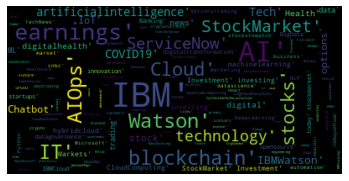

In [ ]:
wordcloud = WordCloud(max_font_size=40).generate(' '.join(hash1))
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

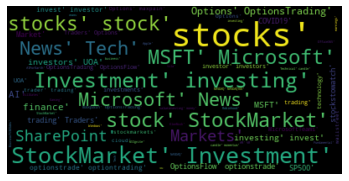

In [ ]:
wordcloud = WordCloud(max_font_size=40).generate(' '.join(hash2))
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

# **6.NATURAL LANGUAGE PROCESSING**

<image src ='https://www.affinsys.com/img/Affinsys_nlp.gif' width="1200"/> <image src='https://miro.medium.com/fit/c/1838/551/0*Cr3DyCxJxz7eCwYV.png'>

## TWEET TEXT

### Make all lower case

In [ ]:
txt1=tmp1['tweet_text']
txt2=tmp2['tweet_text']

In [ ]:
txt1=pd.DataFrame(txt1)

In [ ]:
txt2=pd.DataFrame(txt2)

In [ ]:
txt1['tweet_text'] = txt1['tweet_text'].str.lower()

In [ ]:
txt2['tweet_text'] = txt2['tweet_text'].str.lower()

In [ ]:
txt1.head()

,tweet_text
0,@ibmresearch propagates #quantumcomputing car...
1,how my non-traditional path led me to a caree...
2,hispanic star and ibm help high school studen...
3,@thehispanicstar and @ibm help high school st...
4,the hispanic star will focus on increasing th...


In [ ]:
txt2.head()

,tweet_text
0,earnings for the faamng stocks and tsla - 50%...
1,$msft microsoft announces quarterly earnings ...
2,$msft - microsoft announces quarterly earning...
3,$msft - microsoft announces quarterly earning...
4,$msft - microsoft announces quarterly earning...


### Remove Special Characters characters (!,~-@$% etc)

In [ ]:
txt1['tweet_text']= txt1['tweet_text'].str.replace('[^A-z ]','').str.replace(' +',' ').str.strip()
txt1['tweet_text']= txt1['tweet_text'].str.replace(' /','').str.replace(' +',' ').str.strip()
txt1.head()

,tweet_text
0,ibmresearch propagates quantumcomputing career...
1,how my nontraditional path led me to a career ...
2,hispanic star and ibm help high school student...
3,thehispanicstar and ibm help high school stude...
4,the hispanic star will focus on increasing the...


In [ ]:
txt2['tweet_text']= txt2['tweet_text'].str.replace('[^A-z ]','').str.replace(' +',' ').str.strip()
txt2['tweet_text']= txt2['tweet_text'].str.replace(' /','').str.replace(' +',' ').str.strip()
txt2.head()

,tweet_text
0,earnings for the faamng stocks and tsla of the...
1,msft microsoft announces quarterly earnings re...
2,msft microsoft announces quarterly earnings re...
3,msft microsoft announces quarterly earnings re...
4,msft microsoft announces quarterly earnings re...


###STOP WORDS

In [ ]:
# let's remove some of the stop words (see what happens if you comment this cell out)
# we can do better!
# define some stop words
import nltk
from nltk.corpus import stopwords


nltk.download('stopwords') # this makes sure these are downloaded if you haven't already!
print(stopwords.words('english'))

stop = stopwords.words('english') # see why it's important to turn everything lower case? all of your stopwords are!

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'ea

In [ ]:
# remove the stop words
# apply these stopwords to the data
# link: https://stackoverflow.com/questions/29523254/python-remove-stop-words-from-pandas-dataframe/43407993

# this looks good! 
# ' '. adds a nice space (try adding a 'D' instead of ' ' and see what happens!)
txt1.head() # note how the stop words have been removed
txt1['tweet_text'] = txt1['tweet_text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)])) 
txt1.head()

,tweet_text
0,ibmresearch propagates quantumcomputing career...
1,nontraditional path led career cybersecurity i...
2,hispanic star ibm help high school students hi...
3,thehispanicstar ibm help high school students ...
4,hispanic star focus increasing number mentorin...


In [ ]:
# remove the stop words
# apply these stopwords to the data
# link: https://stackoverflow.com/questions/29523254/python-remove-stop-words-from-pandas-dataframe/43407993

# this looks good! 
# ' '. adds a nice space (try adding a 'D' instead of ' ' and see what happens!)
txt2.head() # note how the stop words have been removed
txt2['tweet_text'] = txt2['tweet_text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)])) 
txt2.head()

,tweet_text
0,earnings faamng stocks tsla qqq spy buying sto...
1,msft microsoft announces quarterly earnings re...
2,msft microsoft announces quarterly earnings re...
3,msft microsoft announces quarterly earnings re...
4,msft microsoft announces quarterly earnings re...


### MOST 20 COMMON WORDS

In [ ]:
x1 = txt1['tweet_text'].str.split(expand=True).stack().value_counts()

In [ ]:
x2 = txt2['tweet_text'].str.split(expand=True).stack().value_counts()

In [ ]:
x1 = pd.DataFrame(x1)
# reset the index
x1.reset_index(inplace=True)
# rename the columns
x1.rename(columns={x1.columns[0]:'word', x1.columns[1]:'frequency'}, inplace=True)
x1.head()

,word,frequency
0,ibm,2409
1,watson,629
2,earnings,607
3,ai,445
4,revenue,343


In [ ]:
x2 = pd.DataFrame(x2)
# reset the index
x2.reset_index(inplace=True)
# rename the columns
x2.rename(columns={x2.columns[0]:'word', x2.columns[1]:'frequency'}, inplace=True)
x2.head()

,word,frequency
0,msft,1448
1,aapl,884
2,amzn,729
3,tsla,655
4,stock,588


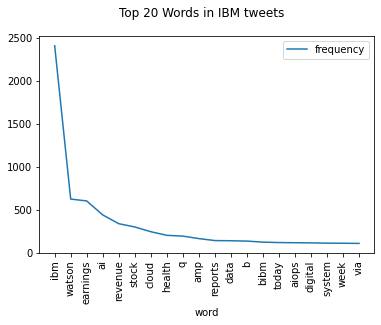

In [ ]:
x1 = x1[0:20] # wanna play? change the 20 to 10 or 30 and see what happens...
            # you need to run the previous cell first
x1.plot(x='word', y='frequency')
plt.xticks(np.arange(len(x1)), x1['word'], rotation=90)
plt.suptitle('Top 20 Words in IBM tweets')
plt.show()

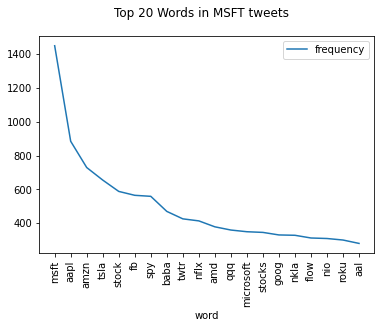

In [ ]:
x2 = x2[0:20] # wanna play? change the 20 to 10 or 30 and see what happens...
            # you need to run the previous cell first
x2.plot(x='word', y='frequency')
plt.xticks(np.arange(len(x2)), x2['word'], rotation=90)
plt.suptitle('Top 20 Words in MSFT tweets')
plt.show()

In [ ]:
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import matplotlib.pyplot as plt
% matplotlib inline

In [ ]:
import nltk
stop = stopwords.words('english')
stopwords = set(STOPWORDS)
stopwords.update(stop)

In [ ]:
from google.colab.patches import cv2_imshow

###IBM

####Image

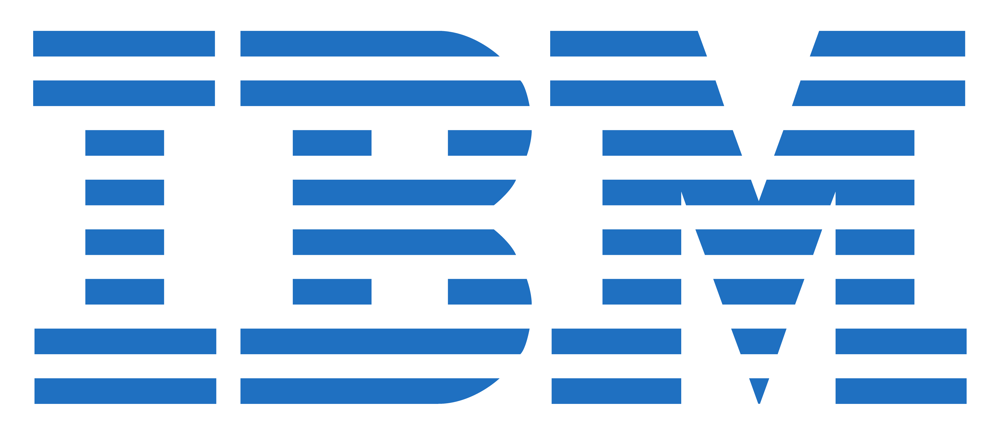

In [ ]:
import cv2
img = cv2.imread('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/IBM.png', cv2.IMREAD_UNCHANGED)
cv2_imshow(img)

####Word Cloud

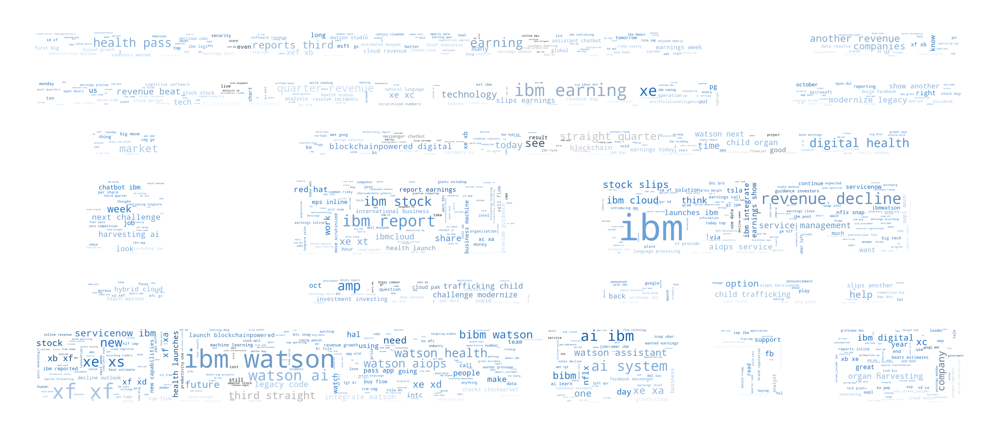

In [ ]:
mask = np.array(Image.open("/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/IBM.png")) #change the path

wordcloud_mes = WordCloud(stopwords=stopwords,background_color="white", mode="RGBA", max_words=1000, mask=mask).generate(' '.join(txt1['tweet_text']))

# create coloring from image
image_colors = ImageColorGenerator(mask)
plt.figure(figsize=[100,100])
plt.imshow(wordcloud_mes.recolor(color_func=image_colors), interpolation="bilinear")
plt.axis("off")

plt.show()

###MSFT

####Image

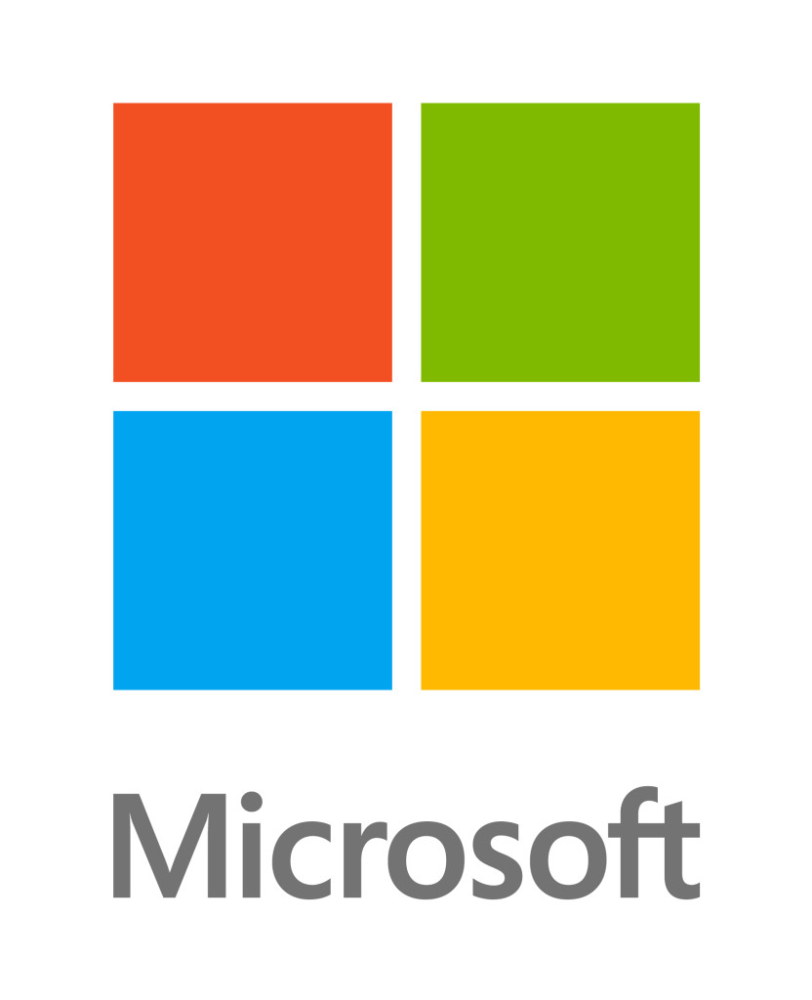

In [ ]:
import cv2
img = cv2.imread('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MSFT.jpg', cv2.IMREAD_UNCHANGED)
cv2_imshow(img)

####Word Cloud

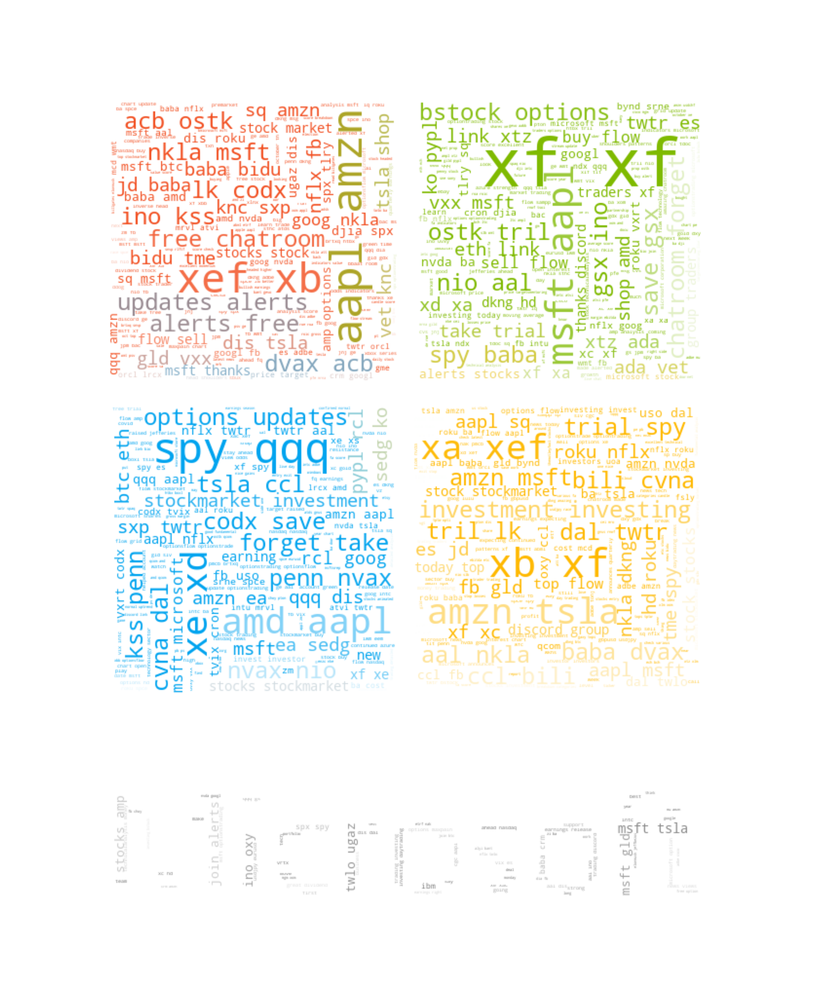

In [ ]:
mask = np.array(Image.open("/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MSFT.jpg")) #change the path
mes=str(' '.join(txt2).split())
wordcloud_mes = WordCloud(stopwords=stopwords,background_color="white", mode="RGBA", max_words=1000, mask=mask).generate(' '.join(txt2['tweet_text']))

# create coloring from image
image_colors = ImageColorGenerator(mask)
plt.figure(figsize=[100,100])
plt.imshow(wordcloud_mes.recolor(color_func=image_colors), interpolation="bilinear")
plt.axis("off")

# store to file

plt.show()

### Tokenization

In [ ]:
txt1['tweet_text'] = txt1.apply(lambda row: nltk.word_tokenize(row['tweet_text']), axis=1)
txt1.head()

,tweet_text
0,"[ibmresearch, propagates, quantumcomputing, ca..."
1,"[nontraditional, path, led, career, cybersecur..."
2,"[hispanic, star, ibm, help, high, school, stud..."
3,"[thehispanicstar, ibm, help, high, school, stu..."
4,"[hispanic, star, focus, increasing, number, me..."


In [ ]:
txt2['tweet_text'] = txt2.apply(lambda row: nltk.word_tokenize(row['tweet_text']), axis=1)
txt2.head()

,tweet_text
0,"[earnings, faamng, stocks, tsla, qqq, spy, buy..."
1,"[msft, microsoft, announces, quarterly, earnin..."
2,"[msft, microsoft, announces, quarterly, earnin..."
3,"[msft, microsoft, announces, quarterly, earnin..."
4,"[msft, microsoft, announces, quarterly, earnin..."


### Stemming

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
sentence = "He was running and eating at same time. He has bad habit of swimming after playing long hours in the Sun."

In [ ]:
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.stem import PorterStemmer
porter = PorterStemmer()
def stemSentence(sentence):
    token_words=word_tokenize(sentence)
    token_words
    stem_sentence=[]
    for word in token_words:
        stem_sentence.append(porter.stem(word))
        stem_sentence.append(" ")
    return "".join(stem_sentence)

x=stemSentence(sentence)
print(x)

He wa run and eat at same time . He ha bad habit of swim after play long hour in the sun . 


### Lemmatization

In [ ]:
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [ ]:
from nltk.stem import WordNetLemmatizer
wordnet_lemmatizer = WordNetLemmatizer()

sentence = "He was running and eating at same time. He has bad habit of swimming after playing long hours in the Sun."
punctuations="?:!.,;"
sentence_words = nltk.word_tokenize(sentence)
for word in sentence_words:
    if word in punctuations:
        sentence_words.remove(word)

sentence_words

['He',
 'was',
 'running',
 'and',
 'eating',
 'at',
 'same',
 'time',
 'He',
 'has',
 'bad',
 'habit',
 'of',
 'swimming',
 'after',
 'playing',
 'long',
 'hours',
 'in',
 'the',
 'Sun']

In [ ]:
print("{0:20}{1:20}".format("Word","Lemma"))
for word in sentence_words:
    print ("{0:20}{1:20}".format(word,wordnet_lemmatizer.lemmatize(word)))

Word                Lemma               
He                  He                  
was                 wa                  
running             running             
and                 and                 
eating              eating              
at                  at                  
same                same                
time                time                
He                  He                  
has                 ha                  
bad                 bad                 
habit               habit               
of                  of                  
swimming            swimming            
after               after               
playing             playing             
long                long                
hours               hour                
in                  in                  
the                 the                 
Sun                 Sun                 


Reference: https://www.datacamp.com/community/tutorials/stemming-lemmatization-python

#### Lexical Normalisation

In [ ]:
from nltk.stem import PorterStemmer
ps = PorterStemmer()

In [ ]:
txt1['Stemmed'] = txt1['tweet_text'].apply(lambda x: [ps.stem(y) for y in x])

In [ ]:
txt2['Stemmed'] = txt2['tweet_text'].apply(lambda x: [ps.stem(y) for y in x])

In [ ]:
txt1

,tweet_text,Stemmed
0,"[ibmresearch, propagates, quantumcomputing, ca...","[ibmresearch, propag, quantumcomput, career, e..."
1,"[nontraditional, path, led, career, cybersecur...","[nontradit, path, led, career, cybersecur, ibm..."
2,"[hispanic, star, ibm, help, high, school, stud...","[hispan, star, ibm, help, high, school, studen..."
3,"[thehispanicstar, ibm, help, high, school, stu...","[thehispanicstar, ibm, help, high, school, stu..."
4,"[hispanic, star, focus, increasing, number, me...","[hispan, star, focu, increas, number, mentor, ..."
...,...,...
2293,"[alertsanalysis, \xf\xf\xe\xaf, \xe\xc\xstocks...","[alertsanalysi, \xf\xf\xe\xaf, \xe\xc\xstock, ..."
2294,"[ibm, new, alert, stocks, daytrading, nyse, na...","[ibm, new, alert, stock, daytrad, nyse, nasdaq..."
2295,"[ibm, zos, container, extensions, zcx, use, ca...","[ibm, zo, contain, extens, zcx, use, case, reb..."
2296,"[bibm, floating, space, robot, got, emotional,...","[bibm, float, space, robot, got, emot, upgrad,..."


In [ ]:
txt2

,tweet_text,Stemmed
0,"[earnings, faamng, stocks, tsla, qqq, spy, buy...","[earn, faamng, stock, tsla, qqq, spi, buy, sto..."
1,"[msft, microsoft, announces, quarterly, earnin...","[msft, microsoft, announc, quarterli, earn, re..."
2,"[msft, microsoft, announces, quarterly, earnin...","[msft, microsoft, announc, quarterli, earn, re..."
3,"[msft, microsoft, announces, quarterly, earnin...","[msft, microsoft, announc, quarterli, earn, re..."
4,"[msft, microsoft, announces, quarterly, earnin...","[msft, microsoft, announc, quarterli, earn, re..."
...,...,...
1584,"[middle, school, best, friend, obsessed, msfts...","[middl, school, best, friend, obsess, msftsrep..."
1585,"[every, second, another, opportunity, emit, hi...","[everi, second, anoth, opportun, emit, higher,..."
1586,"[jisoo, wearing, msftsrep, necklace, omfg]","[jisoo, wear, msftsrep, necklac, omfg]"
1587,"[look, jisoo\xe\x\xs, necklace, she\xe\x\xs, w...","[look, jisoo\xe\x\x, necklac, she\xe\x\x, wear..."


## Feature Engineering (BONUS)

### Bagging

<image src='https://miro.medium.com/max/2364/1*jdjzV9Ynilw1cJAwBIX2MA.gif'>

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from nltk.tokenize import RegexpTokenizer

def rejoin_words(row):
    my_list = row['Stemmed']
    joined_words = ( " ".join(my_list))
    return joined_words

st1=txt1['Stemmed']
st1=pd.DataFrame(st1)
st1['Stemmed'] = st1.apply(rejoin_words, axis=1)


# get rid of garbage text
token = RegexpTokenizer(r'[a-zA-Z0-9]+')

#tokenizer to remove unwanted elements from out data like symbols and numbers
# IN ONE LINE OF CODE! Let's go for the more detailed description...
cv = CountVectorizer(lowercase=True,
                     stop_words='english',
                     ngram_range = (1,1), # (1,1) is unigram, (1,2) is uni and bigram, (2,2) is just bigram
                     tokenizer = token.tokenize)
text_counts1= cv.fit_transform(st1['Stemmed'])

In [ ]:
print(text_counts1)

  (0, 2333)	2
  (0, 3694)	1
  (0, 3756)	1
  (0, 818)	1
  (0, 1554)	1
  (0, 2813)	1
  (0, 10)	1
  (0, 290)	1
  (0, 3077)	1
  (0, 3741)	1
  (0, 3762)	1
  (0, 3740)	1
  (0, 3758)	1
  (0, 3081)	1
  (0, 572)	1
  (0, 3757)	1
  (0, 4387)	1
  (0, 5138)	1
  (1, 818)	2
  (1, 3273)	1
  (1, 3481)	1
  (1, 2754)	1
  (1, 1218)	1
  (1, 2300)	1
  (1, 593)	1
  :	:
  (2296, 4061)	1
  (2297, 2300)	1
  (2297, 3856)	1
  (2297, 5298)	3
  (2297, 5181)	3
  (2297, 3733)	1
  (2297, 5264)	1
  (2297, 5182)	3
  (2297, 1961)	1
  (2297, 3003)	1
  (2297, 4694)	1
  (2297, 2596)	1
  (2297, 3357)	1
  (2297, 1910)	1
  (2297, 5152)	1
  (2297, 4945)	1
  (2297, 3458)	1
  (2297, 222)	1
  (2297, 194)	1
  (2297, 333)	1
  (2297, 2558)	1
  (2297, 2979)	1
  (2297, 3048)	1
  (2297, 5190)	1
  (2297, 697)	1


In [ ]:
st2=txt2['Stemmed']
st2=pd.DataFrame(st2)
st2['Stemmed'] = st2.apply(rejoin_words, axis=1)

In [ ]:
text_counts2= cv.fit_transform(st2['Stemmed'])

In [ ]:
print(text_counts2)

  (0, 1063)	2
  (0, 1242)	1
  (0, 3152)	2
  (0, 3419)	2
  (0, 2676)	1
  (0, 3092)	1
  (0, 537)	1
  (0, 645)	1
  (0, 876)	1
  (0, 2280)	1
  (0, 2357)	7
  (0, 3308)	6
  (0, 3119)	1
  (0, 2205)	1
  (0, 1476)	1
  (0, 6)	1
  (0, 138)	1
  (0, 1270)	1
  (1, 1063)	1
  (1, 876)	1
  (1, 2205)	1
  (1, 2122)	1
  (1, 151)	1
  (1, 2683)	1
  (1, 2752)	1
  :	:
  (1587, 2209)	1
  (1587, 1794)	2
  (1587, 3631)	1
  (1587, 1821)	1
  (1587, 2256)	2
  (1587, 3029)	1
  (1587, 1688)	1
  (1587, 2895)	1
  (1587, 3655)	1
  (1588, 3714)	2
  (1588, 3757)	2
  (1588, 3755)	1
  (1588, 3759)	4
  (1588, 3713)	4
  (1588, 3165)	1
  (1588, 3731)	1
  (1588, 2209)	1
  (1588, 2720)	1
  (1588, 3324)	1
  (1588, 3311)	1
  (1588, 3069)	1
  (1588, 3443)	1
  (1588, 2303)	1
  (1588, 3621)	1
  (1588, 3650)	1


### TF-IDF 

 <image src='https://miro.medium.com/max/3096/1*T8WWibd7u8b7gfgeG0LgAA.gif'>

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
tf=TfidfVectorizer()
text_tf1= tf.fit_transform(st1['Stemmed'])

In [ ]:
text_tf2= tf.fit_transform(st2['Stemmed'])

In [ ]:
print(text_tf1)

  (0, 5235)	0.22143441663093769
  (0, 4459)	0.22724465503525426
  (0, 3820)	0.2343558121267145
  (0, 591)	0.2343558121267145
  (0, 3133)	0.2343558121267145
  (0, 3821)	0.2343558121267145
  (0, 3803)	0.2343558121267145
  (0, 3825)	0.2165219300564838
  (0, 3804)	0.2165219300564838
  (0, 3129)	0.22724465503525426
  (0, 14)	0.2343558121267145
  (0, 2863)	0.2343558121267145
  (0, 5052)	0.1276007924739575
  (0, 1579)	0.21226654062666625
  (0, 837)	0.1800287593668321
  (0, 3819)	0.2165219300564838
  (0, 3758)	0.2343558121267145
  (0, 2377)	0.41702604227032186
  (1, 612)	0.27154630913209854
  (1, 2341)	0.058561441021857966
  (1, 1241)	0.3408650196402913
  (1, 2803)	0.3649173985361129
  (1, 3543)	0.4118084659458159
  (1, 3329)	0.4118084659458159
  (1, 837)	0.5781929306072027
  :	:
  (2296, 5361)	0.1331513962043798
  (2296, 4639)	0.2893146696334209
  (2297, 715)	0.22522128376430053
  (2297, 5287)	0.22522128376430053
  (2297, 3100)	0.22522128376430053
  (2297, 3030)	0.22522128376430053
  (2297, 2

In [ ]:
print(text_tf1)

  (0, 5235)	0.22143441663093769
  (0, 4459)	0.22724465503525426
  (0, 3820)	0.2343558121267145
  (0, 591)	0.2343558121267145
  (0, 3133)	0.2343558121267145
  (0, 3821)	0.2343558121267145
  (0, 3803)	0.2343558121267145
  (0, 3825)	0.2165219300564838
  (0, 3804)	0.2165219300564838
  (0, 3129)	0.22724465503525426
  (0, 14)	0.2343558121267145
  (0, 2863)	0.2343558121267145
  (0, 5052)	0.1276007924739575
  (0, 1579)	0.21226654062666625
  (0, 837)	0.1800287593668321
  (0, 3819)	0.2165219300564838
  (0, 3758)	0.2343558121267145
  (0, 2377)	0.41702604227032186
  (1, 612)	0.27154630913209854
  (1, 2341)	0.058561441021857966
  (1, 1241)	0.3408650196402913
  (1, 2803)	0.3649173985361129
  (1, 3543)	0.4118084659458159
  (1, 3329)	0.4118084659458159
  (1, 837)	0.5781929306072027
  :	:
  (2296, 5361)	0.1331513962043798
  (2296, 4639)	0.2893146696334209
  (2297, 715)	0.22522128376430053
  (2297, 5287)	0.22522128376430053
  (2297, 3100)	0.22522128376430053
  (2297, 3030)	0.22522128376430053
  (2297, 2

## SENTEMENT ANALYSIS

<image src='https://miro.medium.com/proxy/1*_JW1JaMpK_fVGld8pd1_JQ.gif'>

In [ ]:
import seaborn as sns

sns.set(rc={'figure.figsize':(30,1)})

def visualise_sentiments(data):
  sns.heatmap(pd.DataFrame(data).set_index("Sentence").T,center=0, annot=True, cmap = "PiYG")

In [ ]:
sentence = "Penny stocks are a risky investment, but there are some ways to lower the risk "

## NLTK Vader

In [ ]:
import nltk
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer
sid = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


/usr/local/lib/python3.6/dist-packages/nltk/twitter/__init__.py:20: UserWarning: The twython library has not been installed. Some functionality from the twitter package will not be available.
  warnings.warn("The twython library has not been installed. "


In [ ]:
sid.polarity_scores(sentence)

{'compound': -0.705, 'neg': 0.384, 'neu': 0.616, 'pos': 0.0}

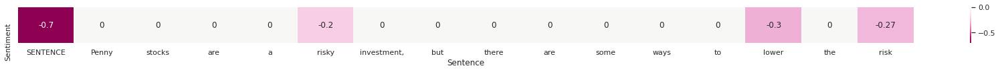

In [ ]:
visualise_sentiments({
    "Sentence":["SENTENCE"] + sentence.split(),
    "Sentiment":[sid.polarity_scores(sentence)["compound"]] + [sid.polarity_scores(word)["compound"] for word in sentence.split()]
})

## TextBlob and Naive Bayes Analyzer

In [ ]:
from textblob import TextBlob
from textblob import Blobber
from textblob.sentiments import NaiveBayesAnalyzer

In [ ]:
TextBlob(sentence).sentiment

Sentiment(polarity=0.0, subjectivity=0.0)

In [ ]:
nltk.download('movie_reviews')

[nltk_data] Downloading package movie_reviews to /root/nltk_data...
[nltk_data]   Unzipping corpora/movie_reviews.zip.


True

In [ ]:
blobber = Blobber(analyzer=NaiveBayesAnalyzer())
blob = blobber(sentence)
blob.sentiment

Sentiment(classification='pos', p_pos=0.712563471657839, p_neg=0.28743652834216177)

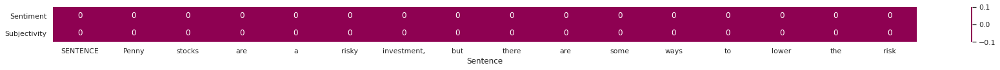

In [ ]:
visualise_sentiments({
      "Sentence":["SENTENCE"] + sentence.split(),
      "Sentiment":[TextBlob(sentence).polarity] + [TextBlob(word).polarity for word in sentence.split()],
      "Subjectivity":[TextBlob(sentence).subjectivity] + [TextBlob(word).subjectivity for word in sentence.split()],
})

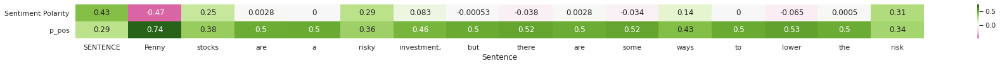

In [ ]:
visualise_sentiments({
      "Sentence":["SENTENCE"] + sentence.split(),
      "Sentiment Polarity":[blob.sentiment.p_pos - blob.sentiment.p_neg] + [blobber(word).sentiment.p_pos - blobber(word).sentiment.p_neg for word in sentence.split()],
      "p_pos":[blob.sentiment.p_neg] + [blobber(word).sentiment.p_neg for word in sentence.split()],
})

## Flair

In [ ]:
!pip3 install flair
import flair
flair_sentiment = flair.models.TextClassifier.load('en-sentiment')

     |████████████████████████████████| 450kB 8.8MB/s 
     |████████████████████████████████| 71kB 6.3MB/s 
     |████████████████████████████████| 798kB 12.6MB/s 
     |████████████████████████████████| 1.1MB 20.4MB/s 
     |████████████████████████████████| 983kB 27.9MB/s 
     |████████████████████████████████| 1.3MB 44.1MB/s 
     |████████████████████████████████| 19.7MB 73.1MB/s 
     |████████████████████████████████| 890kB 44.1MB/s 
     |████████████████████████████████| 2.9MB 44.3MB/s 
  Created wheel for sqlitedict: filename=sqlitedict-1.7.0-cp36-none-any.whl size=14377 sha256=c206d84c83a608ce4a46d5807c6e4e18b2de7774a7561747ec993f2409164c24
  Stored in directory: /root/.cache/pip/wheels/cf/c6/4f/2c64a43f041415eb8b8740bd80e15e92f0d46c5e464d8e4b9b
  Created wheel for segtok: filename=segtok-1.5.10-cp36-none-any.whl size=25021 sha256=69840f7c2739642a7210b96e63e82fe3e5583abadd807f326ecd79e312becbf5
  Stored in directory: /root/.cache/pip/wheels/b4/39/f6/9ca1c5cabde964d728023b57

100%|██████████| 266147697/266147697 [00:52<00:00, 5096742.82B/s]

2020-12-03 09:56:28,087 copying /tmp/tmpd7bvz75z to cache at /root/.flair/models/sentiment-en-mix-distillbert_3.1.pt


2020-12-03 09:56:28,477 removing temp file /tmp/tmpd7bvz75z
2020-12-03 09:56:28,510 loading file /root/.flair/models/sentiment-en-mix-distillbert_3.1.pt


In [ ]:
s = flair.data.Sentence(sentence)
flair_sentiment.predict(s)
total_sentiment = s.labels
total_sentiment

[POSITIVE (0.6473)]

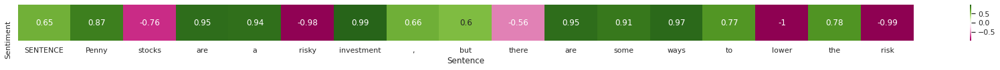

In [ ]:
tokens = [token.text for token in s.tokens]
ss = [flair.data.Sentence(s) for s in tokens]
[flair_sentiment.predict(s) for s in ss]
sentiments = [s.labels[0].score * (-1,1)[str(s.labels[0]).split()[0].startswith("POS")] for s in ss]

visualise_sentiments({
      "Sentence":["SENTENCE"] + tokens,
      "Sentiment":[total_sentiment[0].score *(-1,1)[str(total_sentiment[0]).split()[0].startswith("POS")]] + sentiments,
})

#### Sentiment Analysis

We found Text blob gave a great results.

In [ ]:
for i in txt1.index:
  sentence=txt1.loc[i,'Stemmed']
  sentence=str(sentence)
  a=TextBlob(sentence).polarity
  txt1.loc[i,'Sentiment']=a

In [ ]:
txt1.head()

,tweet_text,Stemmed,Sentiment
0,"[ibmresearch, propagates, quantumcomputing, ca...","[ibmresearch, propag, quantumcomput, career, e...",0.00
1,"[nontraditional, path, led, career, cybersecur...","[nontradit, path, led, career, cybersecur, ibm...",0.00
2,"[hispanic, star, ibm, help, high, school, stud...","[hispan, star, ibm, help, high, school, studen...",0.16
3,"[thehispanicstar, ibm, help, high, school, stu...","[thehispanicstar, ibm, help, high, school, stu...",0.16
4,"[hispanic, star, focus, increasing, number, me...","[hispan, star, focu, increas, number, mentor, ...",0.00


In [ ]:
txt1.describe()

,Sentiment
count,2298.000000
mean,0.063906
std,0.193302
min,-0.800000
25%,0.000000
50%,0.000000
75%,0.100000
max,1.000000


In [ ]:
for i in txt2.index:
  sentence=txt2.loc[i,'Stemmed']
  sentence=str(sentence)
  a=TextBlob(sentence).polarity
  txt2.loc[i,'Sentiment']=a

In [ ]:
txt2.head()

,tweet_text,Stemmed,Sentiment
0,"[earnings, faamng, stocks, tsla, qqq, spy, buy...","[earn, faamng, stock, tsla, qqq, spi, buy, sto...",0.0
1,"[msft, microsoft, announces, quarterly, earnin...","[msft, microsoft, announc, quarterli, earn, re...",0.0
2,"[msft, microsoft, announces, quarterly, earnin...","[msft, microsoft, announc, quarterli, earn, re...",0.0
3,"[msft, microsoft, announces, quarterly, earnin...","[msft, microsoft, announc, quarterli, earn, re...",0.0
4,"[msft, microsoft, announces, quarterly, earnin...","[msft, microsoft, announc, quarterli, earn, re...",0.0


In [ ]:
txt2.describe()

,Sentiment
count,1589.000000
mean,0.157211
std,0.244273
min,-0.850000
25%,0.000000
50%,0.000000
75%,0.400000
max,1.000000


# MICROSOFT STOCKS HAVE GOOD PUBLIC SENTIMENT IN TWITTER

<image src='https://news.crunchbase.com/wp-content/uploads/2017/08/MSFTBIG.gif'>


# **7. STOCK PREDICTION**

# IBM

<image src='https://media2.giphy.com/media/Svv9qeEuzaMBa13UXE/giphy.gif'>

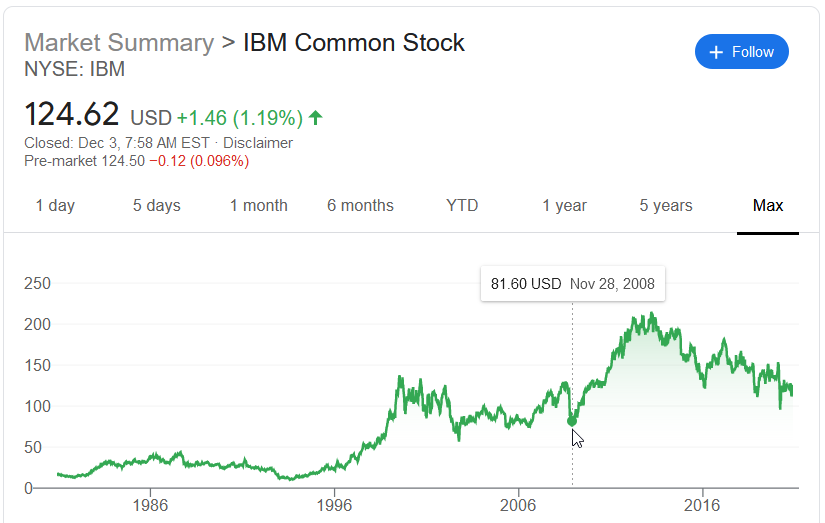

## Web Scrapping the stock data

In [ ]:
# mapping/ mounting the drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd
pd.core.common.is_list_like = pd.api.types.is_list_like
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
import pandas_datareader as pdr
import datetime 
from sklearn.preprocessing import MinMaxScaler
% matplotlib inline

In [ ]:
data1 = pdr.get_data_yahoo('IBM',start='2009-01-01',end='2020-10-20')
data1 

,High,Low,Open,Close,Volume,Adj Close
Date,,,,,,
2009-01-02,87.589996,83.889999,83.889999,87.370003,7558200.0,59.605556
2009-01-05,87.669998,86.180000,86.419998,86.820000,8315700.0,59.230339
2009-01-06,90.410004,86.370003,87.110001,89.230003,9649500.0,60.874500
2009-01-07,88.800003,87.120003,87.830002,87.790001,8455100.0,59.892090
2009-01-08,88.139999,85.980003,87.809998,87.180000,7231800.0,59.475941
...,...,...,...,...,...,...
2020-10-14,126.940002,125.129997,125.129997,125.940002,3730100.0,124.139908
2020-10-15,125.220001,123.849998,124.080002,124.889999,3385300.0,123.104912
2020-10-16,126.430000,124.660004,125.169998,125.930000,4710400.0,124.130051


## DATA WRANGLING

####Imputation

In [ ]:
dt = datetime.date(2009, 1, 1)
end = datetime.date(2020,10,20)
day=pd.date_range(start=dt,end=end,freq='D')
temp=pd.DataFrame(day,columns=['Date'])

In [ ]:
temp=temp.set_index('Date',drop=True)

In [ ]:
temp

""
Date
2009-01-01
2009-01-02
2009-01-03
2009-01-04
2009-01-05
...
2020-10-16
2020-10-17
2020-10-18


In [ ]:
data1=pd.concat([data1,temp],axis=1)

In [ ]:
tmp11=pd.read_html('https://www.macrotrends.net/stocks/charts/IBM/ibm/total-assets')[1]
tmp12=pd.read_html('https://www.macrotrends.net/stocks/charts/IBM/ibm/total-liabilities')[1]
tmp13=pd.read_html('https://www.macrotrends.net/stocks/charts/IBM/ibm/gross-profit')[1]
tmp14=pd.read_html('https://www.macrotrends.net/stocks/charts/IBM/ibm/net-income')[1]
tmp15=pd.read_html('https://www.macrotrends.net/stocks/charts/IBM/ibm/revenue')[1]
tmp16=pd.read_html('https://www.macrotrends.net/stocks/charts/IBM/ibm/total-share-holder-equity')[1]
tmp17=pd.read_html('https://www.macrotrends.net/stocks/charts/IBM/ibm/long-term-debt')[1]
tmp18=pd.read_html('https://www.macrotrends.net/stocks/charts/IBM/ibm/cash-on-hand')[1]

In [ ]:
def comtmp(data,tmp1,name):
  tmp1.columns = np.arange(len(tmp1.columns))
  tmp1=tmp1.fillna('0')
  tmp1[0]=pd.to_datetime(tmp1[0], format='%Y-%m-%d')
  tmp1=tmp1[tmp1[0].dt.year>2008]
  tmp1[1] = tmp1[1].map(lambda x: x.lstrip('$,').rstrip(','))
  tmp1[1] = tmp1[1].map(lambda x: x.replace(',',''))
  tmp1=tmp1.set_index(0)
  tmp1[1]=tmp1[1].astype('float64')
  name=[name]
  tmp1.columns=name
  data=pd.concat([data,tmp1],axis=1)
  return data

In [ ]:
data1=comtmp(data1,tmp11,'Total-assets')
data1= comtmp(data1,tmp12,'Total-liabilities')
data1= comtmp(data1,tmp13,'Gross-profit')
data1= comtmp(data1,tmp14,'Net-income')
data1= comtmp(data1,tmp15,'Revenue')
data1= comtmp(data1,tmp16,'Total-share-holder-equity')
data1= comtmp(data1,tmp17,'Long-term-debt')
data1= comtmp(data1,tmp18,'Cash-on-hand')

In [ ]:
data1=data1.ffill()
data1=data1.bfill()

In [ ]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4311 entries, 2009-01-01 to 2020-10-20
Freq: D
Data columns (total 14 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   High                       4311 non-null   float64
 1   Low                        4311 non-null   float64
 2   Open                       4311 non-null   float64
 3   Close                      4311 non-null   float64
 4   Volume                     4311 non-null   float64
 5   Adj Close                  4311 non-null   float64
 6   Total-assets               4311 non-null   float64
 7   Total-liabilities          4311 non-null   float64
 8   Gross-profit               4311 non-null   float64
 9   Net-income                 4311 non-null   float64
 10  Revenue                    4311 non-null   float64
 11  Total-share-holder-equity  4311 non-null   float64
 12  Long-term-debt             4311 non-null   float64
 13  Cash-on-hand          

## EXPLORATORY DATA ANALYSIS

### Line Plots

No handles with labels found to put in legend.


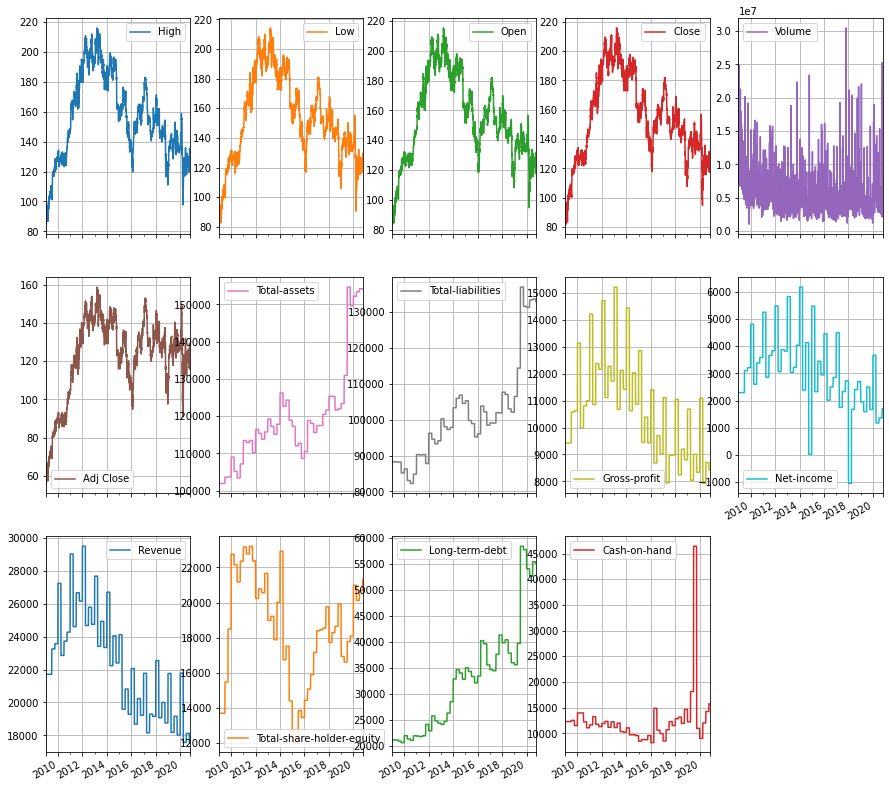

In [ ]:
data1.plot(subplots=True,
        grid=True, 
        layout=(3,5),
         figsize=(15,15))
plt.legend(fontsize='xx-small')
plt.show()

### Candle Plot


In [ ]:
fig = go.Figure(data=[go.Candlestick(
    x=data1.index,
    open=data1['Open'], high=data1['High'],
    low=data1['Low'], close=data1['Close'],
    increasing_line_color= 'green', decreasing_line_color= 'red'
)])
fig.update_layout(
    title='Stock Market',
    yaxis_title='IBM Stock')
fig.show() #There is a slider,You can zoom into dates by double click and slide the range.Check it out!Cool right! 

### Data Statistics

In [ ]:
data1.describe().T

,count,mean,std,min,25%,50%,75%,max
High,4311.0,1.560857e+02,2.837809e+01,8.482000e+01,1.345900e+02,1.538600e+02,1.807600e+02,2.159000e+02
Low,4311.0,1.538151e+02,2.837574e+01,8.176000e+01,1.324900e+02,1.518700e+02,1.781150e+02,2.143000e+02
Open,4311.0,1.549350e+02,2.836271e+01,8.361000e+01,1.336300e+02,1.528500e+02,1.794800e+02,2.153800e+02
Close,4311.0,1.549834e+02,2.836998e+01,8.198000e+01,1.339700e+02,1.527900e+02,1.795450e+02,2.158000e+02
Volume,4311.0,5.104816e+06,2.857377e+06,1.027500e+06,3.300100e+06,4.307300e+06,5.882100e+06,3.049020e+07
Adj Close,4311.0,1.224723e+02,2.115053e+01,5.592840e+01,1.145119e+02,1.273102e+02,1.374969e+02,1.589092e+02
Total-assets,4311.0,1.195921e+05,1.352751e+04,1.019440e+05,1.120370e+05,1.172710e+05,1.226460e+05,1.546520e+05
Total-liabilities,4311.0,1.011226e+05,1.347535e+04,8.224400e+04,9.027900e+04,9.904700e+04,1.052570e+05,1.368760e+05
Gross-profit,4311.0,1.064394e+04,1.817443e+03,7.923000e+03,9.013000e+03,1.067800e+04,1.173200e+04,1.522900e+04
Net-income,4311.0,3.034312e+03,1.404874e+03,-1.054000e+03,2.295000e+03,2.950000e+03,3.839000e+03,6.184000e+03


##Pair plot

In [ ]:
fig = px.scatter_matrix(data1)
fig.update_layout(dragmode='select',
                  width=1000,
                  height=1000,
                  hovermode='closest',
                  font=dict(family="Courier New, monospace",size=7,color="RebeccaPurple"))
fig.show()

## Correlation Heat Map

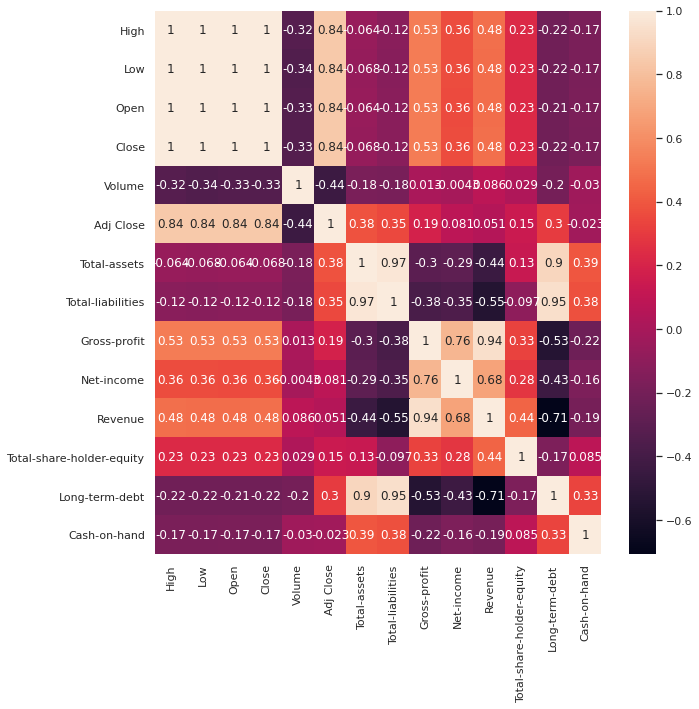

In [ ]:
corr2=data1.corr(method='pearson')
sns.set(rc={'figure.figsize':(10,10)})
plot1=sns.heatmap(data=corr2, annot=True)
plot1

##Density plot

####Because the range of the dataset is large.

In [ ]:
#@title Choose 3 columns out of 14 columns and time interval to compare  

a = "High" #@param ['High', 'Low', 'Open', 'Close', 'Volume', 'Adj Close', 'Total-assets','Total-liabilities', 'Gross-profit', 'Net-income', 'Revenue','Total-share-holder-equity', 'Long-term-debt', 'Cash-on-hand']
b = "Open" #@param ['High', 'Low', 'Open', 'Close', 'Volume', 'Adj Close', 'Total-assets','Total-liabilities', 'Gross-profit', 'Net-income', 'Revenue','Total-share-holder-equity', 'Long-term-debt', 'Cash-on-hand']
c = "Adj Close" #@param ['High', 'Low', 'Open', 'Close', 'Volume', 'Adj Close', 'Total-assets','Total-liabilities', 'Gross-profit', 'Net-income', 'Revenue','Total-share-holder-equity', 'Long-term-debt', 'Cash-on-hand']
date = "2020-01-01" #@param {type:"string"}



In [ ]:
ar=data1.loc[date:,[a,b,c]]

In [ ]:
fig = ff.create_distplot([ar[c] for c in ar.columns], ar.columns, bin_size=0.5)
fig.show()

## Pandas profiler

In [ ]:
#%pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [ ]:
#from pandas_profiling import ProfileReport

In [ ]:
#profile2=ProfileReport(data1)

In [ ]:
#profile2

In [ ]:
#data1.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/uncleanIBMbq.csv')

##Time Series Partition

### IBM

In [ ]:
data1.head()

,High,Low,Open,Close,Volume,Adj Close,Total-assets,Total-liabilities,Gross-profit,Net-income,Revenue,Total-share-holder-equity,Long-term-debt,Cash-on-hand
2009-01-01,87.589996,83.889999,83.889999,87.370003,7558200.0,59.605556,101944.0,88252.0,9430.0,2295.0,21711.0,13693.0,21106.0,12295.0
2009-01-02,87.589996,83.889999,83.889999,87.370003,7558200.0,59.605556,101944.0,88252.0,9430.0,2295.0,21711.0,13693.0,21106.0,12295.0
2009-01-03,87.589996,83.889999,83.889999,87.370003,7558200.0,59.605556,101944.0,88252.0,9430.0,2295.0,21711.0,13693.0,21106.0,12295.0
2009-01-04,87.589996,83.889999,83.889999,87.370003,7558200.0,59.605556,101944.0,88252.0,9430.0,2295.0,21711.0,13693.0,21106.0,12295.0
2009-01-05,87.669998,86.180000,86.419998,86.820000,8315700.0,59.230339,101944.0,88252.0,9430.0,2295.0,21711.0,13693.0,21106.0,12295.0


In [ ]:
# Split data into X and Y
y = data1['Adj Close']
X=data1.drop(['Open','Close','Low','High','Adj Close'],axis=1)
print(data1.shape, X.shape, y.shape)

(4311, 14) (4311, 9) (4311,)


In [ ]:
y=y.shift(-1,axis=0)
y=y.ffill()

In [ ]:
# split the data into train and test partitions
# we will use 97% of the data for train, and rest for validation
train_pct_index = int(0.97 * len(X))
X1_train, X1_test = X[:train_pct_index], X[train_pct_index:]
y1_train, y1_test = y[:train_pct_index], y[train_pct_index:]

In [ ]:
# X is still a 2D array
print(X1_train.shape, y1_train.shape)
print(X1_test.shape, y1_test.shape)

(4181, 9) (4181,)
(130, 9) (130,)


In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler() # this like 2D data
X1_train = scaler.fit_transform(X1_train) # fit and transform
X1_test = scaler.transform(X1_test) # transform simply means APPLY the learned coordinate
print(X1_train.shape, X1_test.shape)

(4181, 9) (130, 9)


In [ ]:
X_train=pd.DataFrame(X1_train)
X_test=pd.DataFrame(X1_test) 
y_train=pd.DataFrame(y1_train)
y_test=pd.DataFrame(y1_test) 

In [ ]:
d_train, d_test = data1[:train_pct_index], data1[train_pct_index:]

In [ ]:
# d_train = scaler.fit_transform(d_train) # fit and transform
# d_test = scaler.transform(d_test) # transform simply means APPLY the learned coordinate

In [ ]:
d_train=pd.DataFrame(d_train,columns=data1.columns) 
d_test=pd.DataFrame(d_test,columns=data1.columns)  

In [ ]:
# d_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/IBMdatatrain.csv')
# d_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/IBMdatatest.csv')

In [ ]:
# X_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/IBMXtrain.csv')
# X_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/IBMXtest.csv')
# y_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/IBMYtrain.csv')
# y_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/IBMYtest.csv') 

## MACHINE LEARNING DATA PARTITION

### Principal component analysis (PCA)

In [ ]:
from sklearn import decomposition

In [ ]:
pca = decomposition.PCA()
pca.fit(X)
Xpca = pca.transform(X)

### Feature Selection

In [ ]:
from sklearn.feature_selection import f_regression #Univariate linear regression test

In [ ]:
features=f_regression(X,y,center=True) #gives row 0 as f-value and row 1 as p-value
features=pd.DataFrame(features,columns=X.columns)
features.round(8) #round it to 6 decimal points I guess

,Volume,Total-assets,Total-liabilities,Gross-profit,Net-income,Revenue,Total-share-holder-equity,Long-term-debt,Cash-on-hand
0,1039.23441,740.918929,607.225947,161.621856,2.952193e+01,11.892093,93.208636,426.667474,2.147221
1,0.00000,0.000000,0.000000,0.000000,6.000000e-08,0.000569,0.000000,0.000000,0.142901


In [ ]:
for i in features.columns:
  if np.abs(features.loc[1,i])>0.05: #|p-value|(both sides of population mean) is less = good predictor
    del features[i]

In [ ]:
var1=features.columns

In [ ]:
Xstep=data1.loc[:,var1]

### Partition

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
Xp_train, Xp_test, yp_train, yp_test=train_test_split(Xpca,y,test_size=0.2,random_state=123)

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler() # this like 2D data
Xp_train = scaler.fit_transform(Xp_train) # fit and transform
Xp_test = scaler.transform(Xp_test) # transform simply means APPLY the learned coordinate
print(Xp_train.shape, Xp_test.shape)

(3448, 9) (863, 9)


In [ ]:
Xp_train=pd.DataFrame(Xp_train)
Xp_test=pd.DataFrame(Xp_test) 
yp_train=pd.DataFrame(yp_train,columns=['Adj Close'])
yp_test=pd.DataFrame(yp_test,columns=['Adj Close']) 

In [ ]:
# Xp_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/PCA /IBMXtrain.csv')
# Xp_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/PCA /IBMXtest.csv')
# yp_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/PCA /IBMYtrain.csv')
# yp_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/PCA /IBMYtest.csv') 

In [ ]:
Xs_train, Xs_test, ys_train, ys_test=train_test_split(Xstep,y,test_size=0.2,random_state=123)

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler() # this like 2D data
Xs_train = scaler.fit_transform(Xs_train) # fit and transform
Xs_test = scaler.transform(Xs_test) # transform simply means APPLY the learned coordinate
print(Xs_train.shape, Xs_test.shape)

(3448, 8) (863, 8)


In [ ]:
Xs_train=pd.DataFrame(Xs_train,columns=var1)
Xs_test=pd.DataFrame(Xs_test,columns=var1)
ys_train=pd.DataFrame(ys_train,columns=['Adj Close'])
ys_test=pd.DataFrame(ys_test,columns=['Adj Close'])

In [ ]:
# Xs_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/Stepwise/IBMXtrain.csv')
# Xs_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/Stepwise/IBMXtest.csv')
# ys_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/Stepwise/IBMYtrain.csv')
# ys_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/Stepwise/IBMYtest.csv') 

# MODELING

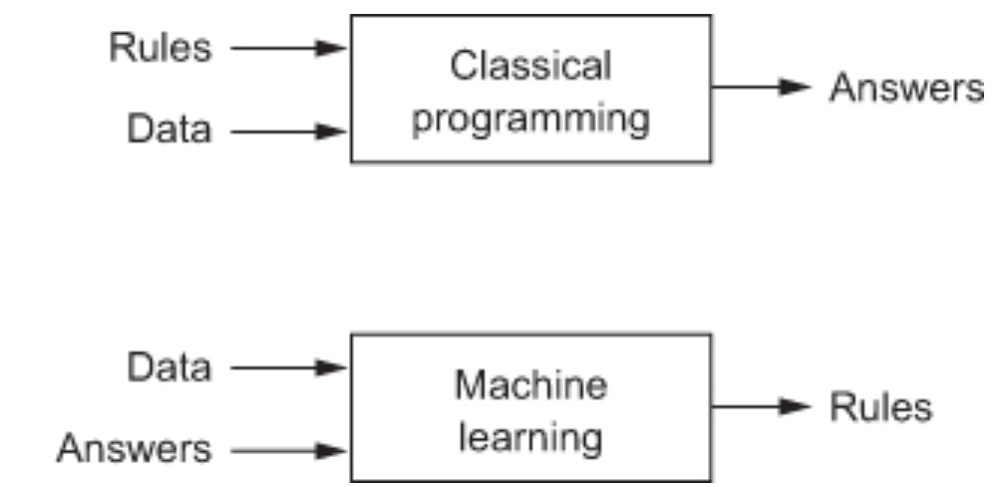

<image src='https://images.squarespace-cdn.com/content/v1/5e41533a12c3004e2341e68a/1587745492184-2GV0X4IZ6SH9K51M27X5/ke17ZwdGBToddI8pDm48kNvT88LknE-K9M4pGNO0Iqd7gQa3H78H3Y0txjaiv_0fDoOvxcdMmMKkDsyUqMSsMWxHk725yiiHCCLfrh8O1z5QPOohDIaIeljMHgDF5CVlOqpeNLcJ80NK65_fV7S1UU_i9-ln4sAC0TGEmkfMFKJn5Kcyb6Y0O9dBHu3N61jtpC969RuPXvt2ZwyzUXQf7Q/machine-learning.gif'>

## LINEAR REGRESSION

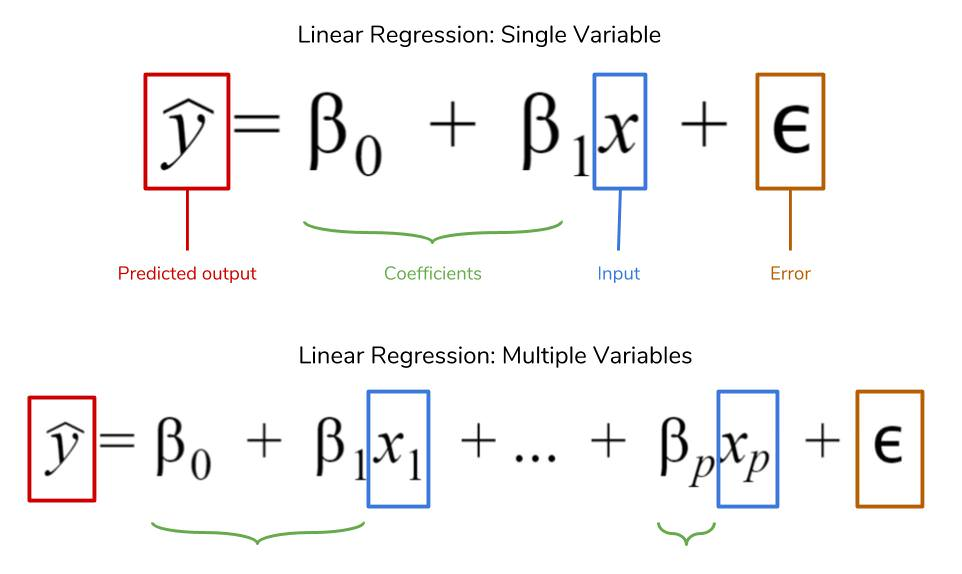

[Source](https://www.google.com/url?sa=i&url=https%3A%2F%2Fwww.dataquest.io%2Fblog%2Funderstanding-regression-error-metrics%2F&psig=AOvVaw2019KDLlyLArrHsMnJbpLi&ust=1606996048945000&source=images&cd=vfe&ved=0CAIQjRxqFwoTCNiC8ficr-0CFQAAAAAdAAAAABAD)

Linear regression quantifies the relationship between one or more predictor variable and one outcome variable. 

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn import metrics

In [ ]:
def linear(X1_train,X1_test,y1_train,y1_test):
  linear=LinearRegression()
  linear.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(linear.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse1=np.sqrt(mse)
  return y1_pred,rmse1


### Linear Regression PCA

In [ ]:
pred1p,rmse1p=linear(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred1p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred1p.index,y=pred1p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LINEAR REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred1p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LINEAR REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### Linear Regression Stepwise

In [ ]:
pred1s,rmse1s=linear(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred1s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred1s.index,y=pred1s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LINEAR REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred1s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LINEAR REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## LASSO REGRESSION

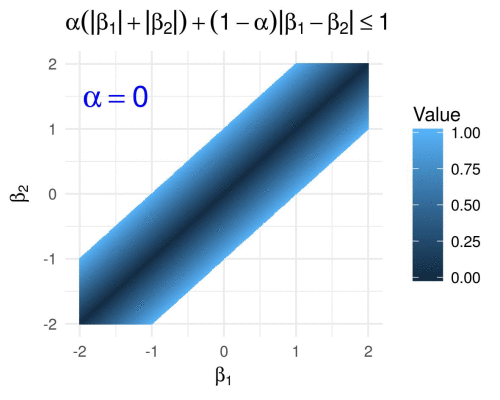

[Source](https://www.r-bloggers.com/2017/03/contours-of-statistical-penalty-functions-as-gif-images/)

Lasso regression is a type of linear regression that uses shrinkage.

In [ ]:
from sklearn.linear_model import Lasso

In [ ]:
def lasso(X1_train,X1_test,y1_train,y1_test):
  lasso=Lasso(alpha=0.1)
  lasso.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(lasso.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse2=np.sqrt(mse)
  return y1_pred,rmse2

### Lasso Regression PCA

In [ ]:
pred2p,rmse2p=lasso(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred2p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred2p.index,y=pred2p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LASSO REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred2p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LASSO REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### Lasso Regression Stepwise

In [ ]:
pred2s,rmse2s=lasso(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred2s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred2s.index,y=pred2s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LASSO REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred2s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LASSO REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## RIDGE REGRESSION

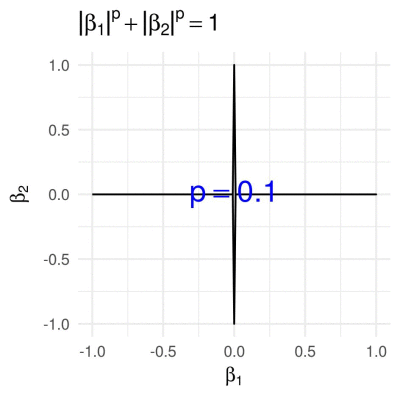

[Source](https://www.r-bloggers.com/2017/03/contours-of-statistical-penalty-functions-as-gif-images/)

In [ ]:
from sklearn.linear_model import Ridge

In [ ]:
def ridge(X1_train,X1_test,y1_train,y1_test):
  ridge = Ridge(alpha=1.0)
  ridge.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(ridge.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse3=np.sqrt(mse)
  return y1_pred,rmse3

### Ridge Regression PCA

In [ ]:
pred3p,rmse3p=ridge(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred3p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred3p.index,y=pred3p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='RIDGE REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred3p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for RIDGE REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### Ridge Regression Stepwise

In [ ]:
pred3s,rmse3s=ridge(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred3s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred3s.index,y=pred3s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='RIDGE REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred3s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for RIDGE REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## ELASTIC NET REGRESSION




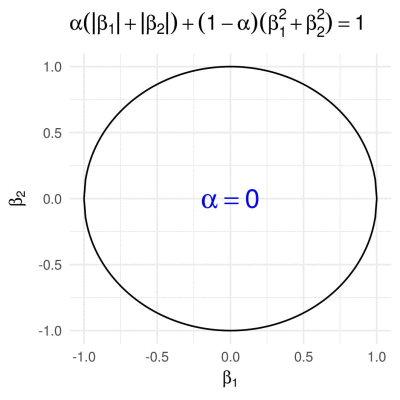

[Source](https://www.r-bloggers.com/2017/03/contours-of-statistical-penalty-functions-as-gif-images/)

The Elastic Net is a regularized regression method that linearly combines the L1 and L2 penalties of the lasso and ridge methods. 

In [ ]:
from sklearn.linear_model import ElasticNet

In [ ]:
def EN(X1_train,X1_test,y1_train,y1_test):
  EN=ElasticNet(random_state=123)
  EN.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(EN.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse4=np.sqrt(mse)
  return y1_pred,rmse4

### Elastic net Regression PCA

In [ ]:
pred4p,rmse4p=EN(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred4p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred4p.index,y=pred4p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='ELASTIC NET REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred4p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for ELASTIC NET REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### Elastic net Regression Stepwise

In [ ]:
pred4s,rmse4s=EN(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred4s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred4s.index,y=pred4s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='ELASTIC NET REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred4s[0],
                    mode='markers',
                    name='Actual Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for ELASTIC NET REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## DECISION TREE

<image src='https://res.cloudinary.com/practicaldev/image/fetch/s--NOtmmf5a--/c_limit%2Cf_auto%2Cfl_progressive%2Cq_66%2Cw_880/https://twilio-cms-prod.s3.amazonaws.com/original_images/tree.gif' width="400"/>

Decision tree builds regression  models in the form of a tree structure.

In [ ]:
from sklearn.tree import DecisionTreeRegressor

In [ ]:
def DT(X1_train,X1_test,y1_train,y1_test):
  DT=DecisionTreeRegressor(random_state=123)
  DT.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(DT.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse5=np.sqrt(mse)
  return y1_pred,rmse5

### Decsion Tree PCA

In [ ]:
pred5p,rmse5p=DT(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred5p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred5p.index,y=pred5p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='DECISION TREE',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred5p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for DECISION TREE PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

###Decision Tree Stepwise

In [ ]:
pred5s,rmse5s=DT(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred5s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred5s.index,y=pred5s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='DECISION TREE',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred5s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for DECISION TREE STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## KNN MODEL

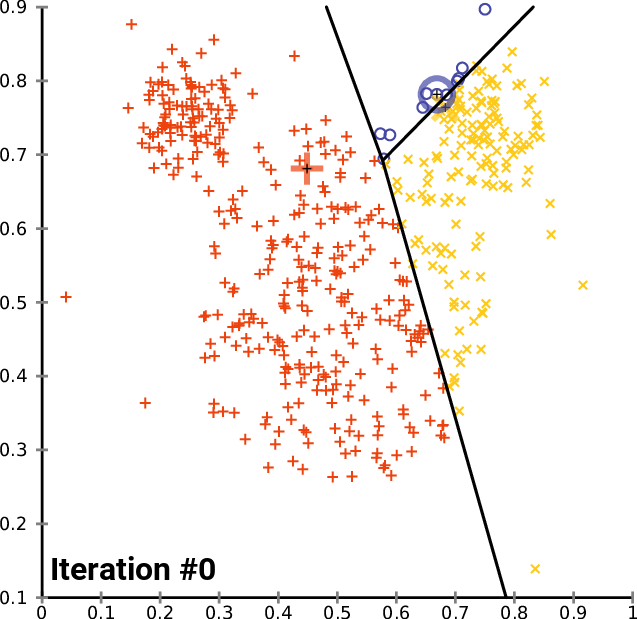

[Source](https://www.google.com/url?sa=i&url=https%3A%2F%2Fcommons.wikimedia.org%2Fwiki%2FFile%3AK-means_convergence.gif&psig=AOvVaw0Kfp-Mzjc2fKezrQfGGhLz&ust=1606999381908000&source=images&cd=vfe&ved=0CAIQjRxqFwoTCOD7nqypr-0CFQAAAAAdAAAAABAD)

K nearest neighbors is a simple algorithm that stores all available cases and predict the numerical target based on a similarity measure

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

In [ ]:
def KNN(X1_train,X1_test,y1_train,y1_test):
  KNN=KNeighborsRegressor()
  KNN.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(KNN.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse6=np.sqrt(mse)
  return y1_pred,rmse6


### KNN Regressor PCA

In [ ]:
pred6p,rmse6p=KNN(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred6p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred6p.index,y=pred6p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='KNN REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred6p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for KNN REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### KNN Regressor Stepwise

In [ ]:
pred6s,rmse6s=KNN(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred6s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred6s.index,y=pred6s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='KNN REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred6s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for KNN REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## SVR MODEL

In [ ]:
#@title
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from sklearn.svm import SVR

mesh_size = .02
margin = 0

df = px.data.iris()

X = df[['sepal_width', 'sepal_length']]
y = df['petal_width']

# Condition the model on sepal width and length, predict the petal width
model = SVR(C=1.)
model.fit(X, y)

# Create a mesh grid on which we will run our model
x_min, x_max = X.sepal_width.min() - margin, X.sepal_width.max() + margin
y_min, y_max = X.sepal_length.min() - margin, X.sepal_length.max() + margin
xrange = np.arange(x_min, x_max, mesh_size)
yrange = np.arange(y_min, y_max, mesh_size)
xx, yy = np.meshgrid(xrange, yrange)

# Run model
pred = model.predict(np.c_[xx.ravel(), yy.ravel()])
pred = pred.reshape(xx.shape)

# Generate the plot
fig = px.scatter_3d(df, x='sepal_width', y='sepal_length', z='petal_width')
fig.update_traces(marker=dict(size=5))
fig.add_traces(go.Surface(x=xrange, y=yrange, z=pred, name='pred_surface'))
fig.show()



[Source](https://plotly.com/python/ml-regression/#3d-regression-surface-with-pxscatter3d-and-gosurface)

 Support Vector Regression (SVR) applies the idea of SVM to predict real values rather than a class.

> SVR acknowledges the presence of non-linearity in the data and provides a proficient prediction model.



In [ ]:
from sklearn.svm import SVR

In [ ]:
def svm(X1_train,X1_test,y1_train,y1_test):
  svr=SVR(C=1.0, epsilon=0.2)
  svr.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(svr.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse7=np.sqrt(mse)
  return y1_pred,rmse7

### SVR Regression PCA

In [ ]:
pred7p,rmse7p=svm(Xp_train,Xp_test,yp_train,yp_test)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred7p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred7p.index,y=pred7p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='SVR REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred7p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for SVR REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### SVR Regression Stepwise

In [ ]:
pred7s,rmse7s=svm(Xs_train,Xs_test,ys_train,ys_test)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred7s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred7s.index,y=pred7s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='SVR REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred7s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for SVR REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## NEURAL NETWORK MODEL

<image src='https://raw.githubusercontent.com/mtoto/mtoto.github.io/master/data/2017-11-08-net/test_anim.gif'>





Neural networks are a set of algorithms, modeled loosely after the human brain, that are designed to recognize patterns.

In [ ]:
from sklearn.neural_network import MLPRegressor

In [ ]:
def NN(X1_train,X1_test,y1_train,y1_test):
  clf = MLPRegressor(random_state=123, max_iter=10000)
  clf.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(clf.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse8=np.sqrt(mse)
  return y1_pred,rmse8

### Neural Network PCA

In [ ]:
pred8p,rmse8p=NN(Xp_train,Xp_test,yp_train,yp_test)

/usr/local/lib/python3.6/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1342: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred8p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred8p.index,y=pred8p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='NEURAL NETWORK',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred8p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for NEURAL NETWORK PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### Neural Network Stepwise

In [ ]:
pred8s,rmse8s=NN(Xs_train,Xs_test,ys_train,ys_test)

/usr/local/lib/python3.6/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1342: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred8s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred8s.index,y=pred8s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='NEURAL NETWORK',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred8s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for NEURAL NETWORK STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## ENSEMBLE MODELS

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

![alt text](https://miro.medium.com/max/1280/1*9kACduxnce_JdTrftM_bsA.gif)

![alt text](https://miro.medium.com/max/900/1*IFoOIqlshjtQ34BpsLsIrg.gif)

![alt text](https://thumbs.gfycat.com/RigidFantasticBlackfly-size_restricted.gif)

### RANDOM FOREST MODEL

In [ ]:
def E1(X1_train,X1_test,y1_train,y1_test):
  clf = RandomForestRegressor(random_state=123)
  clf.fit(X1_train, y1_train)
  y1_pred=pd.DataFrame(clf.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse9=np.sqrt(mse)
  return y1_pred,rmse9

#### Random Forest Model PCA

In [ ]:
pred9p,rmse9p=E1(Xp_train,Xp_test,yp_train,yp_test)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred9p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred9p.index,y=pred9p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='RANDOM FOREST MODEL',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred9p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for RANDOM FOREST MODEL PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

####  Random Forest Model Stepwise

In [ ]:
pred9s,rmse9s=E1(Xs_train,Xs_test,ys_train,ys_test)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred9s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred9s.index,y=pred2s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='RANDOM FOREST MODEL',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred9s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for RANDOM FOREST MODEL STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### GRADIENT BOOSTING REGRESSOR MODEL

In [ ]:
def E2(X1_train,X1_test,y1_train,y1_test):
  clf = GradientBoostingRegressor(random_state=123)
  clf.fit(X1_train, y1_train)
  y1_pred=pd.DataFrame(clf.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse10=np.sqrt(mse)
  return y1_pred,rmse10

#### Gradient Boosting Regressor PCA

In [ ]:
pred10p,rmse10p=E2(Xp_train,Xp_test,yp_train,yp_test)

/usr/local/lib/python3.6/dist-packages/sklearn/ensemble/_gb.py:1454: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred10p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred10p.index,y=pred10p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='GRADIENT BOOSTING REGRESSOR',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred10p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for GRADIENT BOOSTING REGRESSOR PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

#### Gradient Boosting Regressor Stepwise

In [ ]:
pred10s,rmse10s=E2(Xs_train,Xs_test,ys_train,ys_test)

/usr/local/lib/python3.6/dist-packages/sklearn/ensemble/_gb.py:1454: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred10s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred10s.index,y=pred10s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='GRADIENT BOOSTING REGRESSOR',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred10s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for GRADIENT BOOSTING REGRESSOR STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

# TIME SERIES MODELS 

![alt text](https://i.pinimg.com/originals/57/2f/8c/572f8cbe4c9f69c217bdc33b82eb0c28.gif)

## ARIMA MODEL

In [ ]:
 train_data, test_data = data1['Adj Close'][0:int(len(data1)*0.97)], data1['Adj Close'][int(len(data1)*0.97)-1:]

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf  #autocorrelation
from statsmodels.tsa.stattools import adfuller as ADF  # stable test
from statsmodels.graphics.tsaplots import plot_pacf    #pacf
from statsmodels.stats.diagnostic import acorr_ljungbox    #white noise
from statsmodels.tsa.arima_model import ARIMA

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



### STATIONARITY TEST

A TimeSeries is said to be stationary if its statistical properties such as mean variance remain constant over time.

In [ ]:
plt.clf()
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 20,10
params = {'legend.fontsize': 'x-large',
            'axes.labelsize': 'x-large',
          'axes.titlesize':'x-large',
          'xtick.labelsize':'x-large',
          'ytick.labelsize':'x-large'}
rcParams.update(params)

<Figure size 720x720 with 0 Axes>

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_train.index,y=y_train['Adj Close'],
                    mode='lines',
                    name='Training Data'))
  fig.add_trace(go.Scatter(x=y_test.index,y=y_test['Adj Close'],
                    mode='lines',
                    name='Testing Data'))
  # Edit the layout
  fig.update_xaxes(tickformat="%B %d, %Y",rangeslider_visible=True, rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    ))
  fig.update_layout(title='Adjusted Close Price',
                   xaxis_title='Date',
                   yaxis_title='Adjusted Close Price')
  fig.show()

In [ ]:
from statsmodels.tsa.stattools import adfuller

In [ ]:
def test_stationarity(timeseries):
    #Determing rolling statistics
    rolmean = pd.Series(timeseries).rolling(window=12).mean()
    rolstd = pd.Series(timeseries).rolling(window=12).std()

    #Plot rolling statistics:
    plt.style.use('seaborn')
    rcParams['figure.figsize'] = 20,10
    orig = plt.plot(timeseries,label='Original')
    mean = plt.plot(rolmean, label='Rolling Mean')
    std = plt.plot(rolstd, label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey-Fuller test:
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

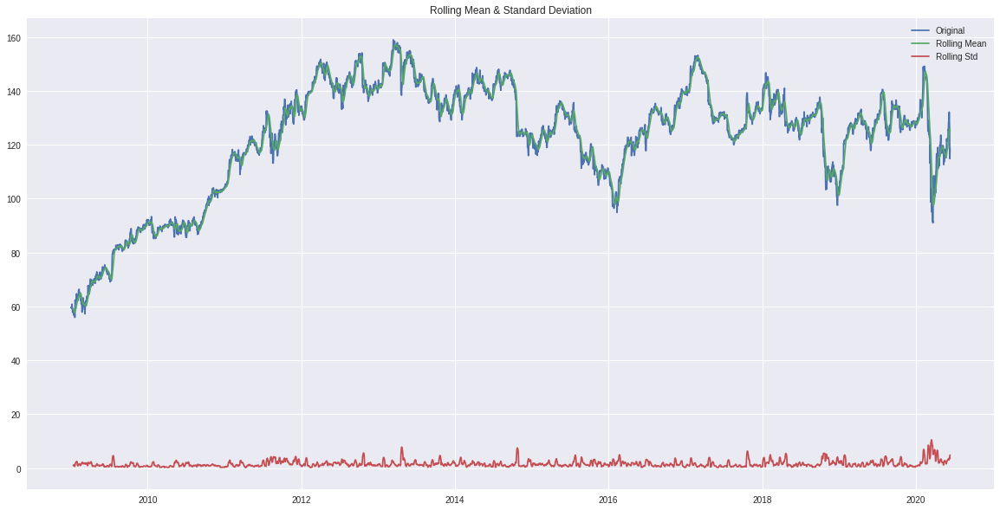

Results of Dickey-Fuller Test:
Test Statistic                   -3.235039
p-value                           0.018044
#Lags Used                       13.000000
Number of Observations Used    4167.000000
Critical Value (1%)              -3.431920
Critical Value (5%)              -2.862234
Critical Value (10%)             -2.567139
dtype: float64


In [ ]:
test_stationarity(train_data)

Not stationary, the test statistic is way more than the critical values, p-value is too big.

Try to make it Stationary

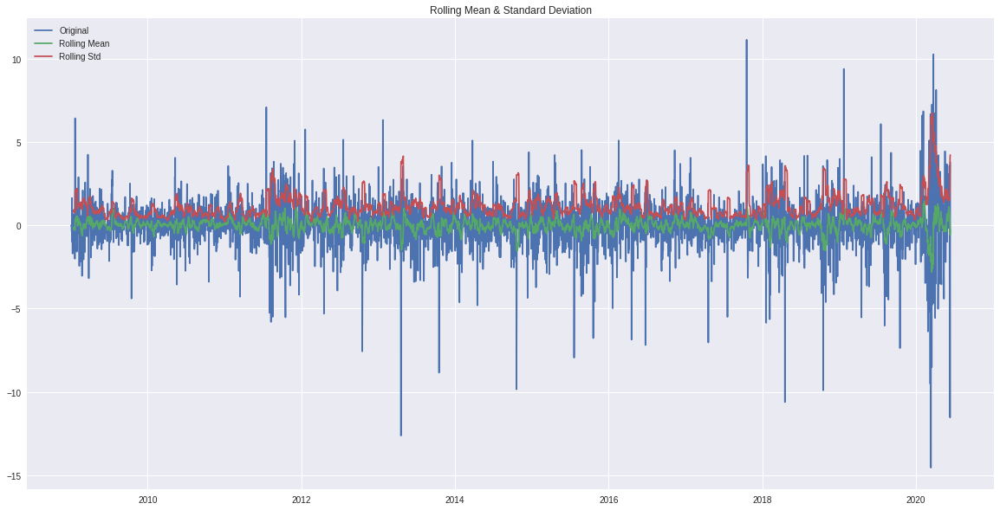

Results of Dickey-Fuller Test:
Test Statistic                -1.763190e+01
p-value                        3.794851e-30
#Lags Used                     1.200000e+01
Number of Observations Used    4.167000e+03
Critical Value (1%)           -3.431920e+00
Critical Value (5%)           -2.862234e+00
Critical Value (10%)          -2.567139e+00
dtype: float64


In [ ]:
D_df = train_data.diff().dropna()
test_stationarity(D_df)
D_df=pd.DataFrame(D_df)
D_df.columns = ['df diff']

### STABILITY TEST

In [ ]:
#After First order difference, it shows stable fluctuation, it has strong Short-term correlation,
ADF_D_df_p =ADF(D_df['df diff'])[1]
print("p-value of first order difference sequence adf test is "+str(ADF_D_df_p))
#the unit root test p value is less than 0.05,
#so the sequence after the first order difference is a stable sequence

p-value of first order difference sequence adf test is 3.794850532315451e-30


### ACF AND PACF 

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf  #autocorrelation
from statsmodels.tsa.stattools import adfuller as ADF  # stable test
from statsmodels.graphics.tsaplots import plot_pacf    #pacf
from statsmodels.stats.diagnostic import acorr_ljungbox    #white noise
from statsmodels.tsa.arima_model import ARIMA

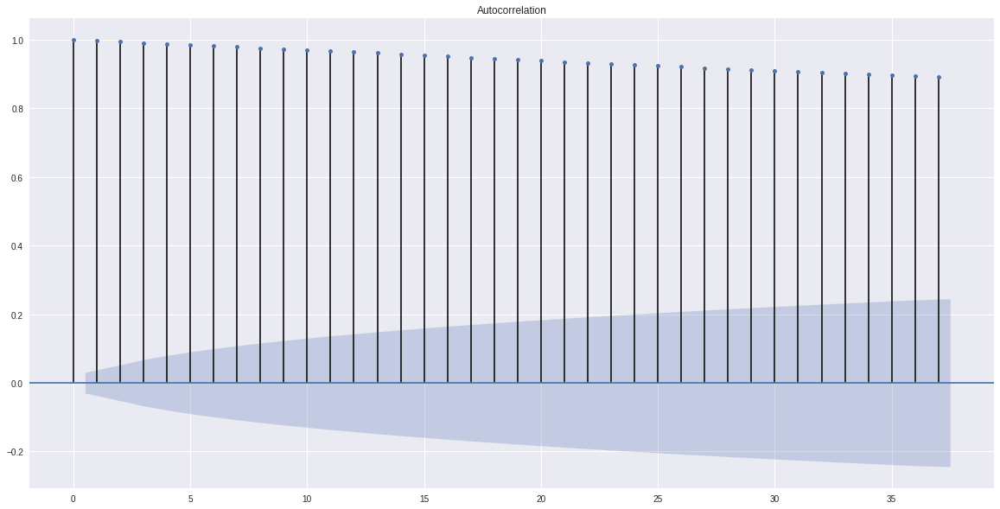

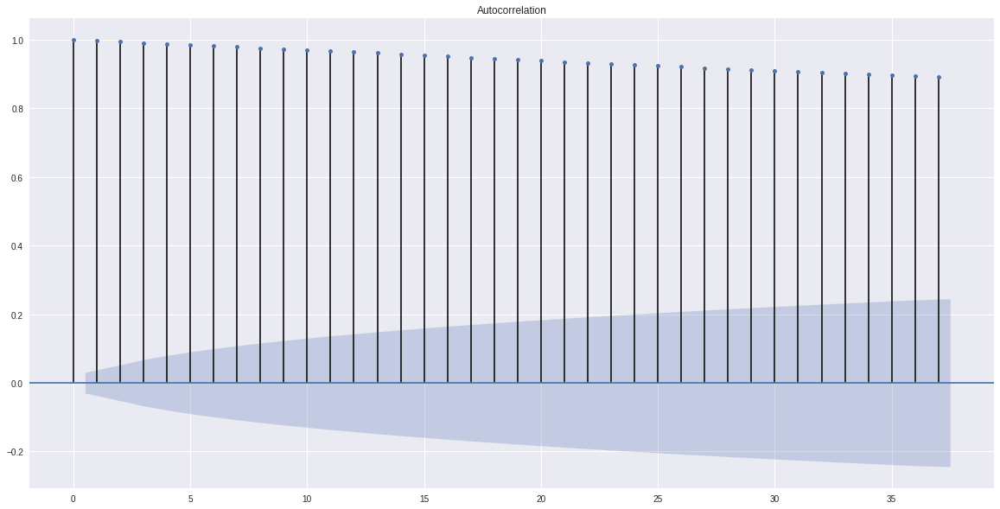

In [ ]:
plot_acf(train_data)

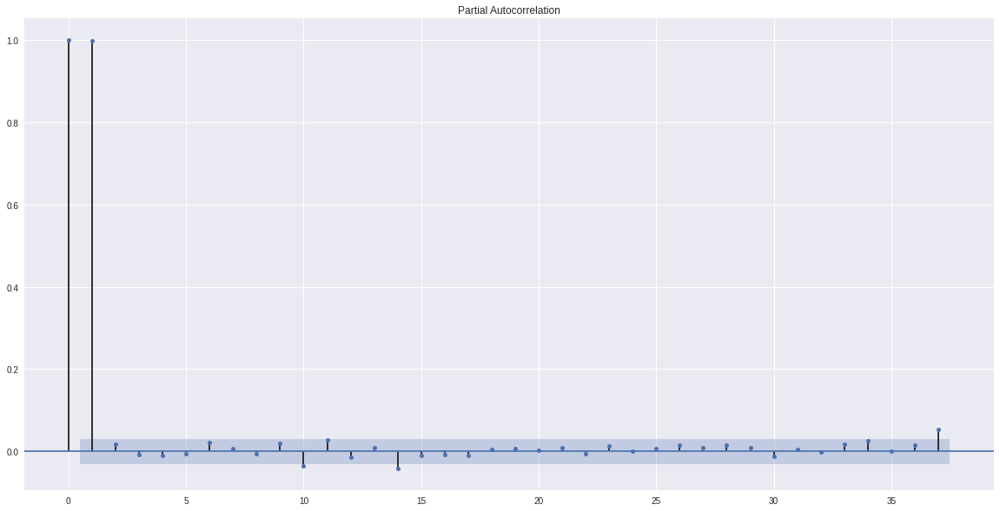

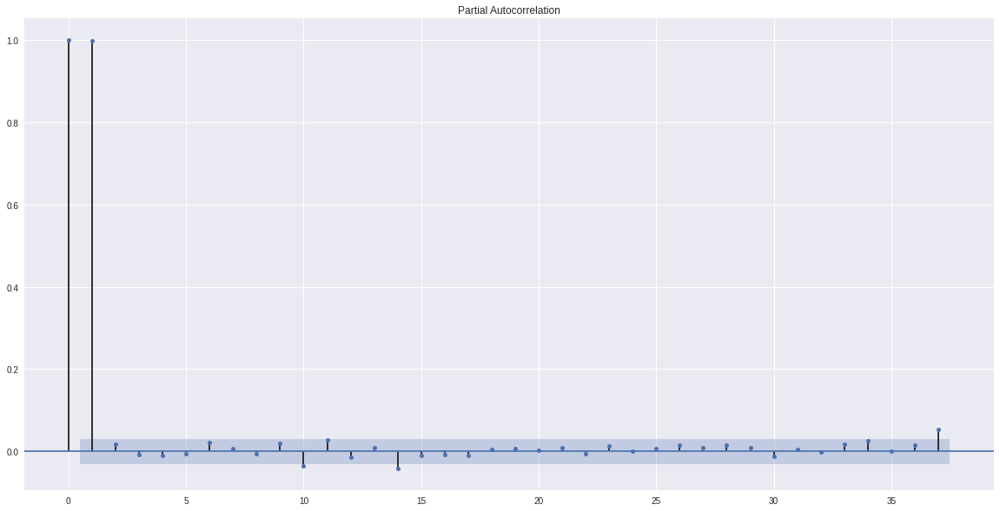

In [ ]:
plot_pacf(train_data)

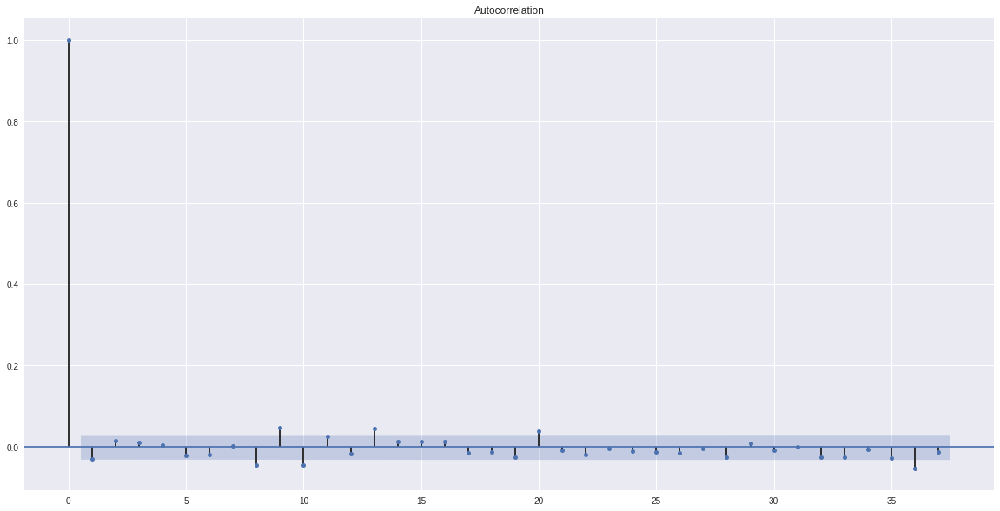

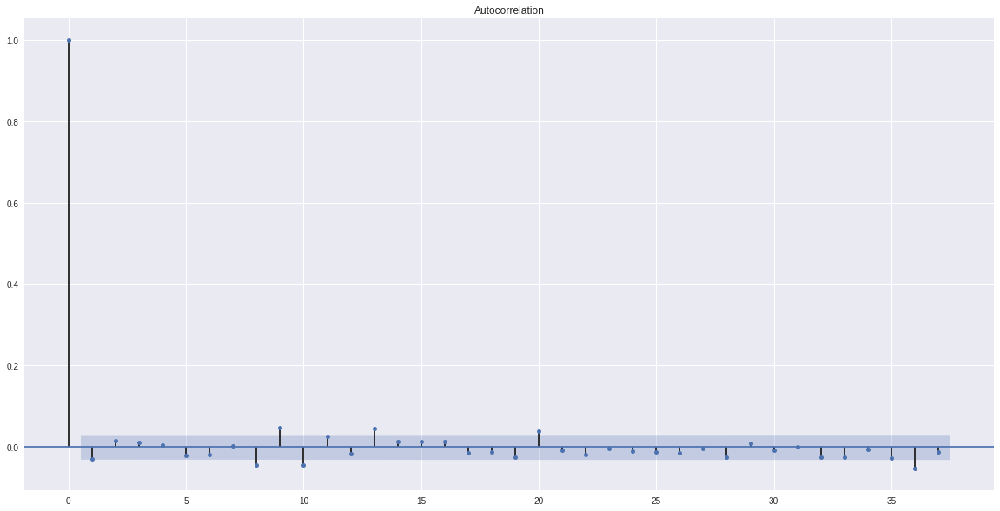

In [ ]:
plot_acf(D_df) 

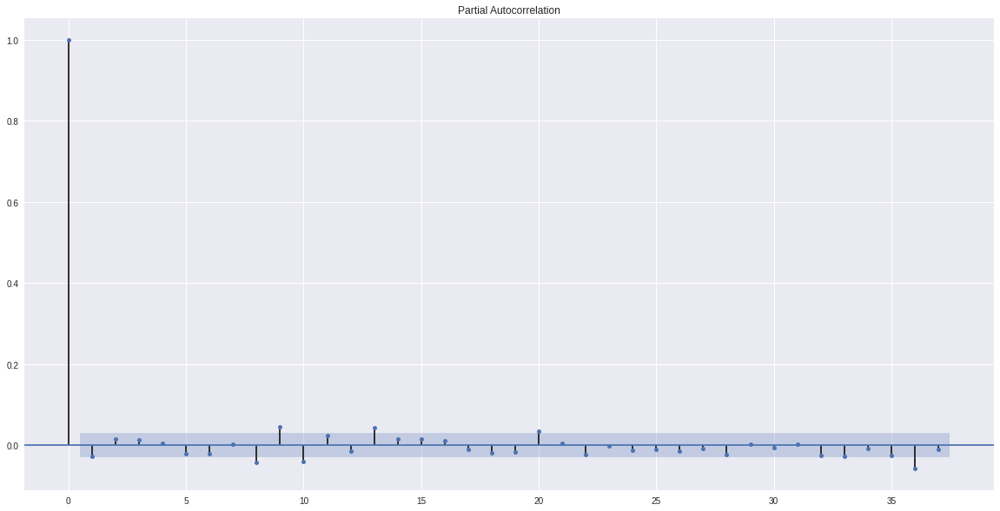

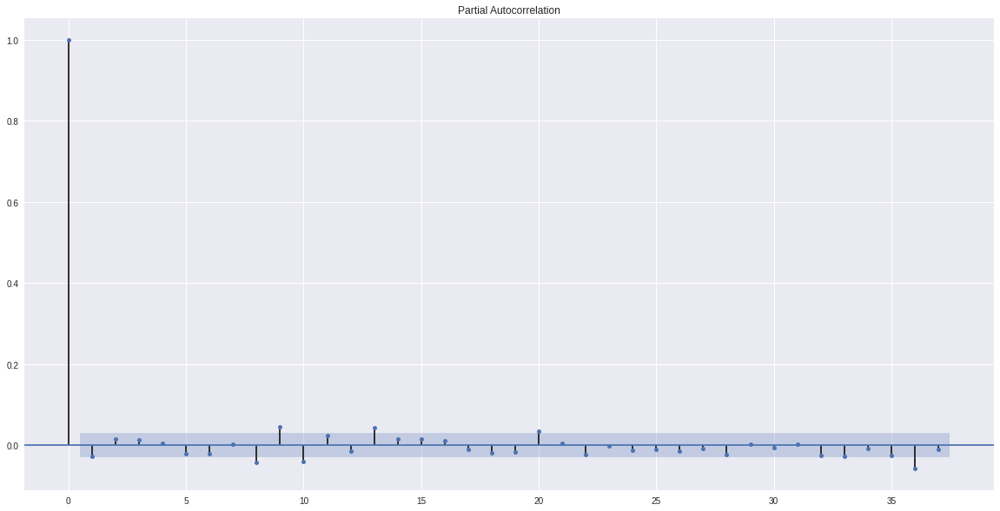

In [ ]:
plot_pacf(D_df)

### WHITE NOISE TEST

In [ ]:
from statsmodels.tsa.stattools import acf, pacf
from scipy.ndimage.interpolation import shift
from statsmodels.tsa.arima_model import ARIMA

In [ ]:
wn=acorr_ljungbox(D_df, lags=1)
print("The p-value of White Noise test of first order difference is "+ str(wn[1][0]))
#<0.05 stable and not white noise

The p-value of White Noise test of first order difference is 0.06622117834085213


### AUTO-ARIMA

In [ ]:
from statsmodels.tsa.arima_model import ARIMA

In [ ]:
!pip install pyramid-arima
from pyramid.arima import auto_arima

     |████████████████████████████████| 604kB 5.3MB/s 


/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning:

The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).

/usr/local/lib/python3.6/dist-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning:

sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.

/usr/local/lib/python3.6/dist-packages/pyramid/__init__.py:68: UserWarning:


    The 'pyramid' package will be migrating to a new namespace beginning in 
    version 1.0.0: 'pmdarima'. This is due to a package name collision with the
    Pyramid web framework. For more information, see Issue #34:
    
        https:/

In [ ]:
def armodel(train_data,test_data):
    aa=auto_arima(train_data,start_p=0, start_q=0, max_p=1, max_q=1,m=12,start_P=1,start_Q=1,seasonal=True,d=1, D=1, trace=True,error_action='ignore',  suppress_warnings=True, stepwise=True)
    train_ar = train_data.values
    test_ar = test_data.values
    history = [x for x in train_ar]
    print(history)
    predictions = list()
    for t in range(len(test_ar)):
      model = ARIMA(history,order=(aa.order))
      model_fit = model.fit()
      output = model_fit.forecast()
      yhat = output[0]
      predictions.append(yhat)
      obs = test_ar[t]
      history.append(obs)
    error = metrics.mean_squared_error(test_ar, predictions)
    rmse=np.sqrt(error)
    plt.plot(train_data,color='green', label='Training Data')
    plt.plot(test_data.index, predictions, marker='o', linestyle='dashed', 
    label='Predicted Price')
    plt.plot(test_data.index, test_data, color='red', label='Actual Price')
    plt.title('Price Prediction')
    plt.xlabel('Dates')
    plt.ylabel('Prices')
    plt.legend()
    plt.show()
    predictions=pd.DataFrame(predictions)
    return predictions,rmse

Fit ARIMA: order=(0, 1, 0) seasonal_order=(1, 1, 1, 12); AIC=17661.585, BIC=17686.925, Fit time=27.911 seconds
Fit ARIMA: order=(0, 1, 0) seasonal_order=(0, 1, 0, 12); AIC=20648.874, BIC=20661.544, Fit time=0.354 seconds
Fit ARIMA: order=(1, 1, 0) seasonal_order=(1, 1, 0, 12); AIC=17953.338, BIC=17978.678, Fit time=6.121 seconds
Fit ARIMA: order=(0, 1, 1) seasonal_order=(0, 1, 1, 12); AIC=14706.443, BIC=14731.783, Fit time=43.505 seconds
Fit ARIMA: order=(0, 1, 1) seasonal_order=(1, 1, 1, 12); AIC=14710.533, BIC=14742.208, Fit time=53.058 seconds
Fit ARIMA: order=(0, 1, 1) seasonal_order=(0, 1, 0, 12); AIC=17522.409, BIC=17541.414, Fit time=12.163 seconds
Fit ARIMA: order=(0, 1, 1) seasonal_order=(0, 1, 2, 12); AIC=14707.427, BIC=14739.102, Fit time=106.261 seconds
Fit ARIMA: order=(0, 1, 1) seasonal_order=(1, 1, 2, 12); AIC=14723.745, BIC=14761.755, Fit time=158.098 seconds
Fit ARIMA: order=(1, 1, 1) seasonal_order=(0, 1, 1, 12); AIC=14712.299, BIC=14743.974, Fit time=37.523 seconds
F

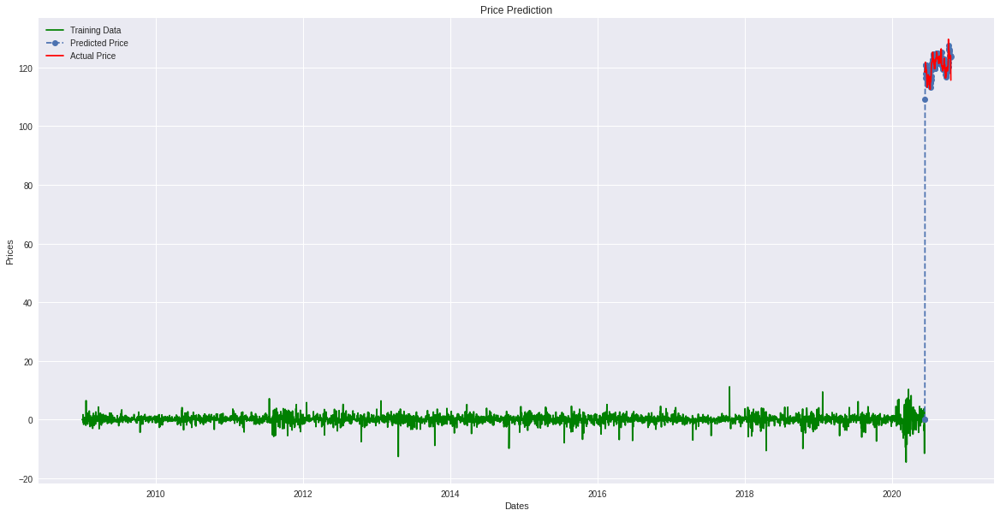

In [ ]:
 pred,rm=armodel(D_df,test_data)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_test.index,y=y_test['Adj Close'],
                    mode='lines',
                    name='Testing Data'))
  fig.add_trace(go.Scatter(x=y_test.index,y=pred[0],
                    mode='lines',
                    name='Predicted Price'))
  # Edit the layout
  fig.update_xaxes(tickformat="%B %d, %Y")
  fig.update_layout(title='Adjusted Close Price',
                   xaxis_title='Date',
                   yaxis_title='Adjusted Close Price')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_test['Adj Close'],y=pred[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(min(y_test['Adj Close'])),int(max(y_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for ARIMA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## DEEP LEARNING MODELING (LSTM MODEL)








<img src='https://compliance4all14.files.wordpress.com/2018/06/faces-moving-mirrored.gif'>

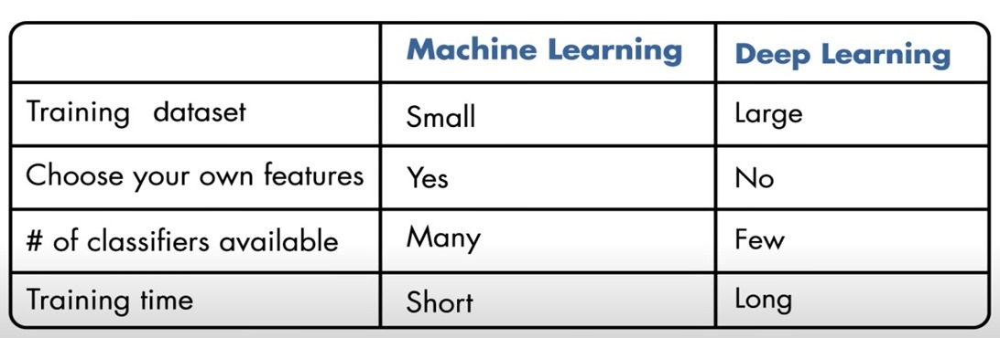

<image src='https://blog.exxactcorp.com/wp-content/uploads/2020/03/1.png'> <image src='https://miro.medium.com/max/1658/1*d7QeSREErtMuJQ0bcptMXQ.gif' width="400"/>

### LSTM MODEL

<image src='https://miro.medium.com/max/2250/1*goJVQs-p9kgLODFNyhl9zA.gif'>

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D
from tensorflow.keras.layers import Dense, Dropout, SimpleRNN, GRU, LSTM
from tensorflow.keras.callbacks import EarlyStopping,TensorBoard

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
X_train=np.array(X_train)
X_test=np.array(X_test)

In [ ]:
n_features = 1 # this is 1 because it is univariate data
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], n_features))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], n_features))

In [ ]:
# define what we need
n_steps = X_train.shape[1]
n_features = X_train.shape[2]

# define model
model = Sequential()
model.add((LSTM(64, return_sequences=True, activation='relu',
                input_shape=(n_steps, n_features))))
model.add(Dropout(0.1))
model.add((LSTM(32,activation='relu')))
model.add(Dropout(0.1))
model.add(Dense(32,activation='relu'))
model.add(Dropout(0.1))
model.add(Dense(1, activation='relu'))
model.summary()
model.compile(optimizer='adam', loss='mse',metrics=['mae'])

#tensorboard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


# fit model
history=model.fit(X_train, y_train, 
          epochs=100, 
          batch_size=5, 
          validation_data=(X_test, y_test), 
          verbose=1,
          callbacks=[tensorboard_callback],
          shuffle=True)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 9, 64)             16896     
_________________________________________________________________
dropout (Dropout)            (None, 9, 64)             0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense (Dense)                (None, 32)                1056      
_________________________________________________________________
dropout_2 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 3

In [ ]:
#!kill 626   #delete the previous port

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
predlstm = model.predict(X_test)# the pred

In [ ]:
predlstm=pd.DataFrame(predlstm)

In [ ]:
mse=metrics.mean_squared_error(y_test,predlstm)
rmselstm=np.sqrt(mse)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_test.index,y=y_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=y_test.index,y=predlstm[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LSTM MODEL',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

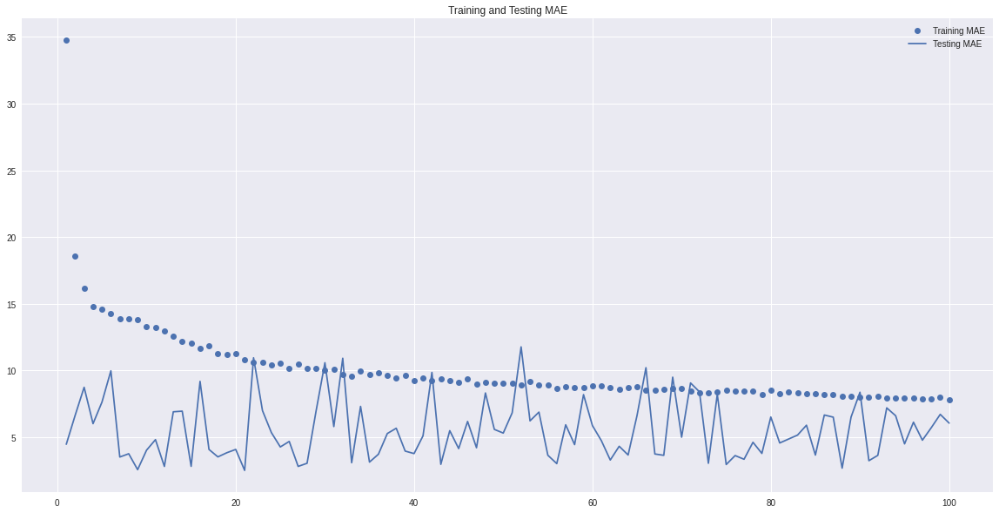

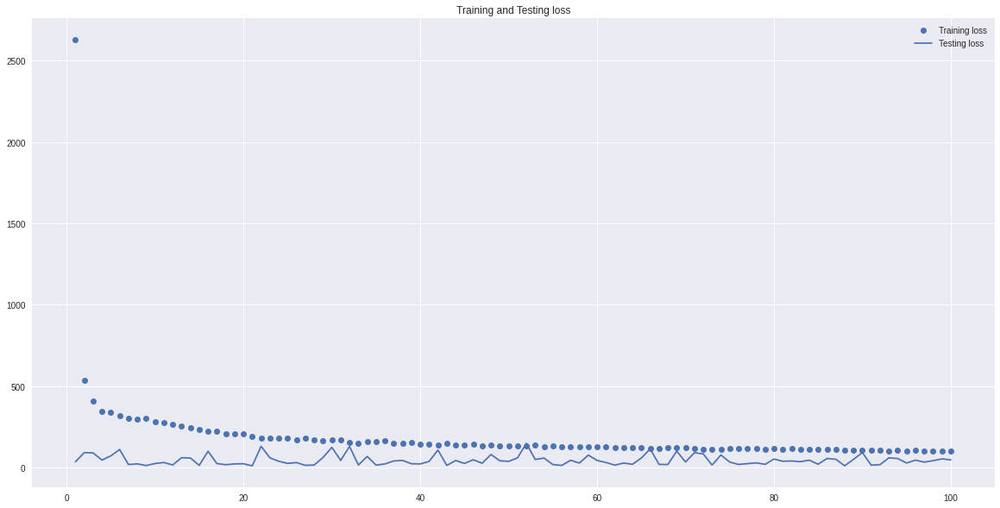

In [ ]:
import matplotlib.pyplot as plt

acc = history.history['mae']
val_acc = history.history['val_mae']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'bo', label='Training MAE')
plt.plot(epochs, val_acc, 'b', label='Testing MAE')
plt.title('Training and Testing MAE')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Testing loss')
plt.title('Training and Testing loss')
plt.legend()

plt.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_test['Adj Close'],y=predlstm[0],
                    mode='markers',
                    name='Actual Adjusted Close Price'))
  r=range(int(min(y_test['Adj Close'])),int(max(y_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LSTM MODEL Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

#ROOT MEAN SQUARE ERROR

In [ ]:
models=['LINEAR REGRESSION','LASSO REGRESSION','RIDGE REGRESSION','ELASTIC NET REGRESSION','DECISION TREE','KNN MODEL','SVR MODEL','NEURAL NETWORK','RANDOM FOREST MODEL','GRADIENT BOOSTING REGRESSOR']
rmpca=[rmse1p,rmse2p,rmse3p,rmse4p,rmse5p,rmse6p,rmse7p,rmse8p,rmse9p,rmse10p]
rmstep=[rmse1s,rmse2s,rmse3s,rmse4s,rmse5s,rmse6s,rmse7s,rmse8s,rmse9s,rmse10s]
RMSEML=pd.DataFrame(columns=['MODEL NAME','PCA RMSE','STEPWISE RMSE'])
RMSEML['MODEL NAME']=models
RMSEML['PCA RMSE']=rmpca
RMSEML['STEPWISE RMSE']=rmstep

In [ ]:
RMSEML

,MODEL NAME,PCA RMSE,STEPWISE RMSE
0,LINEAR REGRESSION,15.663087,15.803272
1,LASSO REGRESSION,15.654812,15.989037
2,RIDGE REGRESSION,15.662917,15.980093
3,ELASTIC NET REGRESSION,16.355683,16.758615
4,DECISION TREE,5.769894,5.171962
5,KNN MODEL,5.137788,5.199854
6,SVR MODEL,6.625771,7.760782
7,NEURAL NETWORK,5.077987,5.395558
8,RANDOM FOREST MODEL,4.846357,4.607390
9,GRADIENT BOOSTING REGRESSOR,5.209982,4.931058


In [ ]:
RMSEML[RMSEML['PCA RMSE']==np.min(RMSEML['PCA RMSE'])]

,MODEL NAME,PCA RMSE,STEPWISE RMSE
8,RANDOM FOREST MODEL,4.846357,4.60739


In [ ]:
RMSEML[RMSEML['STEPWISE RMSE']==np.min(RMSEML['STEPWISE RMSE'])]

,MODEL NAME,PCA RMSE,STEPWISE RMSE
8,RANDOM FOREST MODEL,4.846357,4.60739


In [ ]:
model=['ARIMA','LSTM MODEL']
rmts=[rm,rmselstm]
RMSETM=pd.DataFrame(columns=['MODEL NAME','RMSE'])
RMSETM['MODEL NAME']=model
RMSETM['RMSE']=rmts

In [ ]:
RMSETM

,MODEL NAME,RMSE
0,ARIMA,14.768649
1,LSTM MODEL,6.855533


In [ ]:
RMSETM[RMSETM['RMSE']==np.min(RMSETM['RMSE'])]

,MODEL NAME,RMSE
1,LSTM MODEL,6.855533


In [ ]:
RMSETM[RMSETM['RMSE']==np.min(RMSETM['RMSE'])]

,MODEL NAME,RMSE
1,LSTM MODEL,6.855533


## Stock Prediction for 21 OCT 2020

In [ ]:
predlstm.tail(2)

,0
128,116.933205
129,132.590363


In [ ]:
predlstm.tail(2)

,0
128,116.933205
129,132.590363


# RESULTS

* RANDOM FOREST MODEL IS THE BEST MODEL TO PREDICT THE MODEL. 
(ACCORDING TO RMSE OF THE MODEL)

* IBM'S ADJUSTED STOCK PRICE WILL INCREASE FOR THE 21 OCT 2020.

     (ACCORDING TO LSTM PREDICTION (MULTIVARIATE TIME SERIES MODEL))

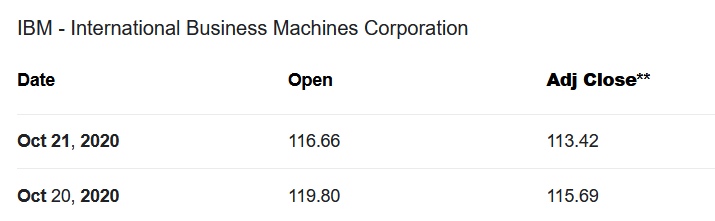

# MSFT

<image src='https://betanews.com/wp-content/uploads/2016/08/og-windows10.gif'>

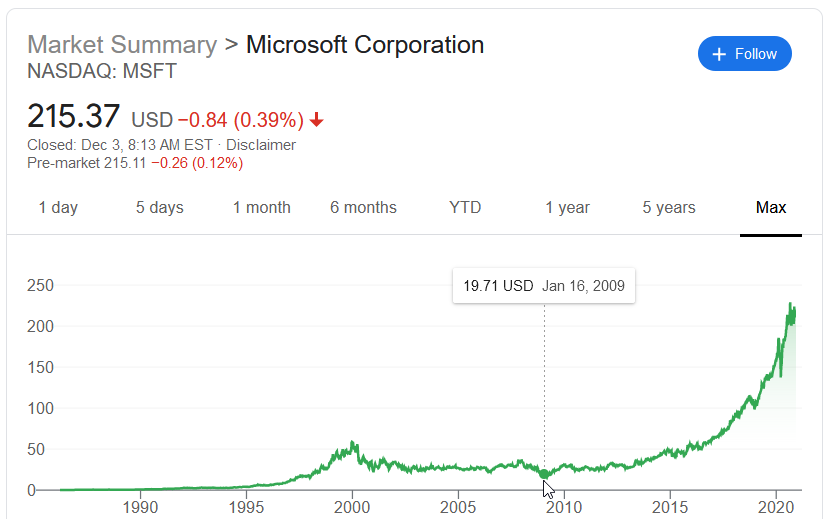

# Web Scrapping the stock data

In [ ]:

# mapping/ mounting the drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd
pd.core.common.is_list_like = pd.api.types.is_list_like
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
import pandas_datareader as pdr
import datetime 
from sklearn.preprocessing import MinMaxScaler
% matplotlib inline

In [ ]:
data = pdr.get_data_yahoo('MSFT',start='2009-01-01',end='2020-10-20')
data 

,High,Low,Open,Close,Volume,Adj Close
Date,,,,,,
2009-01-02,20.400000,19.370001,19.530001,20.330000,50084000.0,15.471161
2009-01-05,20.670000,20.059999,20.200001,20.520000,61475200.0,15.615757
2009-01-06,21.000000,20.610001,20.750000,20.760000,58083400.0,15.798391
2009-01-07,20.290001,19.480000,20.190001,19.510000,72709900.0,14.847140
2009-01-08,20.190001,19.549999,19.629999,20.120001,70255400.0,15.311348
...,...,...,...,...,...,...
2020-10-14,224.220001,219.130005,223.000000,220.860001,23451700.0,220.283279
2020-10-15,220.360001,216.009995,217.100006,219.660004,22733100.0,219.086426
2020-10-16,222.289993,219.320007,220.149994,219.660004,26057900.0,219.086426


#Imputation

In [ ]:
dt = datetime.date(2009, 1, 1)
end = datetime.date(2020,10,20)
day=pd.date_range(start=dt,end=end,freq='D')
temp=pd.DataFrame(day,columns=['Date'])

In [ ]:
temp=temp.set_index('Date',drop=True)

In [ ]:
temp

""
Date
2009-01-01
2009-01-02
2009-01-03
2009-01-04
2009-01-05
...
2020-10-16
2020-10-17
2020-10-18


In [ ]:
data=pd.concat([data,temp],axis=1)

In [ ]:
data

,High,Low,Open,Close,Volume,Adj Close
Date,,,,,,
2009-01-01,NaN,NaN,NaN,NaN,NaN,NaN
2009-01-02,20.400000,19.370001,19.530001,20.330000,50084000.0,15.471161
2009-01-03,NaN,NaN,NaN,NaN,NaN,NaN
2009-01-04,NaN,NaN,NaN,NaN,NaN,NaN
2009-01-05,20.670000,20.059999,20.200001,20.520000,61475200.0,15.615757
...,...,...,...,...,...,...
2020-10-16,222.289993,219.320007,220.149994,219.660004,26057900.0,219.086426
2020-10-17,NaN,NaN,NaN,NaN,NaN,NaN
2020-10-18,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
tmp1=pd.read_html('https://www.macrotrends.net/stocks/charts/MSFT/microsoft/total-assets')[1]
tmp2=pd.read_html('https://www.macrotrends.net/stocks/charts/MSFT/microsoft/total-liabilities')[1]
tmp3=pd.read_html('https://www.macrotrends.net/stocks/charts/MSFT/microsoft/gross-profit')[1]
tmp4=pd.read_html('https://www.macrotrends.net/stocks/charts/MSFT/microsoft/net-income')[1]
tmp5=pd.read_html('https://www.macrotrends.net/stocks/charts/MSFT/microsoft/revenue')[1]
tmp6=pd.read_html('https://www.macrotrends.net/stocks/charts/MSFT/microsoft/total-share-holder-equity')[1]
tmp7=pd.read_html('https://www.macrotrends.net/stocks/charts/MSFT/microsoft/long-term-debt')[1]
tmp8=pd.read_html('https://www.macrotrends.net/stocks/charts/MSFT/microsoft/cash-on-hand')[1]

In [ ]:
def comtmp(data,tmp1,name):
  tmp1.columns = np.arange(len(tmp1.columns))
  tmp1=tmp1.fillna('0')
  tmp1[0]=pd.to_datetime(tmp1[0], format='%Y-%m-%d')
  tmp1=tmp1[tmp1[0].dt.year>2008]
  tmp1[1] = tmp1[1].map(lambda x: x.lstrip('$,').rstrip(','))
  tmp1[1] = tmp1[1].map(lambda x: x.replace(',',''))
  tmp1=tmp1.set_index(0)
  tmp1[1]=tmp1[1].astype('float64')
  name=[name]
  tmp1.columns=name
  data=pd.concat([data,tmp1],axis=1)
  return data

In [ ]:
tmp7

,Microsoft Quarterly Long Term Debt(Millions of US $),Microsoft Quarterly Long Term Debt(Millions of US $).1
0,2020-09-30,"$57,055"
1,2020-06-30,"$59,578"
2,2020-03-31,"$62,862"
3,2019-12-31,"$63,361"
4,2019-09-30,"$66,478"
...,...,...
58,2006-03-31,NaN
59,2005-12-31,NaN
60,2005-09-30,NaN
61,2005-06-30,NaN


In [ ]:
data=comtmp(data,tmp1,'Total-assets')
data= comtmp(data,tmp2,'Total-liabilities')
data= comtmp(data,tmp3,'Gross-profit')
data= comtmp(data,tmp4,'Net-income')
data= comtmp(data,tmp5,'Revenue')
data= comtmp(data,tmp6,'Total-share-holder-equity')
data= comtmp(data,tmp7,'Long-term-debt')
data= comtmp(data,tmp8,'Cash-on-hand')

In [ ]:
data=data.ffill()
data=data.bfill()

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4311 entries, 2009-01-01 to 2020-10-20
Freq: D
Data columns (total 14 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   High                       4311 non-null   float64
 1   Low                        4311 non-null   float64
 2   Open                       4311 non-null   float64
 3   Close                      4311 non-null   float64
 4   Volume                     4311 non-null   float64
 5   Adj Close                  4311 non-null   float64
 6   Total-assets               4311 non-null   float64
 7   Total-liabilities          4311 non-null   float64
 8   Gross-profit               4311 non-null   float64
 9   Net-income                 4311 non-null   float64
 10  Revenue                    4311 non-null   float64
 11  Total-share-holder-equity  4311 non-null   float64
 12  Long-term-debt             4311 non-null   float64
 13  Cash-on-hand          

# EXPLORATORY DATA ANALYSIS

## Line Plots

No handles with labels found to put in legend.


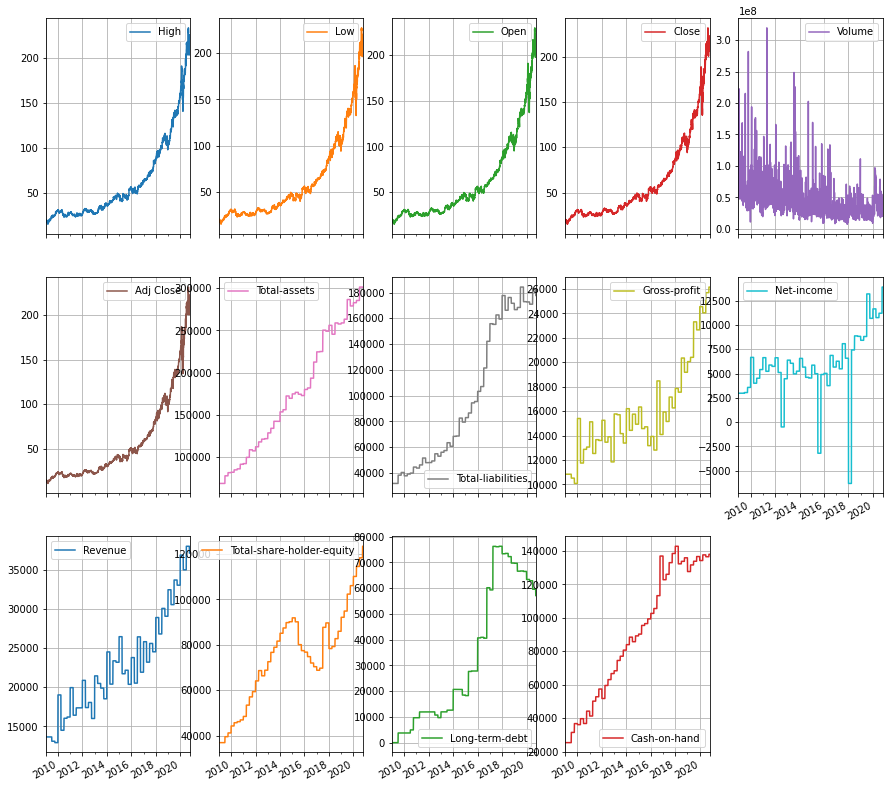

In [ ]:
data.plot(subplots=True,
        grid=True, 
        layout=(3,5),
         figsize=(15,15))
plt.legend(fontsize='xx-small')
plt.show()

## Candle plot

In [ ]:
fig = go.Figure(data=[go.Candlestick(
    x=data.index,
    open=data['Open'], high=data['High'],
    low=data['Low'], close=data['Close'],
    increasing_line_color= 'green', decreasing_line_color= 'red'
)])
fig.update_layout(
    title='Stock Market',
    yaxis_title='MSFT Stock')
fig.show() #There is a slider,You can zoom into dates by double click and slide the range.Check it out!Cool right! 

## Data Statistics

In [ ]:
data.describe().T 

,count,mean,std,min,25%,50%,75%,max
High,4311.0,6.298547e+01,4.776859e+01,1.562000e+01,2.874000e+01,4.420000e+01,8.372500e+01,2.328600e+02
Low,4311.0,6.176090e+01,4.665061e+01,1.487000e+01,2.812500e+01,4.339000e+01,8.278000e+01,2.273500e+02
Open,4311.0,6.240199e+01,4.725009e+01,1.520000e+01,2.850500e+01,4.388000e+01,8.321500e+01,2.292700e+02
Close,4311.0,6.240765e+01,4.725076e+01,1.515000e+01,2.846000e+01,4.390000e+01,8.318000e+01,2.316500e+02
Volume,4311.0,4.323762e+07,2.689555e+07,7.425600e+06,2.581970e+07,3.672790e+07,5.320115e+07,3.193179e+08
Adj Close,4311.0,5.816911e+01,4.849078e+01,1.160822e+01,2.305744e+01,3.924022e+01,7.966149e+01,2.310451e+02
Total-assets,4311.0,1.733294e+05,7.101177e+04,6.885300e+04,1.087040e+05,1.723840e+05,2.490970e+05,3.013110e+05
Total-liabilities,4311.0,9.858680e+04,5.416856e+04,3.191000e+04,4.812200e+04,8.260000e+04,1.626010e+05,1.842260e+05
Gross-profit,4311.0,1.586276e+04,3.807637e+03,1.007800e+04,1.338400e+04,1.512000e+04,1.755000e+04,2.615200e+04
Net-income,4311.0,5.790055e+03,3.386893e+03,-6.302000e+03,4.540000e+03,5.667000e+03,6.863000e+03,1.389300e+04


##Pair plot

In [ ]:
fig = px.scatter_matrix(data)
fig.update_layout(dragmode='select',
                  width=1000,
                  height=1000,
                  hovermode='closest',
                  font=dict(family="Courier New, monospace",size=7,color="RebeccaPurple"))
fig.show()

## Correlation Heat Map

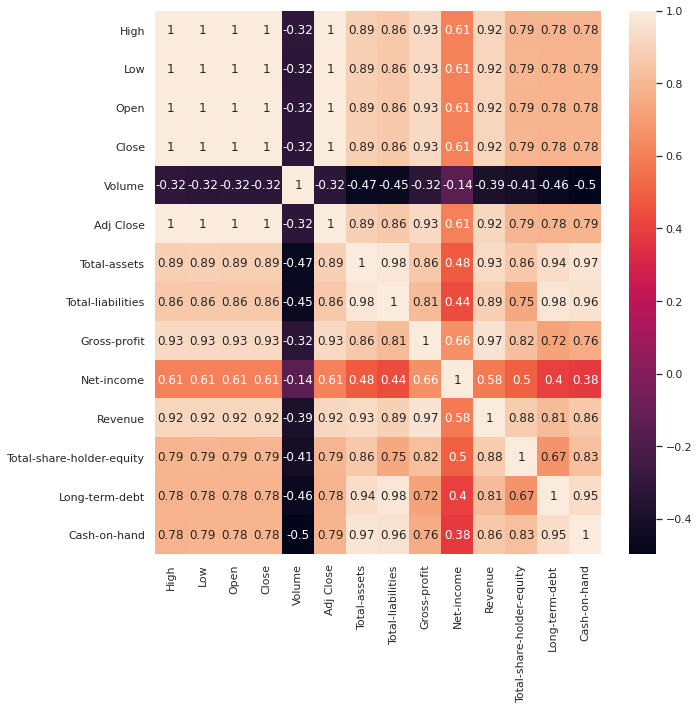

In [ ]:
corr1=data.corr(method='pearson')
sns.set(rc={'figure.figsize':(10,10)})
plot1=sns.heatmap(data=corr1, annot=True)
plot1

##Density plot

####Because the range of the dataset is large.

In [ ]:
#@title Choose 3 columns out of 14 columns and time interval to compare  

a = "High" #@param ['High', 'Low', 'Open', 'Close', 'Volume', 'Adj Close', 'Total-assets','Total-liabilities', 'Gross-profit', 'Net-income', 'Revenue','Total-share-holder-equity', 'Long-term-debt', 'Cash-on-hand']
b = "Open" #@param ['High', 'Low', 'Open', 'Close', 'Volume', 'Adj Close', 'Total-assets','Total-liabilities', 'Gross-profit', 'Net-income', 'Revenue','Total-share-holder-equity', 'Long-term-debt', 'Cash-on-hand']
c = "Adj Close" #@param ['High', 'Low', 'Open', 'Close', 'Volume', 'Adj Close', 'Total-assets','Total-liabilities', 'Gross-profit', 'Net-income', 'Revenue','Total-share-holder-equity', 'Long-term-debt', 'Cash-on-hand']
date = "2020-01-01" #@param {type:"string"}



In [ ]:
ar=data.loc[date:,[a,b,c]]

In [ ]:
fig = ff.create_distplot([ar[c] for c in ar.columns], ar.columns, bin_size=0.5)
fig.show()

## Pandas profiler

In [ ]:
#%pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
#profile1=ProfileReport(data)

In [ ]:
#profile1

In [ ]:
#data.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/uncleanMSFTbq.csv')

#Time Series Partition

# MSFT

In [ ]:
# Split data into X and Y
y = data['Adj Close']
X=data.drop(['Open','Close','Low','High','Adj Close'],axis=1)
print(data.shape, X.shape, y.shape)

(4311, 14) (4311, 9) (4311,)


In [ ]:
y=y.shift(-1,axis=0) # tomorrow's stock price
y=y.ffill()

In [ ]:
# split the data into train and test partitions
# we will use 50% of the data for train, and rest for validation
train_pct_index = int(0.97 * len(X))
X_train, X_test = X[:train_pct_index], X[train_pct_index:]
y_train, y_test = y[:train_pct_index], y[train_pct_index:]

In [ ]:
d_train, d_test = data[:train_pct_index], data[train_pct_index:]

In [ ]:
# X is still a 2D array
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(4181, 9) (4181,)
(130, 9) (130,)


In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler() # this like 2D data
X_train = scaler.fit_transform(X_train) # fit and transform
X_test = scaler.transform(X_test) # transform simply means APPLY the learned coordinate
print(X_train.shape, X_test.shape)

(4181, 9) (130, 9)


In [ ]:
# d_train = scaler.fit_transform(d_train) # fit and transform
# d_test = scaler.transform(d_test) # transform simply means APPLY the learned coordinate

In [ ]:
X_train=pd.DataFrame(X_train)
X_test=pd.DataFrame(X_test) 
y_train=pd.DataFrame(y_train)
y_test=pd.DataFrame(y_test) 

In [ ]:
d_train=pd.DataFrame(d_train,columns=data.columns)
d_test=pd.DataFrame(d_test,columns=data.columns) 

In [ ]:
# X_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/MSFTXtrain.csv')
# X_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/MSFTXtest.csv')
# y_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/MSFTYtrain.csv')
# y_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/MSFTYtest.csv') 

In [ ]:
# d_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/MSFTdatatrain.csv')
# d_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/TIME SERIES PARTITION DATA/MSFTdatatest.csv')

# MACHINE LEARNING DATA PARTITION

# Principal component analysis (PCA)

In [ ]:
from sklearn import decomposition

In [ ]:
pca = decomposition.PCA()
pca.fit(X)
Xpca = pca.transform(X)

# Feature Selection

In [ ]:
from sklearn.feature_selection import f_regression #Univariate linear regression test

In [ ]:
features=f_regression(X,y,center=True) #gives row 0 as f-value and row 1 as p-value
features=pd.DataFrame(features,columns=X.columns)
features.round(8) #round it to 6 decimal points I guess

,Volume,Total-assets,Total-liabilities,Gross-profit,Net-income,Revenue,Total-share-holder-equity,Long-term-debt,Cash-on-hand
0,496.291865,16445.87181,12736.708805,25759.552808,2494.421991,23252.418813,7162.719045,6810.011524,6983.616228
1,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [ ]:
for i in features.columns:
  if np.abs(features.loc[1,i])>0.05: #|p-value|(both sides of population mean) is less = good predictor
    del features[i]

In [ ]:
var1=features.columns

In [ ]:
Xstep=data.loc[:,var1]

# Partition

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
Xp_train, Xp_test, yp_train, yp_test=train_test_split(Xpca,y,test_size=0.2,random_state=123)

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler() # this like 2D data
Xp_train = scaler.fit_transform(Xp_train) # fit and transform
Xp_test = scaler.transform(Xp_test) # transform simply means APPLY the learned coordinate
print(Xp_train.shape, Xp_test.shape)

(3448, 9) (863, 9)


In [ ]:
Xp_train=pd.DataFrame(Xp_train)
Xp_test=pd.DataFrame(Xp_test) 
yp_train=pd.DataFrame(yp_train,columns=['Adj Close'])
yp_test=pd.DataFrame(yp_test,columns=['Adj Close']) 

In [ ]:
# Xp_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/PCA /MSFTXtrain.csv')
# Xp_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/PCA /MSFTXtest.csv')
# yp_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/PCA /MSFTYtrain.csv')
# yp_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/PCA /MSFTYtest.csv') 

In [ ]:
Xs_train, Xs_test, ys_train, ys_test=train_test_split(Xstep,y,test_size=0.2,random_state=123)

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler() # this like 2D data
Xs_train = scaler.fit_transform(Xs_train) # fit and transform
Xs_test = scaler.transform(Xs_test) # transform simply means APPLY the learned coordinate
print(Xs_train.shape, Xs_test.shape)

(3448, 9) (863, 9)


In [ ]:
Xs_train=pd.DataFrame(Xs_train,columns=var1)
Xs_test=pd.DataFrame(Xs_test,columns=var1)
ys_train=pd.DataFrame(ys_train,columns=['Adj Close'])
ys_test=pd.DataFrame(ys_test,columns=['Adj Close'])

In [ ]:
# Xs_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/Stepwise/MSFTXtrain.csv')
# Xs_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/Stepwise/MSFTXtest.csv')
# ys_train.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/Stepwise/MSFTYtrain.csv')
# ys_test.to_csv('/content/drive/Shareddrives/OPIM 5671: Data Mining and Business Intelligence/csv/MACHINE LEARNING PARTITION SG/Stepwise/MSFTYtest.csv') 

# MODELING

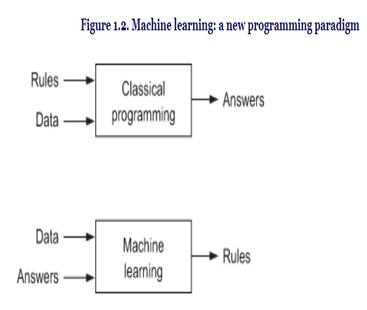

## LINEAR REGRESSION

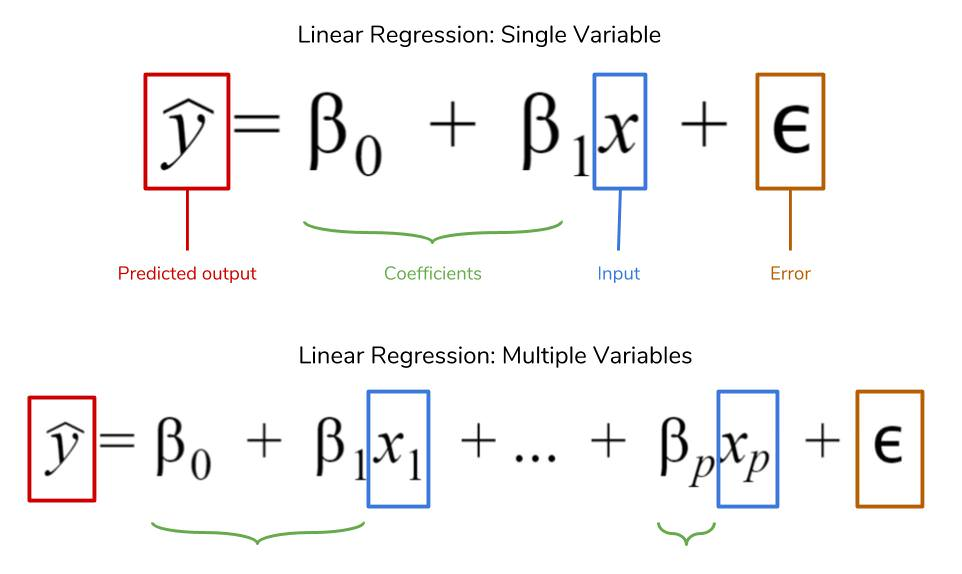

[Source](https://www.google.com/url?sa=i&url=https%3A%2F%2Fwww.dataquest.io%2Fblog%2Funderstanding-regression-error-metrics%2F&psig=AOvVaw2019KDLlyLArrHsMnJbpLi&ust=1606996048945000&source=images&cd=vfe&ved=0CAIQjRxqFwoTCNiC8ficr-0CFQAAAAAdAAAAABAD)

Linear regression quantifies the relationship between one or more predictor variable and one outcome variable. 

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn import metrics

In [ ]:
def linear(X1_train,X1_test,y1_train,y1_test):
  linear=LinearRegression()
  linear.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(linear.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse1=np.sqrt(mse)
  return y1_pred,rmse1


### Linear Regression PCA

In [ ]:
pred1p,rmse1p=linear(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred1p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred1p.index,y=pred1p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LINEAR REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred1p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LINEAR REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### Linear Regression Stepwise

In [ ]:
pred1s,rmse1s=linear(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred1s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred1s.index,y=pred1s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LINEAR REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred1s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LINEAR REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## LASSO REGRESSION

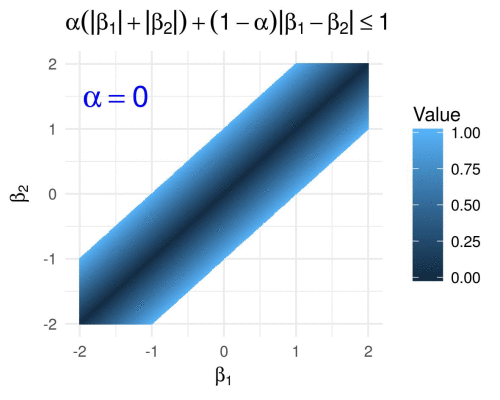

[Source](https://www.r-bloggers.com/2017/03/contours-of-statistical-penalty-functions-as-gif-images/)

Lasso regression is a type of linear regression that uses shrinkage.

In [ ]:
from sklearn.linear_model import Lasso

In [ ]:
def lasso(X1_train,X1_test,y1_train,y1_test):
  lasso=Lasso(alpha=0.1)
  lasso.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(lasso.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse2=np.sqrt(mse)
  return y1_pred,rmse2

### Lasso Regression PCA

In [ ]:
pred2p,rmse2p=lasso(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred2p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred2p.index,y=pred2p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LASSO REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred2p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LASSO REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### Lasso Regression Stepwise

In [ ]:
pred2s,rmse2s=lasso(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred2s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred2s.index,y=pred2s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LASSO REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred2s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LASSO REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## RIDGE REGRESSION

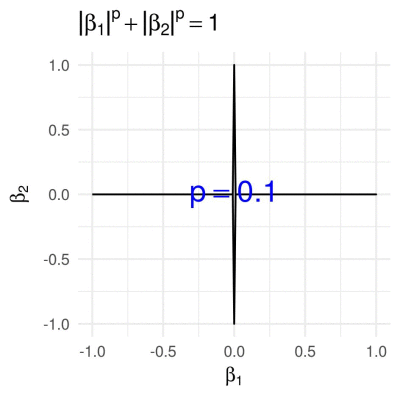

[Source](https://www.r-bloggers.com/2017/03/contours-of-statistical-penalty-functions-as-gif-images/)

In [ ]:
from sklearn.linear_model import Ridge

In [ ]:
def ridge(X1_train,X1_test,y1_train,y1_test):
  ridge = Ridge(alpha=1.0)
  ridge.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(ridge.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse3=np.sqrt(mse)
  return y1_pred,rmse3

### Ridge Regression PCA

In [ ]:
pred3p,rmse3p=ridge(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred3p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred3p.index,y=pred3p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='RIDGE REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred3p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for RIDGE REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### Ridge Regression Stepwise

In [ ]:
pred3s,rmse3s=ridge(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred3s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred3s.index,y=pred3s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='RIDGE REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred3s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for RIDGE REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## ELASTIC NET REGRESSION




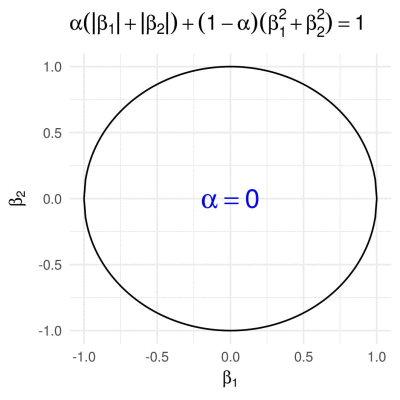

[Source](https://www.r-bloggers.com/2017/03/contours-of-statistical-penalty-functions-as-gif-images/)

The Elastic Net is a regularized regression method that linearly combines the L1 and L2 penalties of the lasso and ridge methods. 

In [ ]:
from sklearn.linear_model import ElasticNet

In [ ]:
def EN(X1_train,X1_test,y1_train,y1_test):
  EN=ElasticNet(random_state=123)
  EN.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(EN.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse4=np.sqrt(mse)
  return y1_pred,rmse4

### Elastic net Regression PCA

In [ ]:
pred4p,rmse4p=EN(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred4p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred4p.index,y=pred4p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='ELASTIC NET REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred4p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for ELASTIC NET REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### ELastic net Regression Stepwise

In [ ]:
pred4s,rmse4s=EN(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred4s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred4s.index,y=pred4s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='ELASTIC NET REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred4s[0],
                    mode='markers',
                    name='Actual Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for ELASTIC NET REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## DECISION TREE

<image src ='https://res.cloudinary.com/practicaldev/image/fetch/s--NOtmmf5a--/c_limit%2Cf_auto%2Cfl_progressive%2Cq_66%2Cw_880/https://twilio-cms-prod.s3.amazonaws.com/original_images/tree.gif' width="600"/>

Decision tree builds regression  models in the form of a tree structure.

In [ ]:
from sklearn.tree import DecisionTreeRegressor

In [ ]:
def DT(X1_train,X1_test,y1_train,y1_test):
  DT=DecisionTreeRegressor(random_state=123)
  DT.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(DT.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse5=np.sqrt(mse)
  return y1_pred,rmse5

### Decsion Tree PCA

In [ ]:
pred5p,rmse5p=DT(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred5p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred5p.index,y=pred5p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='DECISION TREE',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred5p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for DECISION TREE PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

###Decision Tree Stepwise

In [ ]:
pred5s,rmse5s=DT(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred5s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred5s.index,y=pred5s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='DECISION TREE',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred5s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for DECISION TREE STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## KNN MODEL

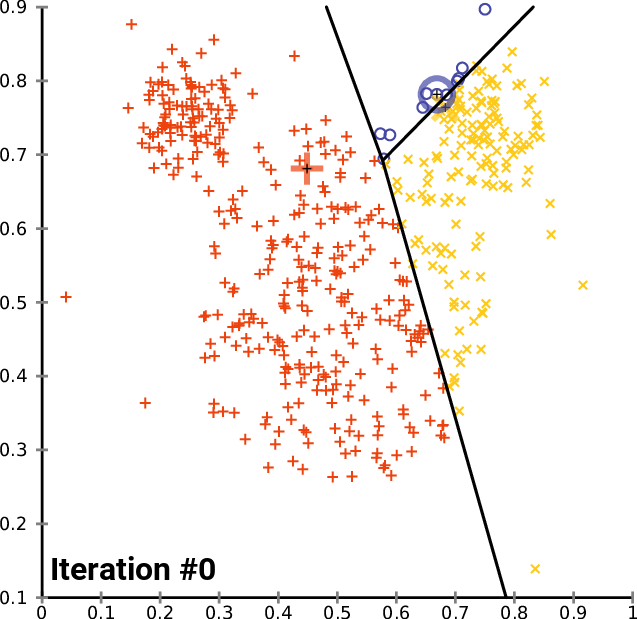

[Source](https://www.google.com/url?sa=i&url=https%3A%2F%2Fcommons.wikimedia.org%2Fwiki%2FFile%3AK-means_convergence.gif&psig=AOvVaw0Kfp-Mzjc2fKezrQfGGhLz&ust=1606999381908000&source=images&cd=vfe&ved=0CAIQjRxqFwoTCOD7nqypr-0CFQAAAAAdAAAAABAD)

K nearest neighbors is a simple algorithm that stores all available cases and predict the numerical target based on a similarity measure

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

In [ ]:
def KNN(X1_train,X1_test,y1_train,y1_test):
  KNN=KNeighborsRegressor()
  KNN.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(KNN.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse6=np.sqrt(mse)
  return y1_pred,rmse6


### KNN Regressor PCA

In [ ]:
pred6p,rmse6p=KNN(Xp_train,Xp_test,yp_train,yp_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred6p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred6p.index,y=pred6p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='KNN REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred6p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for KNN REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### KNN Regressor Stepwise

In [ ]:
pred6s,rmse6s=KNN(Xs_train,Xs_test,ys_train,ys_test)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred6s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred6s.index,y=pred6s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='KNN REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred6s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for KNN REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## SVR MODEL

In [ ]:
#@title
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from sklearn.svm import SVR

mesh_size = .02
margin = 0

df = px.data.iris()

X = df[['sepal_width', 'sepal_length']]
y = df['petal_width']

# Condition the model on sepal width and length, predict the petal width
model = SVR(C=1.)
model.fit(X, y)

# Create a mesh grid on which we will run our model
x_min, x_max = X.sepal_width.min() - margin, X.sepal_width.max() + margin
y_min, y_max = X.sepal_length.min() - margin, X.sepal_length.max() + margin
xrange = np.arange(x_min, x_max, mesh_size)
yrange = np.arange(y_min, y_max, mesh_size)
xx, yy = np.meshgrid(xrange, yrange)

# Run model
pred = model.predict(np.c_[xx.ravel(), yy.ravel()])
pred = pred.reshape(xx.shape)

# Generate the plot
fig = px.scatter_3d(df, x='sepal_width', y='sepal_length', z='petal_width')
fig.update_traces(marker=dict(size=5))
fig.add_traces(go.Surface(x=xrange, y=yrange, z=pred, name='pred_surface'))
fig.show()



[Source](https://plotly.com/python/ml-regression/#3d-regression-surface-with-pxscatter3d-and-gosurface)

 Support Vector Regression (SVR) applies the idea of SVM to predict real values rather than a class.

> SVR acknowledges the presence of non-linearity in the data and provides a proficient prediction model.



In [ ]:
from sklearn.svm import SVR

In [ ]:
def svm(X1_train,X1_test,y1_train,y1_test):
  svr=SVR(C=1.0, epsilon=0.2)
  svr.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(svr.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse7=np.sqrt(mse)
  return y1_pred,rmse7

### SVR Regression PCA

In [ ]:
pred7p,rmse7p=svm(Xp_train,Xp_test,yp_train,yp_test)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred7p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred7p.index,y=pred7p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='SVR REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred7p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for SVR REGRESSION PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### SVR Regression Stepwise

In [ ]:
pred7s,rmse7s=svm(Xs_train,Xs_test,ys_train,ys_test)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred7s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred7s.index,y=pred7s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='SVR REGRESSION',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred7s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for SVR REGRESSION STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## NEURAL NETWORK MODEL

<image src='https://raw.githubusercontent.com/mtoto/mtoto.github.io/master/data/2017-11-08-net/test_anim.gif'>





Neural networks are a set of algorithms, modeled loosely after the human brain, that are designed to recognize patterns.

In [ ]:
from sklearn.neural_network import MLPRegressor

In [ ]:
def NN(X1_train,X1_test,y1_train,y1_test):
  clf = MLPRegressor(random_state=123, max_iter=10000)
  clf.fit(X1_train,y1_train)
  y1_pred=pd.DataFrame(clf.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse8=np.sqrt(mse)
  return y1_pred,rmse8

### Neural Network PCA

In [ ]:
pred8p,rmse8p=NN(Xp_train,Xp_test,yp_train,yp_test)

/usr/local/lib/python3.6/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1342: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred8p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred8p.index,y=pred8p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='NEURAL NETWORK',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred8p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for NEURAL NETWORK PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### Neural Network Stepwise

In [ ]:
pred8s,rmse8s=NN(Xs_train,Xs_test,ys_train,ys_test)

/usr/local/lib/python3.6/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1342: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred8s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred8s.index,y=pred8s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='NEURAL NETWORK',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred8s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for NEURAL NETWORK STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

## ENSEMBLE MODELS

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

![alt text](https://miro.medium.com/max/1280/1*9kACduxnce_JdTrftM_bsA.gif)

![alt text](https://miro.medium.com/max/900/1*IFoOIqlshjtQ34BpsLsIrg.gif)

![alt text](https://thumbs.gfycat.com/RigidFantasticBlackfly-size_restricted.gif)

### RANDOM FOREST MODEL

In [ ]:
def E1(X1_train,X1_test,y1_train,y1_test):
  clf = RandomForestRegressor(random_state=123)
  clf.fit(X1_train, y1_train)
  y1_pred=pd.DataFrame(clf.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse9=np.sqrt(mse)
  return y1_pred,rmse9

#### Random Forest Model PCA

In [ ]:
pred9p,rmse9p=E1(Xp_train,Xp_test,yp_train,yp_test)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred9p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred9p.index,y=pred9p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='RANDOM FOREST MODEL',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred9p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for RANDOM FOREST MODEL PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

####  Random Forest Model Stepwise

In [ ]:
pred9s,rmse9s=E1(Xs_train,Xs_test,ys_train,ys_test)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred9s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred9s.index,y=pred2s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='RANDOM FOREST MODEL',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred9s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for RANDOM FOREST MODEL STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

### GRADIENT BOOSTING REGRESSOR MODEL

In [ ]:
def E2(X1_train,X1_test,y1_train,y1_test):
  clf = GradientBoostingRegressor(random_state=123)
  clf.fit(X1_train, y1_train)
  y1_pred=pd.DataFrame(clf.predict(X1_test))
  mse=metrics.mean_squared_error(y1_test,y1_pred)
  rmse10=np.sqrt(mse)
  return y1_pred,rmse10

#### Gradient Boosting Regressor PCA

In [ ]:
pred10p,rmse10p=E2(Xp_train,Xp_test,yp_train,yp_test)

/usr/local/lib/python3.6/dist-packages/sklearn/ensemble/_gb.py:1454: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred10p.index,y=yp_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred10p.index,y=pred10p[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='GRADIENT BOOSTING REGRESSOR',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=yp_test['Adj Close'],y=pred10p[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(yp_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for GRADIENT BOOSTING REGRESSOR PCA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

#### Gradient Boosting Regressor Stepwise

In [ ]:
pred10s,rmse10s=E2(Xs_train,Xs_test,ys_train,ys_test)

/usr/local/lib/python3.6/dist-packages/sklearn/ensemble/_gb.py:1454: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=pred10s.index,y=ys_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=pred10s.index,y=pred10s[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='GRADIENT BOOSTING REGRESSOR',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=ys_test['Adj Close'],y=pred10s[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(max(ys_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict( width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for GRADIENT BOOSTING REGRESSOR STEPWISE Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

# TIME SERIES MODELS 

![alt text](https://i.pinimg.com/originals/57/2f/8c/572f8cbe4c9f69c217bdc33b82eb0c28.gif)

## ARIMA MODEL

In [ ]:
 train_data, test_data = data['Adj Close'][0:int(len(data)*0.97)], data['Adj Close'][int(len(data)*0.97)-1:]

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf  #autocorrelation
from statsmodels.tsa.stattools import adfuller as ADF  # stable test
from statsmodels.graphics.tsaplots import plot_pacf    #pacf
from statsmodels.stats.diagnostic import acorr_ljungbox    #white noise
from statsmodels.tsa.arima_model import ARIMA

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



### STATIONARITY TEST

A TimeSeries is said to be stationary if its statistical properties such as mean variance remain constant over time.

In [ ]:
plt.clf()
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 20,10
params = {'legend.fontsize': 'x-large',
            'axes.labelsize': 'x-large',
          'axes.titlesize':'x-large',
          'xtick.labelsize':'x-large',
          'ytick.labelsize':'x-large'}
rcParams.update(params)

<Figure size 720x720 with 0 Axes>

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_train.index,y=y_train['Adj Close'],
                    mode='lines',
                    name='Training Data'))
  fig.add_trace(go.Scatter(x=y_test.index,y=y_test['Adj Close'],
                    mode='lines',
                    name='Testing Data'))
  # Edit the layout
  fig.update_xaxes(tickformat="%B %d, %Y",rangeslider_visible=True, rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    ))
  fig.update_layout(title='Adjusted Close Price',
                   xaxis_title='Date',
                   yaxis_title='Adjusted Close Price')
  fig.show()

In [ ]:
from statsmodels.tsa.stattools import adfuller

In [ ]:
def test_stationarity(timeseries):
    #Determing rolling statistics
    rolmean = pd.Series(timeseries).rolling(window=12).mean()
    rolstd = pd.Series(timeseries).rolling(window=12).std()

    #Plot rolling statistics:
    plt.style.use('seaborn')
    rcParams['figure.figsize'] = 20,10
    orig = plt.plot(timeseries,label='Original')
    mean = plt.plot(rolmean, label='Rolling Mean')
    std = plt.plot(rolstd, label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey-Fuller test:
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

Results of Dickey-Fuller Test:
Test Statistic                    3.551955
p-value                           1.000000
#Lags Used                       31.000000
Number of Observations Used    4149.000000
Critical Value (1%)              -3.431927
Critical Value (5%)              -2.862237
Critical Value (10%)             -2.567141
dtype: float64


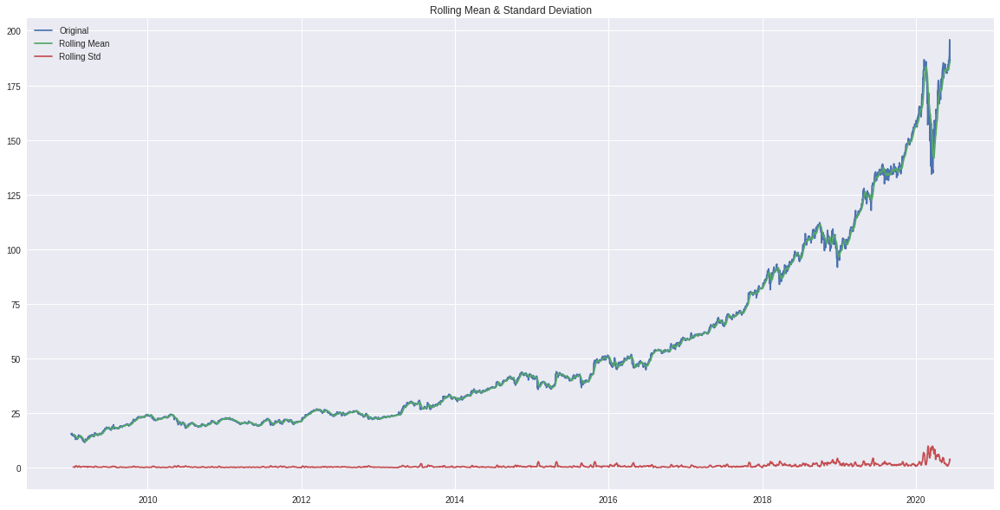

In [ ]:
test_stationarity(train_data)

Not stationary, the test statistic is way more than the critical values, p-value is too big.

Try to make it Stationary

Results of Dickey-Fuller Test:
Test Statistic                -1.237661e+01
p-value                        5.138769e-23
#Lags Used                     3.100000e+01
Number of Observations Used    4.148000e+03
Critical Value (1%)           -3.431927e+00
Critical Value (5%)           -2.862237e+00
Critical Value (10%)          -2.567141e+00
dtype: float64


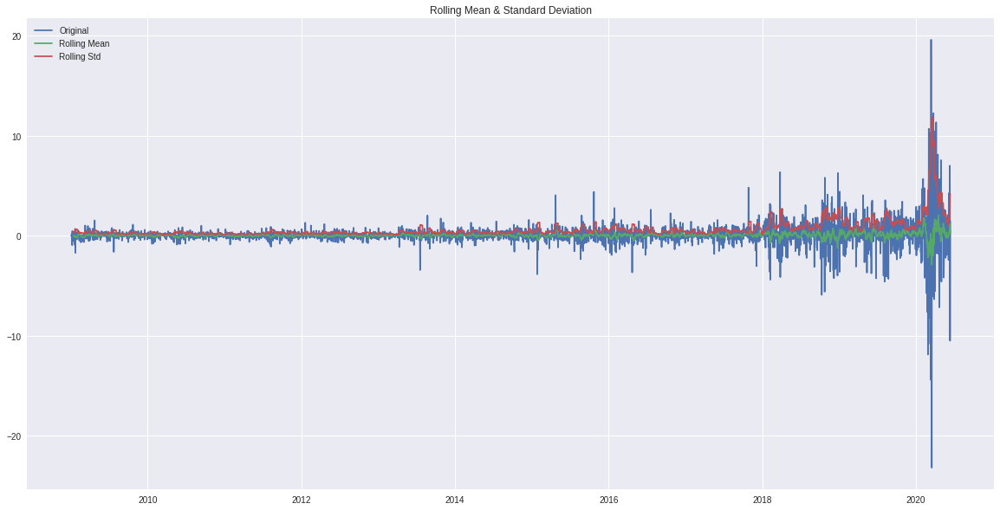

In [ ]:
D_df = train_data.diff().dropna()
test_stationarity(D_df)
D_df=pd.DataFrame(D_df)
D_df.columns = ['df diff']

### STABILITY TEST

In [ ]:
#After First order difference, it shows stable fluctuation, it has strong Short-term correlation,
ADF_D_df_p =ADF(D_df['df diff'])[1]
print("p-value of first order difference sequence adf test is "+str(ADF_D_df_p))
#the unit root test p value is less than 0.05,
#so the sequence after the first order difference is a stable sequence

p-value of first order difference sequence adf test is 5.138769138170212e-23


### ACF AND PACF 

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf  #autocorrelation
from statsmodels.tsa.stattools import adfuller as ADF  # stable test
from statsmodels.graphics.tsaplots import plot_pacf    #pacf
from statsmodels.stats.diagnostic import acorr_ljungbox    #white noise
from statsmodels.tsa.arima_model import ARIMA

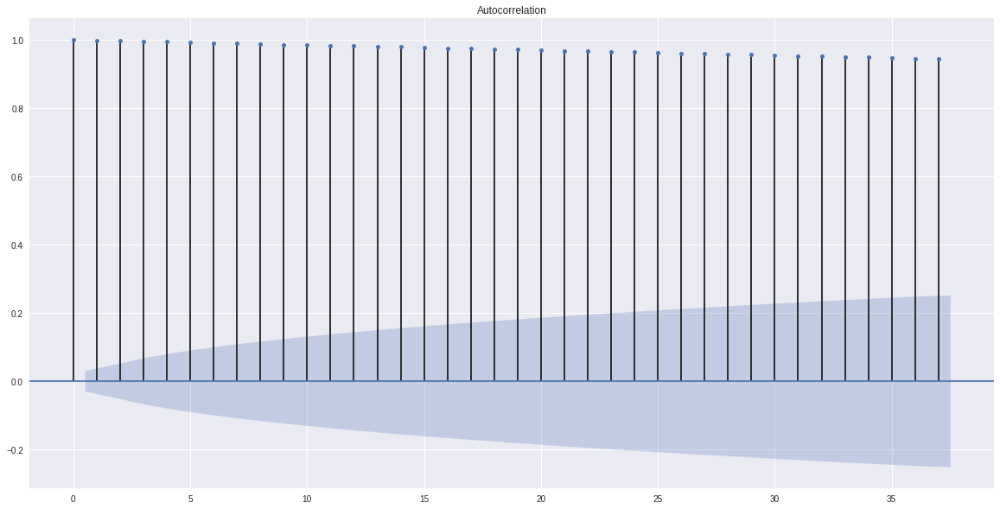

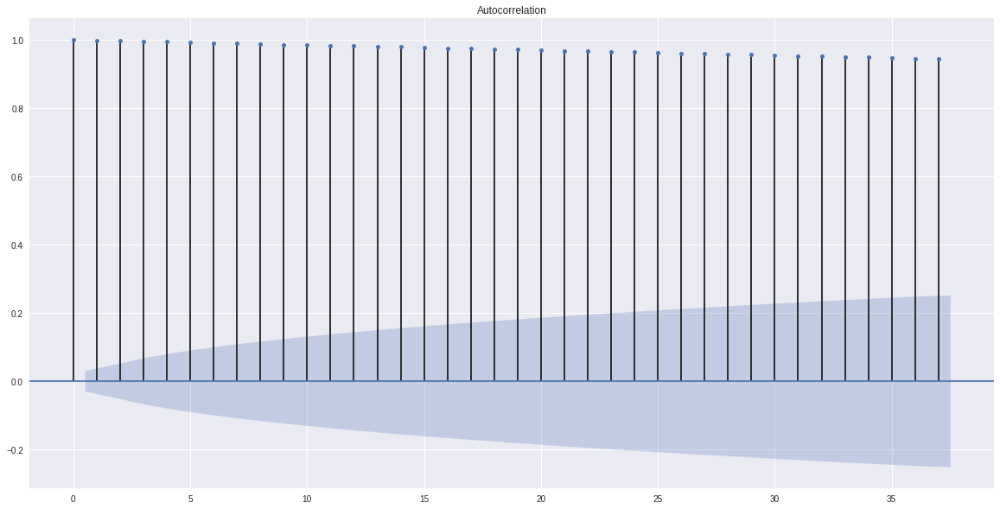

In [ ]:
plot_acf(train_data)

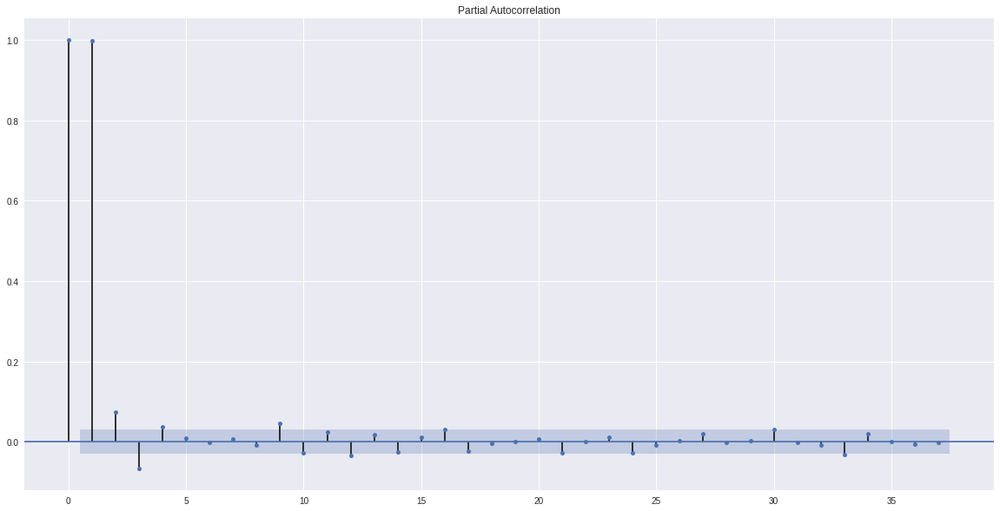

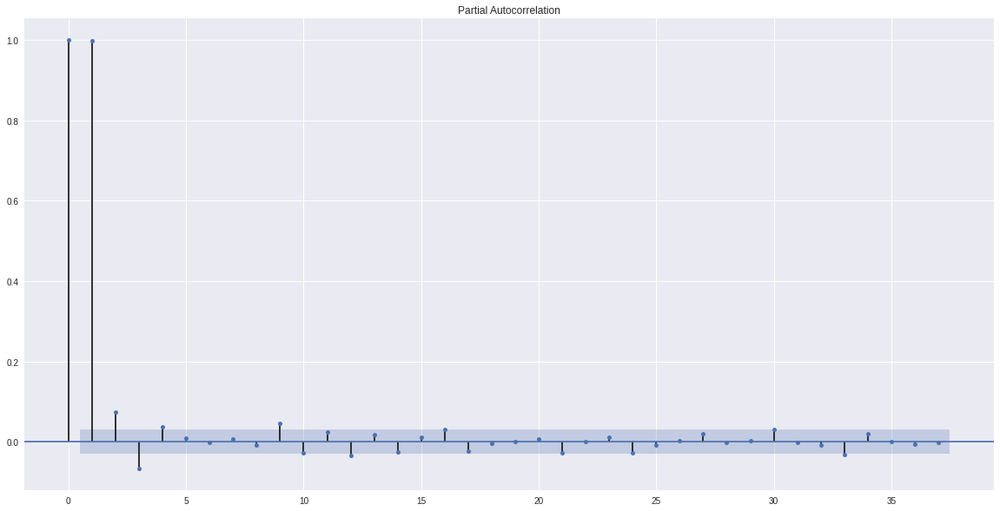

In [ ]:
plot_pacf(train_data)

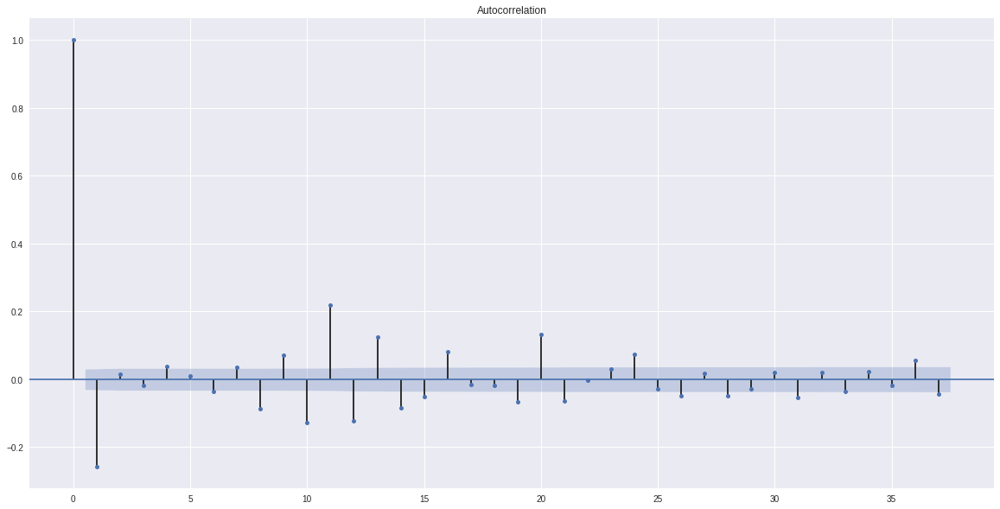

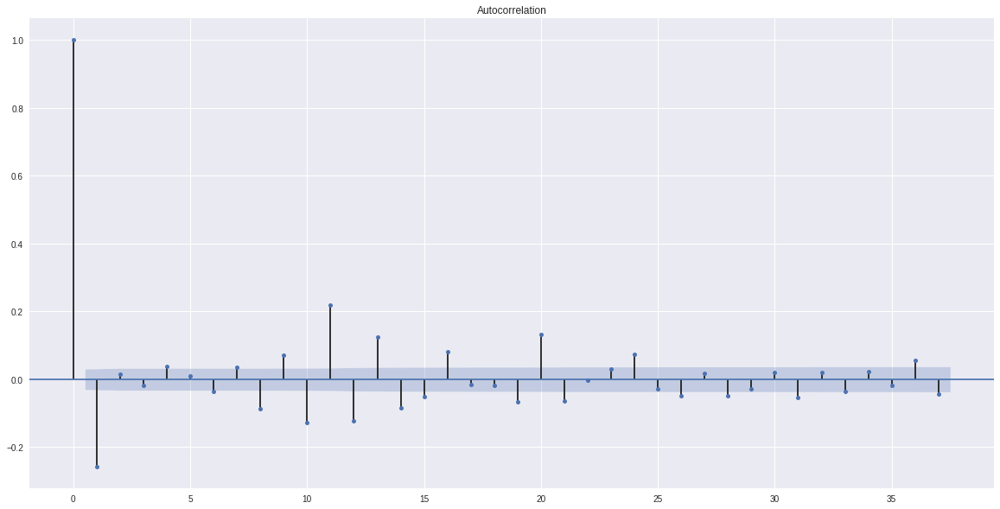

In [ ]:
plot_acf(D_df) 

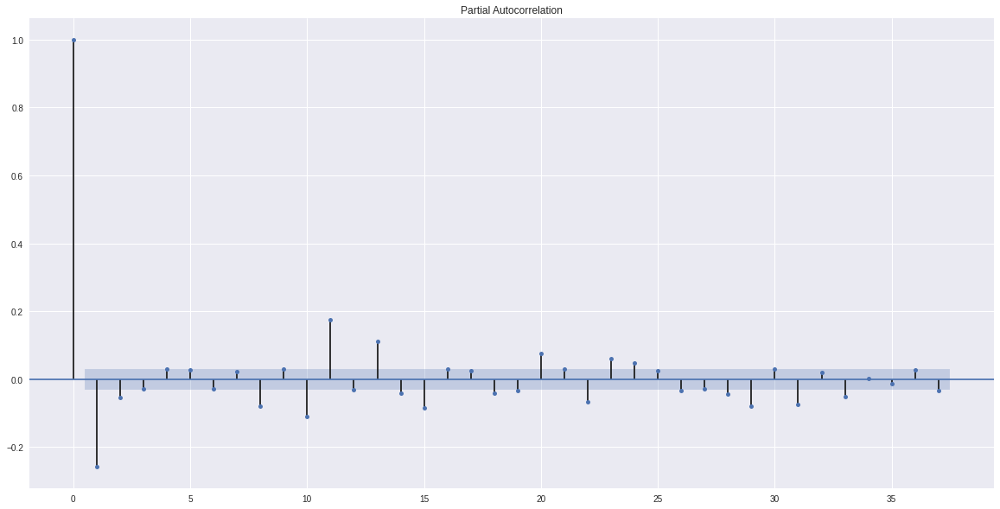

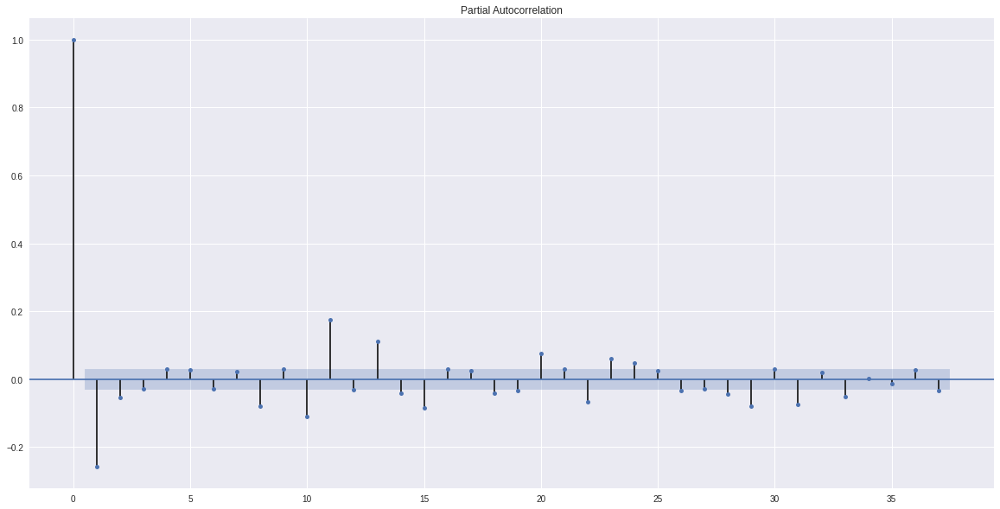

In [ ]:
plot_pacf(D_df)

### WHITE NOISE TEST

In [ ]:
from statsmodels.tsa.stattools import acf, pacf
from scipy.ndimage.interpolation import shift
from statsmodels.tsa.arima_model import ARIMA

In [ ]:
wn=acorr_ljungbox(D_df, lags=1)
print("The p-value of White Noise test of first order difference is "+ str(wn[1][0]))
#<0.05 stable and not white noise

The p-value of White Noise test of first order difference is 2.5726371773182953e-62


### AUTO-ARIMA

In [ ]:
from statsmodels.tsa.arima_model import ARIMA

In [ ]:
!pip install pyramid-arima
from pyramid.arima import auto_arima

/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning:

The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).

/usr/local/lib/python3.6/dist-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning:

sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.

/usr/local/lib/python3.6/dist-packages/pyramid/__init__.py:68: UserWarning:


    The 'pyramid' package will be migrating to a new namespace beginning in 
    version 1.0.0: 'pmdarima'. This is due to a package name collision with the
    Pyramid web framework. For more information, see Issue #34:
    
        https:/

In [ ]:
def armodel(train_data,test_data):
    aa=auto_arima(train_data,start_p=0, start_q=0, max_p=0, max_q=1,m=1,start_P=1,start_Q=1,seasonal=True,d=1, D=1, trace=True,error_action='ignore',  suppress_warnings=True, stepwise=True)
    train_ar = train_data.values
    test_ar = test_data.values
    history = [x for x in train_ar]
    print(history)
    predictions = list()
    for t in range(len(test_ar)):
      model = ARIMA(history,order=(aa.order))
      model_fit = model.fit()
      output = model_fit.forecast()
      yhat = output[0]
      predictions.append(yhat)
      obs = test_ar[t]
      history.append(obs)
    error = metrics.mean_squared_error(test_ar, predictions)
    rmse=np.sqrt(error)
    plt.plot(train_data,color='green', label='Training Data')
    plt.plot(test_data.index, predictions, marker='o', linestyle='dashed', 
    label='Predicted Price')
    plt.plot(test_data.index, test_data, color='red', label='Actual Price')
    plt.title('Price Prediction')
    plt.xlabel('Dates')
    plt.ylabel('Prices')
    plt.legend()
    plt.show()
    predictions=pd.DataFrame(predictions)
    return predictions,rmse

Fit ARIMA: order=(0, 1, 0) seasonal_order=(0, 0, 0, 1); AIC=16801.616, BIC=16814.292, Fit time=0.086 seconds
Fit ARIMA: order=(0, 1, 1) seasonal_order=(0, 0, 0, 1); AIC=12953.458, BIC=12972.472, Fit time=3.854 seconds
Total fit time: 3.944 seconds
[array([0.]), array([0.]), array([0.]), array([0.1445961]), array([0.18263435]), array([-0.95125103]), array([0.46420765]), array([-0.4566021]), array([0.]), array([0.]), array([-0.0380497]), array([0.2663517]), array([-0.5555315]), array([0.11414909]), array([0.35767365]), array([0.]), array([0.]), array([0.]), array([-0.93603516]), array([0.68490314]), array([-1.72746944]), array([0.06848335]), array([0.]), array([0.]), array([0.32723141]), array([0.02283001]), array([0.28918552]), array([-0.34245205]), array([-0.37288857]), array([0.]), array([0.]), array([0.55552864]), array([0.50987053]), array([0.0989275]), array([0.31201267]), array([0.47182465]), array([0.]), array([0.]), array([-0.16742134]), array([-0.4870491]), array([0.31201458]),

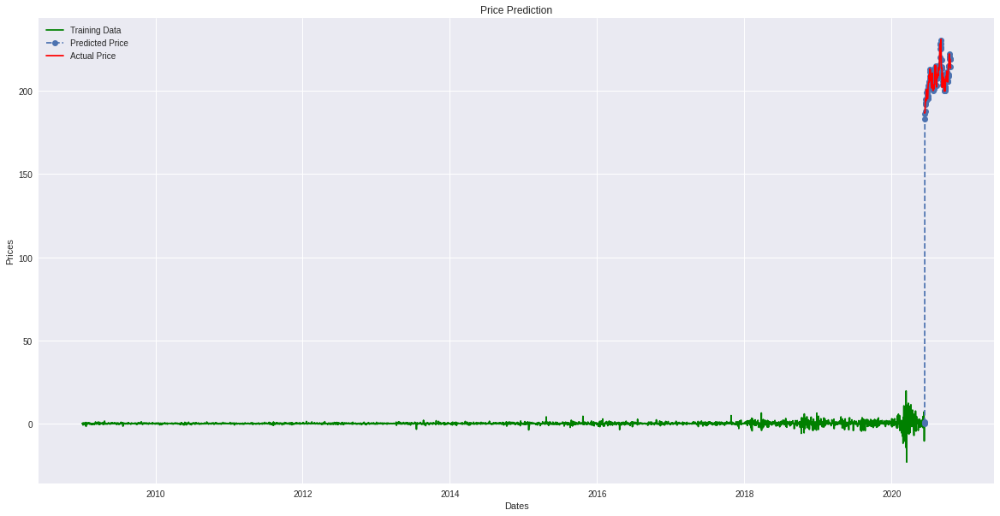

In [ ]:
 pred,rm=armodel(D_df,test_data)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_test.index,y=y_test['Adj Close'],
                    mode='lines',
                    name='Testing Data'))
  fig.add_trace(go.Scatter(x=y_test.index,y=pred[0],
                    mode='lines',
                    name='Predicted Price'))
  # Edit the layout
  fig.update_xaxes(tickformat="%B %d, %Y")
  fig.update_layout(title='Adjusted Close Price',
                   xaxis_title='Date',
                   yaxis_title='Adjusted Close Price')
  fig.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_test['Adj Close'],y=pred[0],
                    mode='markers',
                    name='Adjusted Close Price'))
  r=range(int(np.min(y_test['Adj Close'])),int(np.max(y_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for ARIMA Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

# DEEP LEARNING MODELING (LSTM MODEL)








<img src='https://compliance4all14.files.wordpress.com/2018/06/faces-moving-mirrored.gif'>

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D
from tensorflow.keras.layers import Dense, Dropout, SimpleRNN, GRU, LSTM
from tensorflow.keras.callbacks import EarlyStopping,TensorBoard

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
X_train=np.array(X_train)
X_test=np.array(X_test)

In [ ]:
n_features = 1 # this is 1 because it is univariate data
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], n_features))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], n_features))

In [ ]:
# define what we need
n_steps = X_train.shape[1]
n_features = X_train.shape[2]

# define model
model = Sequential()
model.add((LSTM(64, return_sequences=True, activation='relu',
                input_shape=(n_steps, n_features))))
model.add(Dropout(0.1))
model.add((LSTM(32,activation='relu')))
model.add(Dropout(0.1))
model.add(Dense(32,activation='relu'))
model.add(Dropout(0.1))
model.add(Dense(1, activation='relu'))
model.summary()
model.compile(optimizer='adam', loss='mse',metrics=['mae'])

#tensorboard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


# fit model
history=model.fit(X_train, y_train, 
          epochs=100, 
          batch_size=5, 
          validation_data=(X_test, y_test), 
          verbose=1,
          callbacks=[tensorboard_callback],
          shuffle=True)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 9, 64)             16896     
_________________________________________________________________
dropout (Dropout)            (None, 9, 64)             0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense (Dense)                (None, 32)                1056      
_________________________________________________________________
dropout_2 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 3

In [ ]:
#!kill 626   #delete the previous port

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
predlstm = model.predict(X_test)# the pred

In [ ]:
predlstm=pd.DataFrame(predlstm)

In [ ]:
mse=metrics.mean_squared_error(y_test,predlstm)
rmselstm=np.sqrt(mse)

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_test.index,y=y_test['Adj Close'],
                    mode='lines',
                    name='Actual Adjusted Close Price'))
  fig.add_trace(go.Scatter(x=y_test.index,y=predlstm[0],
                    mode='lines+markers',
                    name='Prediction'))
  # Edit the layout
  fig.update_layout(title='LSTM MODEL',
                   xaxis_title='Time',
                   yaxis_title='Adjusted Close Prices')
  fig.show()

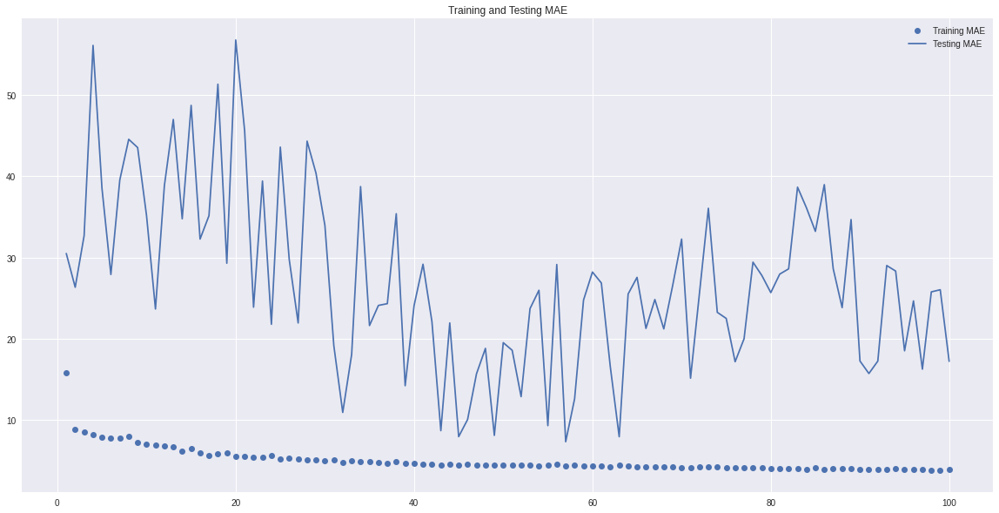

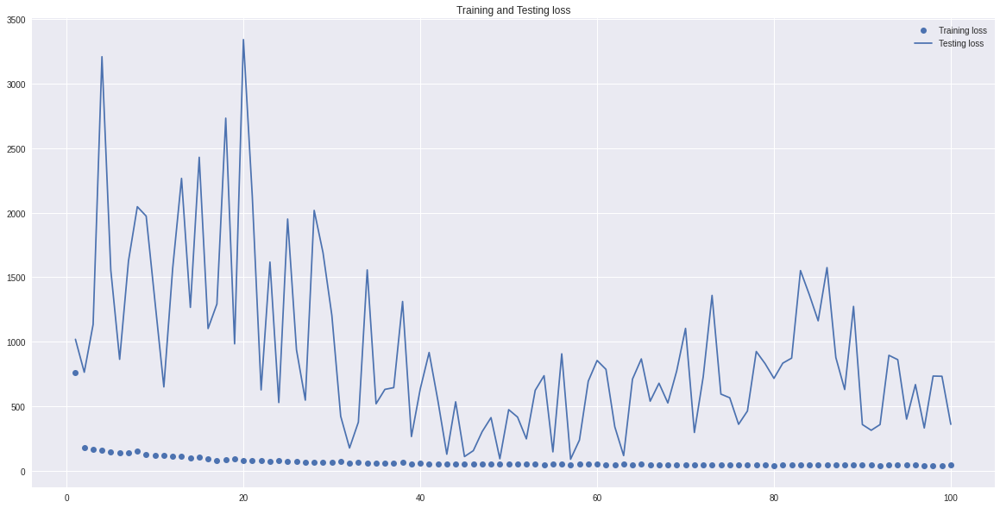

In [ ]:
import matplotlib.pyplot as plt

acc = history.history['mae']
val_acc = history.history['val_mae']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'bo', label='Training MAE')
plt.plot(epochs, val_acc, 'b', label='Testing MAE')
plt.title('Training and Testing MAE')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Testing loss')
plt.title('Training and Testing loss')
plt.legend()

plt.show()

In [ ]:
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=y_test['Adj Close'],y=predlstm[0],
                    mode='markers',
                    name='Actual Adjusted Close Price'))
  r=range(int(np.min(y_test['Adj Close'])),int(np.max(y_test['Adj Close'])))
  r=np.array(r)
  fig.add_trace(go.Scatter(x=r,y=r,
                    mode='lines',
                    line = dict(color='firebrick', width=4, dash='dashdot'),
                    name='Actual=Predicted'))
  # Edit the layout
  fig.update_layout(title='Actual vs. Predicted for LSTM MODEL Testing set',
                   xaxis_title='Actual Test Ladder Score',
                   yaxis_title='Predicted Test Ladder Score')
  fig.show()

#ROOT MEAN SQUARE ERROR COMPARISON

In [ ]:
models=['LINEAR REGRESSION','LASSO REGRESSION','RIDGE REGRESSION','ELASTIC NET REGRESSION','DECISION TREE','KNN MODEL','SVR MODEL','NEURAL NETWORK','RANDOM FOREST MODEL','GRADIENT BOOSTING REGRESSOR']
rmpca=[rmse1p,rmse2p,rmse3p,rmse4p,rmse5p,rmse6p,rmse7p,rmse8p,rmse9p,rmse10p]
rmstep=[rmse1s,rmse2s,rmse3s,rmse4s,rmse5s,rmse6s,rmse7s,rmse8s,rmse9s,rmse10s]
RMSEML=pd.DataFrame(columns=['MODEL NAME','PCA RMSE','STEPWISE RMSE'])
RMSEML['MODEL NAME']=models
RMSEML['PCA RMSE']=rmpca
RMSEML['STEPWISE RMSE']=rmstep

In [ ]:
RMSEML

,MODEL NAME,PCA RMSE,STEPWISE RMSE
0,LINEAR REGRESSION,11.948579,11.950719
1,LASSO REGRESSION,11.961457,12.056354
2,RIDGE REGRESSION,11.948586,11.940150
3,ELASTIC NET REGRESSION,19.199519,17.598056
4,DECISION TREE,4.599606,3.165121
5,KNN MODEL,3.341843,3.163954
6,SVR MODEL,9.453431,9.025827
7,NEURAL NETWORK,3.277554,3.563150
8,RANDOM FOREST MODEL,4.056202,2.856618
9,GRADIENT BOOSTING REGRESSOR,3.854323,3.090924


In [ ]:
RMSEML[RMSEML['PCA RMSE']==np.min(RMSEML['PCA RMSE'])]

,MODEL NAME,PCA RMSE,STEPWISE RMSE
7,NEURAL NETWORK,3.277554,3.56315


In [ ]:
RMSEML[RMSEML['STEPWISE RMSE']==np.min(RMSEML['STEPWISE RMSE'])]

,MODEL NAME,PCA RMSE,STEPWISE RMSE
8,RANDOM FOREST MODEL,4.056202,2.856618


In [ ]:
model=['ARIMA','LSTM MODEL']
rmts=[rm,rmselstm]
RMSETM=pd.DataFrame(columns=['MODEL NAME','RMSE'])
RMSETM['MODEL NAME']=model
RMSETM['RMSE']=rmts

In [ ]:
RMSETM

,MODEL NAME,RMSE
0,ARIMA,23.256582
1,LSTM MODEL,18.961283


In [ ]:
RMSETM[RMSETM['RMSE']==np.min(RMSETM['RMSE'])]

,MODEL NAME,RMSE
1,LSTM MODEL,18.961283


In [ ]:
RMSETM[RMSETM['RMSE']==np.min(RMSETM['RMSE'])]

,MODEL NAME,RMSE
1,LSTM MODEL,18.961283


## Stock Prediction for 21 OCT 2020

In [ ]:
predlstm.tail(2)

,0
128,200.283417
129,200.656586


In [ ]:
predlstm.tail(2)

,0
128,200.283417
129,200.656586


# RESULTS

* NEURAL NETWORK MODEL IS THE BEST MODEL TO PREDICT THE MODEL WITH PRINCIPLE COMPONENT ANALYSIS FEATURE SELECTION. 
(ACCORDING TO RMSE OF THE MODEL)
* RANDOM FOREST MODEL IS THE BEST MODEL TO PREDICT THE MODEL WITH STEPWISE FEATURE SELECTION. 
(ACCORDING TO RMSE OF THE MODEL)

* MSFT'S ADJUSTED STOCK PRICE WILL INCREASE FOR THE 21 OCT 2020.

     (ACCORDING TO LSTM PREDICTION (MULTIVARIATE TIME SERIES MODEL))

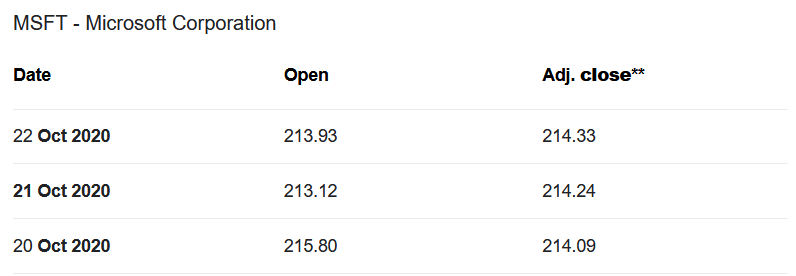

# MICROSOFT IS GOOD FOR FOR A SHORT TERM INVESTMENT ON 21 OCTOBER 2020

<image src ='https://miro.medium.com/max/2800/1*I3Idhtqj9MOIQx2fnPjUyA.gif'>

# **8. RETURN ON INVESTMENT**



IF WE INVESTED 1 MILLION ON IBM and MSFT STOCKS ON 20 OCTOBER 2020

#IBM

In [ ]:
import numpy as np
import pandas as pd
pd.core.common.is_list_like = pd.api.types.is_list_like
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
import pandas_datareader as pdr
import datetime 
from sklearn.preprocessing import MinMaxScaler
% matplotlib inline

In [ ]:
data1 = pdr.get_data_yahoo('IBM',start='2020-10-20')

#Imputation

In [ ]:
dt = datetime.date(2020, 10, 21)
end = datetime.date(2020, 12,3)
day=pd.date_range(start=dt,end=end,freq='D')
temp=pd.DataFrame(day,columns=['Date'])

In [ ]:
temp=temp.set_index('Date',drop=True)

In [ ]:
data1=pd.concat([data1,temp],axis=1)

In [ ]:
data1=data1.ffill()
data1=data1.bfill()
data1=data1.loc[:,['Adj Close']]

#Analysis

RETURN ON INVESTMENT


$ Monthly\enspace Returns=((\frac{Ending\enspace Balance-Net\enspace Deposits}{Starting\enspace Balance})* 100)$       

 Source:[blog](https://https://www.fool.com/knowledge-center/how-to-calculate-a-monthly-return-on-investment/)

## Data Gathering 

In [ ]:
pm1=data1
pm1=pm1.pct_change()[1:]

In [ ]:
pm1 # viewing the data 

## Individual stock monthly return 

## Cumulative Monthly returns 

In [ ]:
#porfolio return
por_ret = pm1.sum(axis=1)
# axis =1 the rows
por_ret

Date
2020-10-21   -0.019681
2020-10-22    0.006084
2020-10-23    0.002073
2020-10-24    0.000000
2020-10-25    0.000000
2020-10-26   -0.032586
2020-10-27   -0.014792
2020-10-28   -0.035365
2020-10-29    0.021191
2020-10-30    0.025250
2020-10-31    0.000000
2020-11-01    0.000000
2020-11-02    0.011195
2020-11-03    0.011071
2020-11-04   -0.019797
2020-11-05    0.025648
2020-11-06   -0.006361
2020-11-07    0.000000
2020-11-08    0.000000
2020-11-09    0.027756
2020-11-10    0.020601
2020-11-11   -0.006022
2020-11-12   -0.023038
2020-11-13    0.020524
2020-11-14    0.000000
2020-11-15    0.000000
2020-11-16    0.012923
2020-11-17   -0.005576
2020-11-18   -0.007901
2020-11-19    0.003511
2020-11-20   -0.002048
2020-11-21    0.000000
2020-11-22    0.000000
2020-11-23    0.026937
2020-11-24    0.036056
2020-11-25   -0.001768
2020-11-26    0.000000
2020-11-27    0.001208
2020-11-28    0.000000
2020-11-29    0.000000
2020-11-30   -0.006675
2020-12-01   -0.002914
2020-12-02    0.011854
2020-1

In [ ]:
por_ret=pd.DataFrame(por_ret)

##CUMULATIVE RETURNS 

In [ ]:
#calculate cumulative returns
cumulative_ret = (1+por_ret).cumprod()

In [ ]:
cumulative_ret=pd.DataFrame(cumulative_ret)

In [ ]:
colors = px.colors.qualitative.Plotly
fig = go.Figure() 
fig.add_traces(go.Scatter(name='Cumulative Returns', x=cumulative_ret.index, y = cumulative_ret[0],hovertext=cumulative_ret[0], mode = 'lines', line=dict(color=colors[0])))
fig.update_xaxes(title_text='DATE')
fig.update_yaxes(title_text='CUMULATIVE RETURNS($)IN MILLION')
fig.update_layout(title='IBM Portfolio Cumulative Returns',
                  font=dict(family="Arial, monospace",size=18,color=colors[1]))
fig.show()

#MSFT

In [ ]:
import numpy as np
import pandas as pd
pd.core.common.is_list_like = pd.api.types.is_list_like
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
import pandas_datareader as pdr
import datetime 
from sklearn.preprocessing import MinMaxScaler
% matplotlib inline

In [ ]:
data = pdr.get_data_yahoo('MSFT',start='2020-10-20')

#Imputation

In [ ]:
dt = datetime.date(2020, 10, 21)
end = datetime.date(2020,12,3)
day=pd.date_range(start=dt,end=end,freq='D')
temp=pd.DataFrame(day,columns=['Date'])

In [ ]:
temp=temp.set_index('Date',drop=True)

In [ ]:
data=pd.concat([data,temp],axis=1)

In [ ]:
data=data.ffill()
data=data.bfill()
data=data.loc[:,['Adj Close']]

#Analysis

RETURN ON INVESTMENT


$ Monthly\enspace Returns=((\frac{Ending\enspace Balance-Net\enspace Deposits}{Starting\enspace Balance})* 100)$       

 Source:[blog](https://https://www.fool.com/knowledge-center/how-to-calculate-a-monthly-return-on-investment/)

## Data Gathering 

In [ ]:
pm1=data
pm1=pm1.pct_change()[1:]

In [ ]:
pm1 # viewing the data 

## Individual stock monthly return 

## Cumulative Monthly returns 

In [ ]:
#porfolio return
por_ret = pm1.sum(axis=1)
# axis =1 the rows
por_ret

Date
2020-10-21    0.000699
2020-10-22    0.000419
2020-10-23    0.006236
2020-10-24    0.000000
2020-10-25    0.000000
2020-10-26   -0.028442
2020-10-27    0.015090
2020-10-28   -0.049566
2020-10-29    0.010065
2020-10-30   -0.010991
2020-10-31    0.000000
2020-11-01    0.000000
2020-11-02   -0.000692
2020-11-03    0.020264
2020-11-04    0.048249
2020-11-05    0.031887
2020-11-06    0.001926
2020-11-07    0.000000
2020-11-08    0.000000
2020-11-09   -0.023824
2020-11-10   -0.033793
2020-11-11    0.026255
2020-11-12   -0.005126
2020-11-13    0.004967
2020-11-14    0.000000
2020-11-15    0.000000
2020-11-16    0.003326
2020-11-17   -0.012751
2020-11-18   -0.013184
2020-11-19    0.006348
2020-11-20   -0.009557
2020-11-21    0.000000
2020-11-22    0.000000
2020-11-23   -0.001331
2020-11-24    0.017848
2020-11-25    0.000047
2020-11-26    0.000000
2020-11-27    0.006359
2020-11-28    0.000000
2020-11-29    0.000000
2020-11-30   -0.005390
2020-12-01    0.009997
2020-12-02   -0.003885
2020-1

In [ ]:
por_ret=pd.DataFrame(por_ret)

##CUMULATIVE RETURNS 

In [ ]:
#calculate cumulative returns
cumulative_ret = (1+por_ret).cumprod()

In [ ]:
cumulative_ret=pd.DataFrame(cumulative_ret)

In [ ]:
colors = px.colors.qualitative.Plotly
fig = go.Figure() 
fig.add_traces(go.Scatter(name='Cumulative Returns', x=cumulative_ret.index, y = cumulative_ret[0],hovertext=cumulative_ret[0], mode = 'lines', line=dict(color=colors[0])))
fig.update_xaxes(title_text='DATE')
fig.update_yaxes(title_text='CUMULATIVE RETURNS($)IN MILLION')
fig.update_layout(title='MSFT Portfolio Cumulative Returns',
                  font=dict(family="Arial, monospace",size=18,color=colors[1]))
fig.show()

![alt text](https://mir-s3-cdn-cf.behance.net/project_modules/max_1200/0642e775239417.5e4ba3436decf.gif)